In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import os
import seaborn as sns
from scipy.stats import median_abs_deviation

In [2]:
def plot_props(df):
    row = 0
    col = 0
    
    fig, axes = plt.subplots(3, 4, figsize=(20, 10))
    count = 0
    colors = ['red', 'orange', 'yellow', 'green', 'blue', 'violet', 'pink', 'purple', 'grey', 'brown', 'lime', 'skyblue']
    
    while row < 3:
        for prop in ['B', 'Mn', 'K', 'N', 'P', 'Cu', 'S', 'OC', 'Zn', 'pH', 'EC', 'Fe']:
            print(f"{prop} min and max values :  Min = {df[prop].min()}, Max = {df[prop].max()}")
            
            sns.histplot(df[prop], bins=20, ax=axes[row][col], kde=True, kde_kws=dict(cut=3), color=colors[count], edgecolor="black")
            axes[row][col].set_title(f"Distribution of {prop}")
            axes[row][col].set_xlabel(f'{prop} values')
            axes[row][col].set_ylabel('Count')
            count += 1
            col = (col+1) % 4
    
            if count % 4 == 0 and count > 0:
                row += 1
    
    plt.tight_layout()
    plt.show()

In [19]:
# Function to calculate Modified Z-Score
def modified_z_score(series):
    median = np.median(series)
    mad = median_abs_deviation(series)
    epsilon = 1e-9 if mad == 0 else 0  # Adjust small value if necessary
    mad += epsilon
    # if mad == 0:  # Use standard deviation if MAD is zero
        # std_dev = np.std(series, ddof=1)
        # return (series - median) / std_dev if std_dev > 0 else series * 0
    # print(median, mad)
    return 0.6745 * (series - median) / mad

def apply_z_filter(df):
    df = df[df['OC'] >= 0.0]
    df = df[df['OC'] <= 1.0]
    df = df[df['pH'] >= 1.0]
    df = df[df['pH'] <= 14.0]
    
    threshold = 3.5
    props = ['B', 'Mn', 'Cu', 'S', 'Zn', 'EC', 'Fe', 'N', 'P', 'K']
    for prop in props:
        df = df[df[prop] >= 0]
        # print(np.abs(modified_z_score(df[prop])))
        df = df[np.abs(modified_z_score(df[prop])) <= threshold]
        # print(f"After normalizing {prop} : size of df {len(df)}")
        # plot_props(df)

    return df

Before z-score
B min and max values :  Min = -4.0, Max = 52454.0
Mn min and max values :  Min = -3.83, Max = 87066.0
K min and max values :  Min = 0.0, Max = 78444444.0
N min and max values :  Min = -1267.0, Max = 248354.0
P min and max values :  Min = 0.0, Max = 58354.0
Cu min and max values :  Min = -162.0, Max = 8054.0
S min and max values :  Min = -135.0, Max = 54737.5
OC min and max values :  Min = -10.9, Max = 6264562466.0
Zn min and max values :  Min = -6.0, Max = 10142.0
pH min and max values :  Min = -177.61, Max = 7.777777777777778e+18
EC min and max values :  Min = -168.0, Max = 4163.0
Fe min and max values :  Min = -16.5, Max = 70430.0


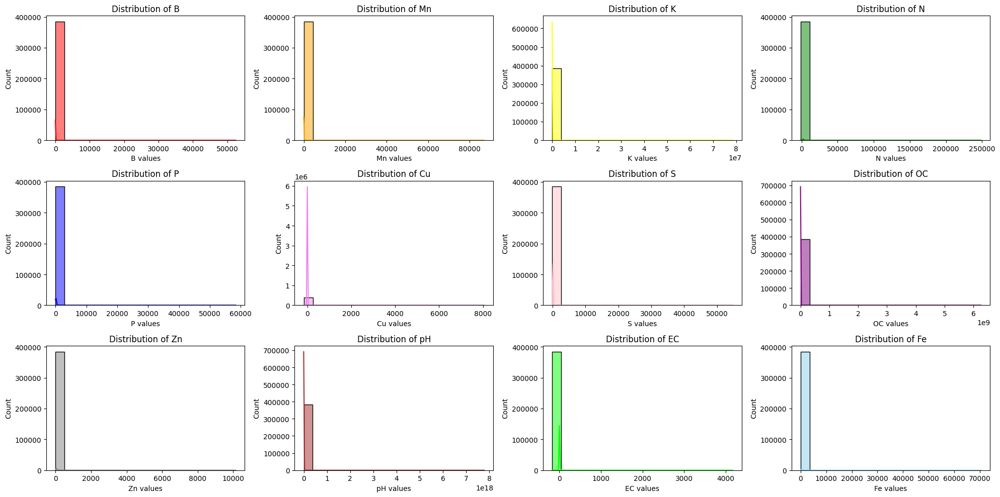

/tmp/ipykernel_19888/1435975282.py:30: FutureWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  df = df.groupby("district", group_keys=False).apply(apply_z_filter)


After z-score
B min and max values :  Min = 0.0, Max = 5.4
Mn min and max values :  Min = 0.0, Max = 139.1
K min and max values :  Min = 0.0, Max = 1232.0
N min and max values :  Min = 0.0, Max = 713.75
P min and max values :  Min = 0.0, Max = 96.85
Cu min and max values :  Min = 0.0, Max = 8.494
S min and max values :  Min = 0.0, Max = 174.3
OC min and max values :  Min = 0.0, Max = 1.0
Zn min and max values :  Min = 0.0, Max = 4.744
pH min and max values :  Min = 1.0, Max = 14.0
EC min and max values :  Min = 0.0, Max = 3.0
Fe min and max values :  Min = 0.0, Max = 53.3


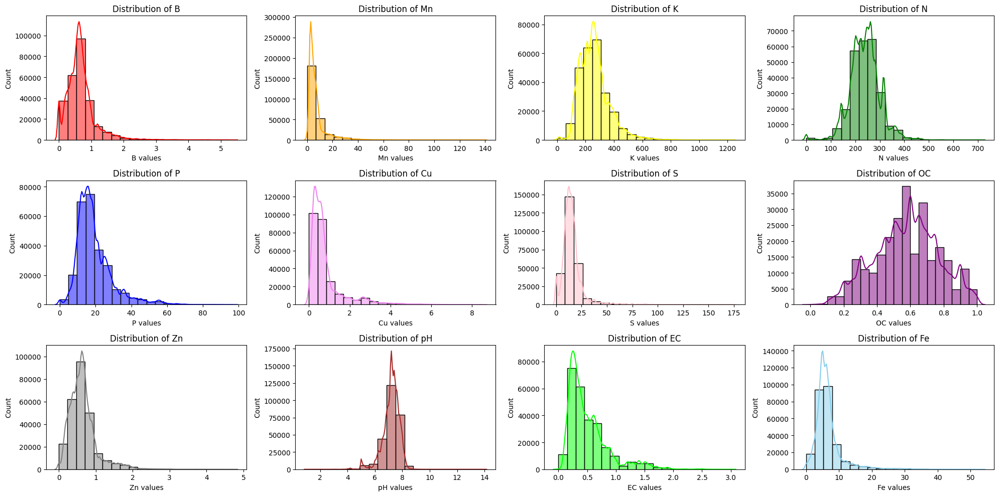

Total districts : 54
MADHYA PRADESH_2024.csv:: No. of samples reduced from 384493 to 264568
Before z-score
B min and max values :  Min = 0.0, Max = 539.0
Mn min and max values :  Min = 0.0, Max = 30798.0
K min and max values :  Min = 0.0, Max = 29991.2
N min and max values :  Min = -363.8, Max = 100352.0
P min and max values :  Min = 0.0, Max = 20992.0
Cu min and max values :  Min = -1.0, Max = 722.0
S min and max values :  Min = -2.0, Max = 439.0
OC min and max values :  Min = 0.0, Max = 461.4
Zn min and max values :  Min = -1.0, Max = 2414.0
pH min and max values :  Min = -17.14, Max = 6023.0
EC min and max values :  Min = 0.0, Max = 675.0
Fe min and max values :  Min = -1.0, Max = 2013.0


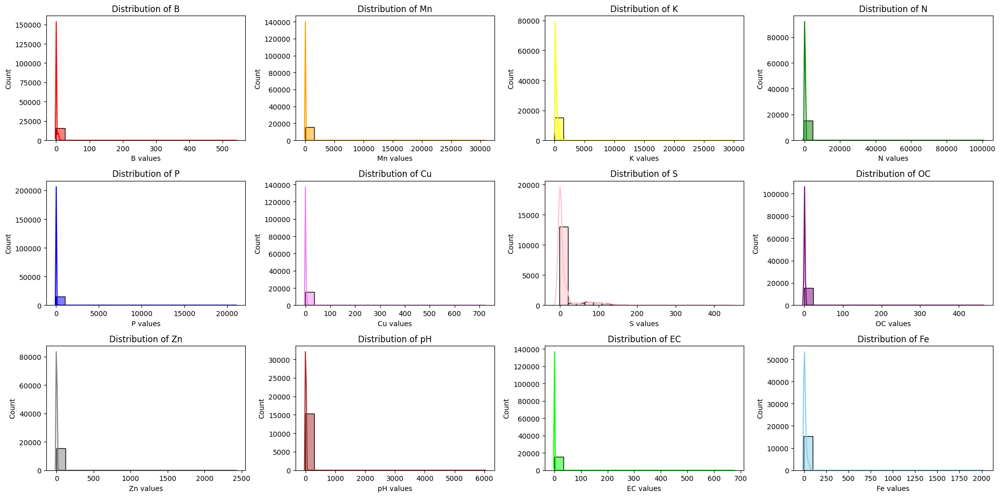

/tmp/ipykernel_19888/1435975282.py:30: FutureWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  df = df.groupby("district", group_keys=False).apply(apply_z_filter)


After z-score
B min and max values :  Min = 0.0, Max = 13.8
Mn min and max values :  Min = 0.0, Max = 22.9
K min and max values :  Min = 0.67, Max = 886.0
N min and max values :  Min = 0.0, Max = 715.0
P min and max values :  Min = 2.0, Max = 129.0
Cu min and max values :  Min = 0.0, Max = 4.52
S min and max values :  Min = 0.0, Max = 200.6
OC min and max values :  Min = 0.0, Max = 1.0
Zn min and max values :  Min = 0.0, Max = 10.15
pH min and max values :  Min = 3.9, Max = 8.34
EC min and max values :  Min = 0.0, Max = 0.985
Fe min and max values :  Min = 0.0, Max = 60.5


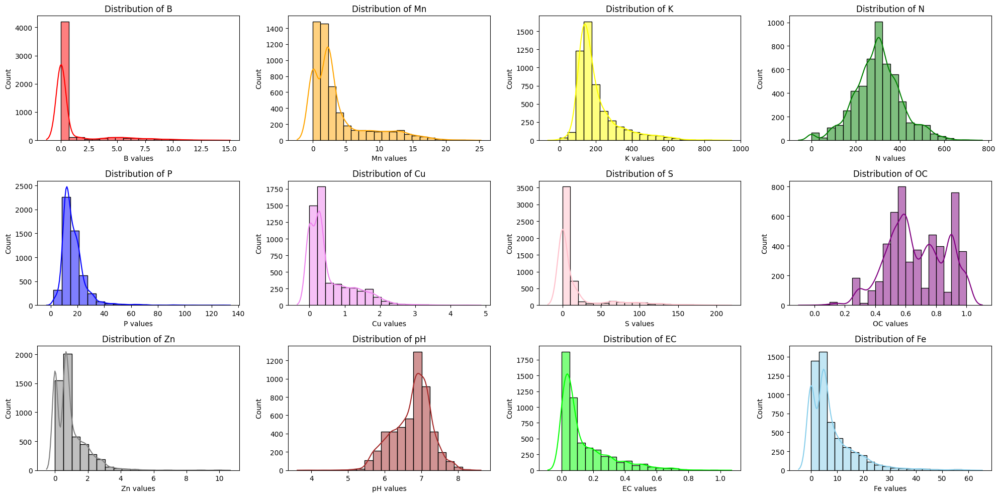

Total districts : 12
HIMACHAL PRADESH_2024.csv:: No. of samples reduced from 15344 to 5199
Before z-score
B min and max values :  Min = -6.473, Max = 4029.0
Mn min and max values :  Min = -0.88, Max = 43430.0
K min and max values :  Min = 0.0, Max = 2320644.0
N min and max values :  Min = -288.0, Max = 2380600.0
P min and max values :  Min = -7.63, Max = 290346.0
Cu min and max values :  Min = -5.0, Max = 4542.0
S min and max values :  Min = -0.516, Max = 43398.0
OC min and max values :  Min = -21.91, Max = 2928.0
Zn min and max values :  Min = -2.0, Max = 43722.0
pH min and max values :  Min = -27.23, Max = 7346.0
EC min and max values :  Min = -4.89, Max = 4880.0
Fe min and max values :  Min = -13.1, Max = 173762.0


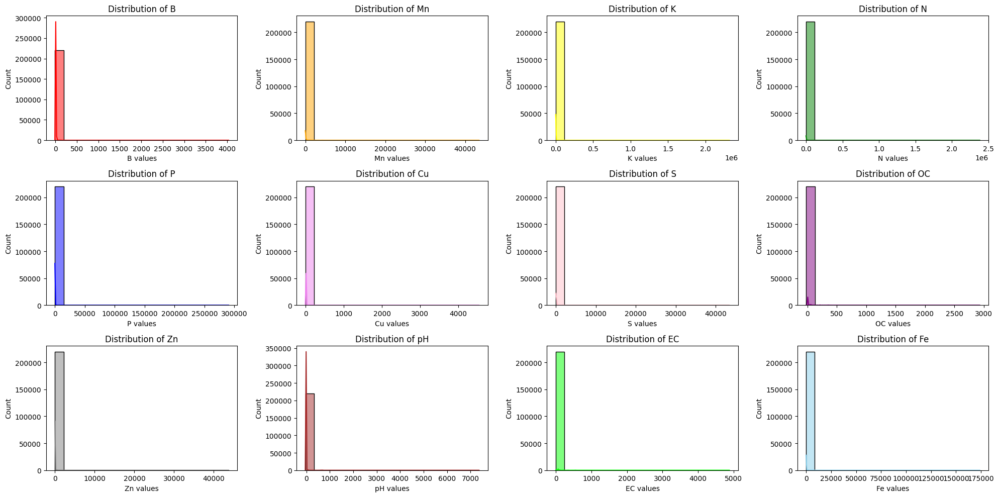

/tmp/ipykernel_19888/1435975282.py:30: FutureWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  df = df.groupby("district", group_keys=False).apply(apply_z_filter)


After z-score
B min and max values :  Min = 0.0, Max = 36.0
Mn min and max values :  Min = 0.0, Max = 100.3
K min and max values :  Min = 0.0, Max = 1005.6
N min and max values :  Min = 0.0, Max = 715.008
P min and max values :  Min = 0.0, Max = 63.0
Cu min and max values :  Min = 0.0, Max = 6.667
S min and max values :  Min = 0.0, Max = 88.54
OC min and max values :  Min = 0.0, Max = 1.0
Zn min and max values :  Min = 0.0, Max = 6.186
pH min and max values :  Min = 1.02, Max = 11.38
EC min and max values :  Min = 0.0, Max = 1.38
Fe min and max values :  Min = 0.0, Max = 103.74


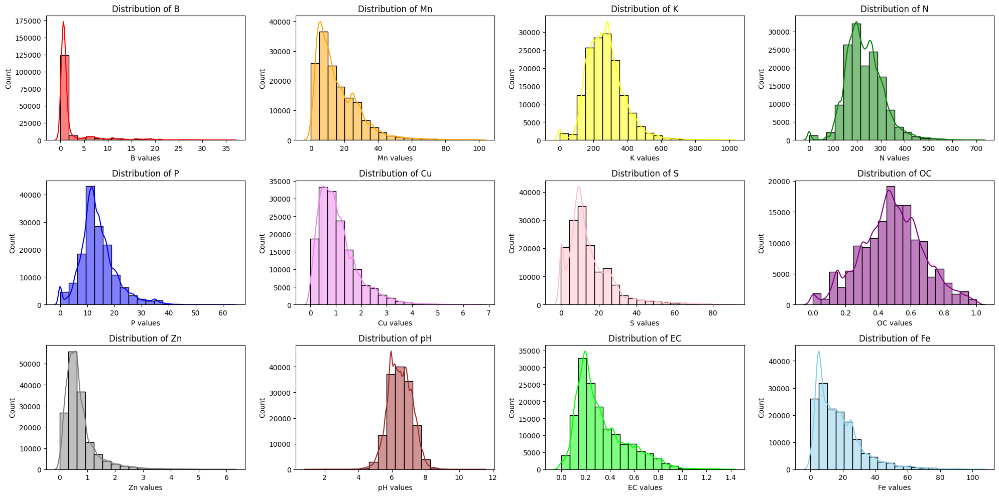

Total districts : 33
CHHATTISGARH_2024.csv:: No. of samples reduced from 219911 to 150105
DADRA & NAGAR HAVELI AND DAMAN & DIU_2024.csv does not contain any records
Before z-score
B min and max values :  Min = -3.02, Max = 1362.0
Mn min and max values :  Min = -2.3, Max = 9022.0
K min and max values :  Min = 0.0, Max = 834062.0
N min and max values :  Min = -239.5904, Max = 514356.0
P min and max values :  Min = -119.46, Max = 193381.0
Cu min and max values :  Min = -10.08, Max = 4564.0
S min and max values :  Min = -12.4131, Max = 76309.0
OC min and max values :  Min = -421.932, Max = 83638.0
Zn min and max values :  Min = -3.0, Max = 2026.0
pH min and max values :  Min = -37.9, Max = 8049.0
EC min and max values :  Min = -10.67, Max = 2388.0
Fe min and max values :  Min = -24.14, Max = 36711.0


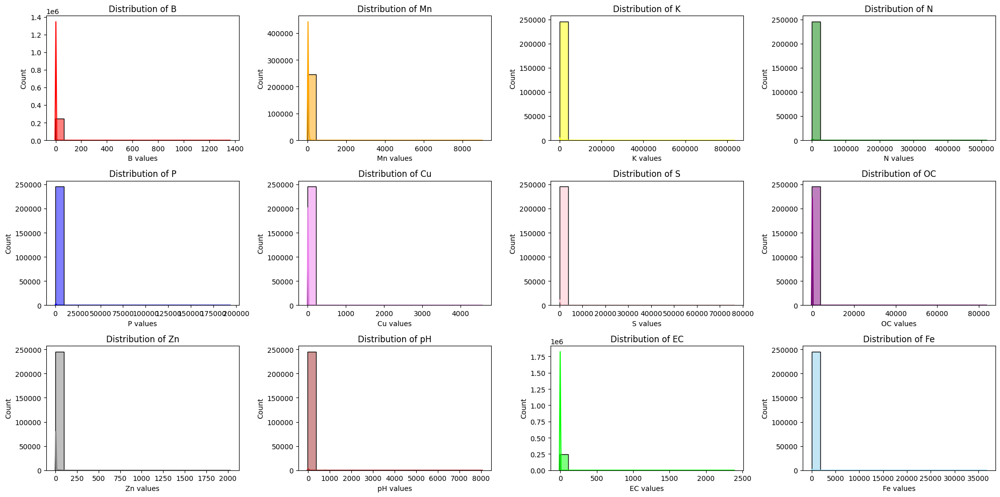

/tmp/ipykernel_19888/1435975282.py:30: FutureWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  df = df.groupby("district", group_keys=False).apply(apply_z_filter)


After z-score
B min and max values :  Min = 0.0, Max = 8.4
Mn min and max values :  Min = 0.0, Max = 165.25
K min and max values :  Min = 0.0, Max = 2969.12
N min and max values :  Min = 0.0, Max = 1593.88
P min and max values :  Min = 0.0, Max = 389.87
Cu min and max values :  Min = 0.0, Max = 14.36
S min and max values :  Min = 0.0, Max = 154.01175
OC min and max values :  Min = 0.0, Max = 1.0
Zn min and max values :  Min = 0.0, Max = 9.78
pH min and max values :  Min = 1.0, Max = 10.0
EC min and max values :  Min = 0.0, Max = 1.29
Fe min and max values :  Min = 0.0, Max = 79.4


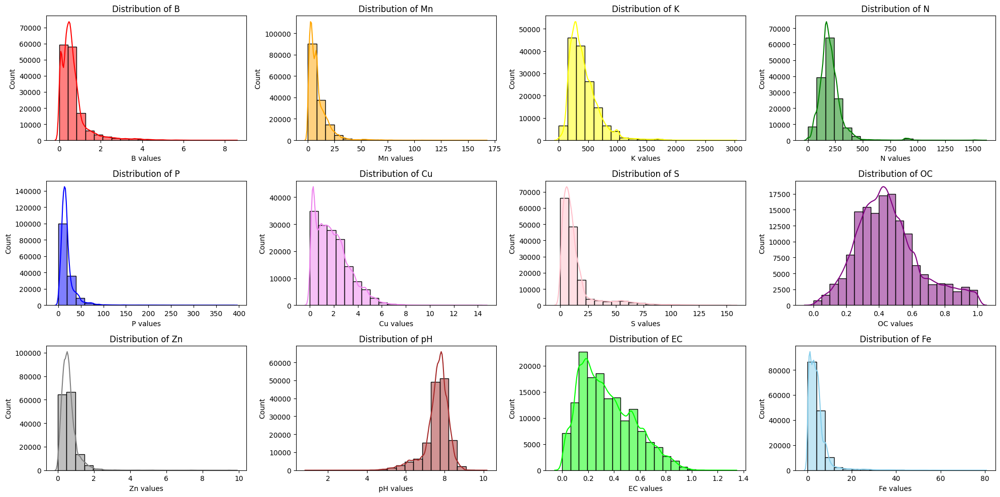

Total districts : 34
MAHARASHTRA_2024.csv:: No. of samples reduced from 245235 to 150375
KERALA_2024.csv does not contain any records
Before z-score
B min and max values :  Min = -3.0, Max = 1230.0
Mn min and max values :  Min = -0.4, Max = 17473.0
K min and max values :  Min = -0.790159328661596, Max = 595830.0
N min and max values :  Min = -10.0, Max = 17085.0
P min and max values :  Min = -0.334072024013103, Max = 32045.0
Cu min and max values :  Min = -8.0, Max = 10187.0
S min and max values :  Min = -1100.15, Max = 1355779452.0
OC min and max values :  Min = -15.0, Max = 951.0
Zn min and max values :  Min = -2.0, Max = 23370.0
pH min and max values :  Min = -37.67, Max = 8960.0
EC min and max values :  Min = -1.601, Max = 962.0
Fe min and max values :  Min = -1.29, Max = 102448.0


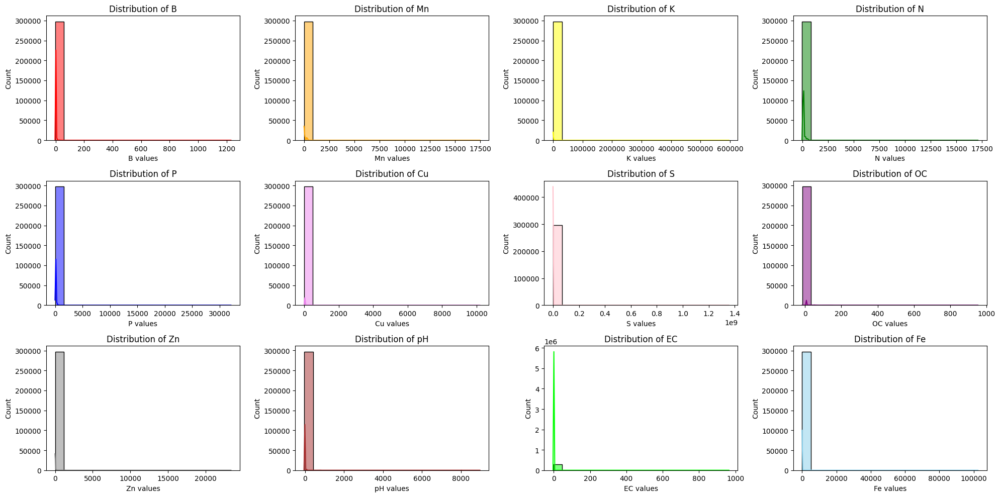

/tmp/ipykernel_19888/1435975282.py:30: FutureWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  df = df.groupby("district", group_keys=False).apply(apply_z_filter)


After z-score
B min and max values :  Min = 0.0, Max = 2.208
Mn min and max values :  Min = 0.0, Max = 57.15931486677019
K min and max values :  Min = 0.0, Max = 975.2
N min and max values :  Min = 0.0, Max = 255.0
P min and max values :  Min = 0.0, Max = 127.56992147257512
Cu min and max values :  Min = 0.0, Max = 5.2
S min and max values :  Min = 0.0, Max = 210.0
OC min and max values :  Min = 0.0, Max = 1.0
Zn min and max values :  Min = 0.0, Max = 6.551753923198453
pH min and max values :  Min = 1.03, Max = 9.95
EC min and max values :  Min = 0.0, Max = 3.16
Fe min and max values :  Min = 0.0, Max = 66.44949145412123


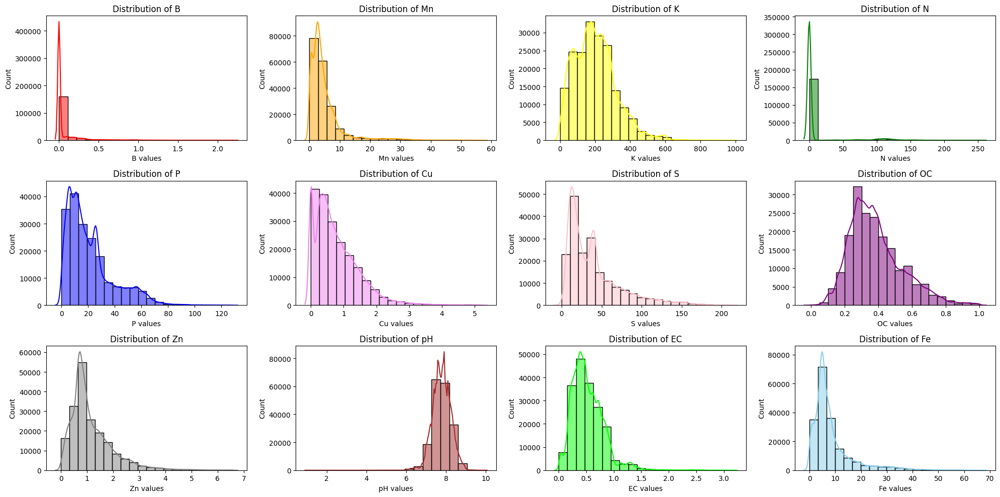

Total districts : 22
HARYANA_2024.csv:: No. of samples reduced from 297166 to 187806
Before z-score
B min and max values :  Min = -4.87, Max = 24061.0
Mn min and max values :  Min = -39.22, Max = 80216.0
K min and max values :  Min = -402.0, Max = 1222222624.27
N min and max values :  Min = -175.62, Max = 288951.0
P min and max values :  Min = -120.0, Max = 28086.0
Cu min and max values :  Min = -4.0, Max = 93286.0
S min and max values :  Min = -20.0, Max = 12521.0
OC min and max values :  Min = -2.0, Max = 1624.0
Zn min and max values :  Min = -2.0, Max = 30018.0
pH min and max values :  Min = -38.1, Max = 8392.0
EC min and max values :  Min = -1.0, Max = 180000.0
Fe min and max values :  Min = -2.168, Max = 80921.0


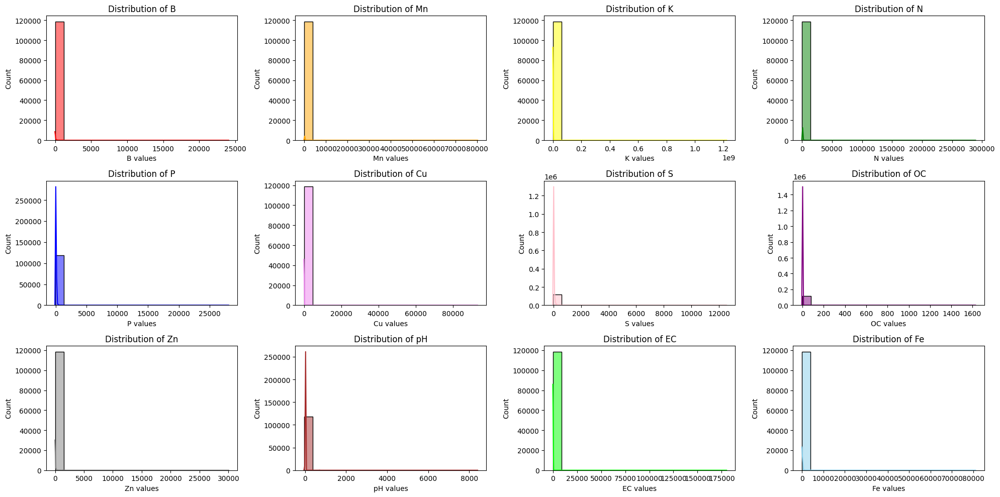

/tmp/ipykernel_19888/1435975282.py:30: FutureWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  df = df.groupby("district", group_keys=False).apply(apply_z_filter)


After z-score
B min and max values :  Min = 0.0, Max = 25.0
Mn min and max values :  Min = 0.0, Max = 114.7
K min and max values :  Min = 0.0, Max = 1579.0
N min and max values :  Min = 0.0, Max = 796.0
P min and max values :  Min = 0.0, Max = 171.0
Cu min and max values :  Min = 0.0, Max = 17.8
S min and max values :  Min = 0.0, Max = 323.2
OC min and max values :  Min = 0.0, Max = 1.0
Zn min and max values :  Min = 0.0, Max = 8.62
pH min and max values :  Min = 1.08, Max = 10.54
EC min and max values :  Min = 0.0, Max = 2.0
Fe min and max values :  Min = 0.0, Max = 122.0


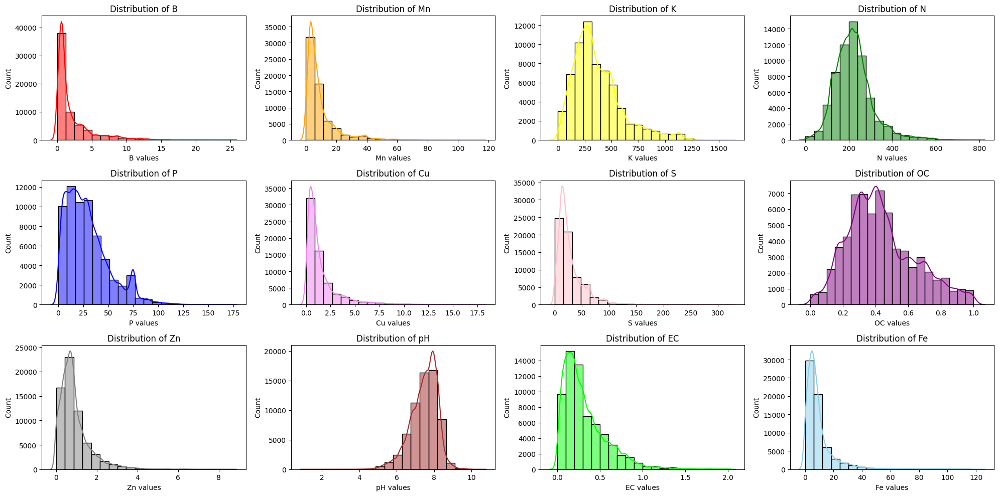

Total districts : 26
ANDHRA PRADESH_2024.csv:: No. of samples reduced from 118583 to 64146
Before z-score
B min and max values :  Min = 0.0, Max = 2342.0
Mn min and max values :  Min = 0.0, Max = 9992.0
K min and max values :  Min = -74.6, Max = 321044.0
N min and max values :  Min = -2.0, Max = 760.0
P min and max values :  Min = 0.0, Max = 180163.0
Cu min and max values :  Min = -2.0, Max = 1986.0
S min and max values :  Min = -117.09, Max = 18079.0
OC min and max values :  Min = 0.0, Max = 1056.0
Zn min and max values :  Min = 0.0, Max = 40832.0
pH min and max values :  Min = -36.7, Max = 7777.08
EC min and max values :  Min = -1.83, Max = 4333.0
Fe min and max values :  Min = -17.52, Max = 37078.0


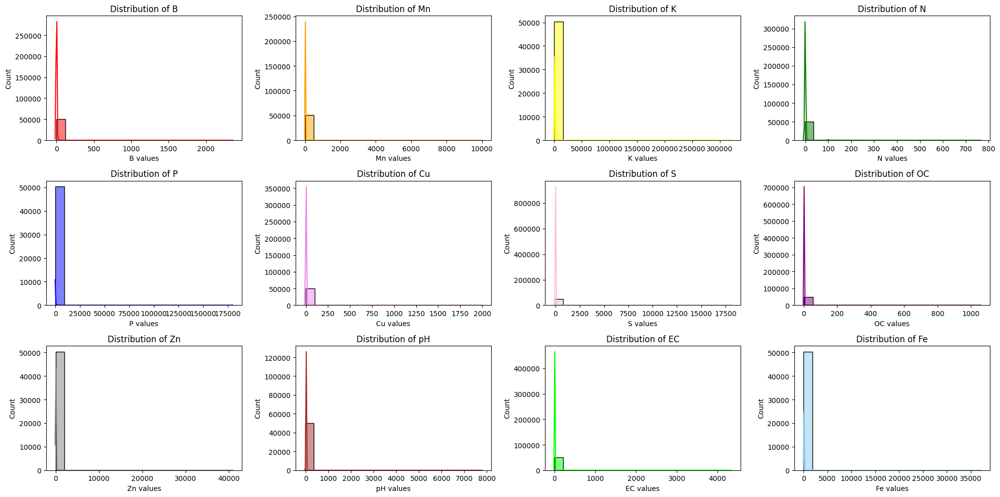

/tmp/ipykernel_19888/1435975282.py:30: FutureWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  df = df.groupby("district", group_keys=False).apply(apply_z_filter)


After z-score
B min and max values :  Min = 0.0, Max = 3.58
Mn min and max values :  Min = 0.0, Max = 28.86
K min and max values :  Min = 0.17, Max = 996.8
N min and max values :  Min = 0.0, Max = 0.0
P min and max values :  Min = 0.0, Max = 113.65
Cu min and max values :  Min = 0.0, Max = 7.36
S min and max values :  Min = 0.0, Max = 45.1
OC min and max values :  Min = 0.0, Max = 1.0
Zn min and max values :  Min = 0.0, Max = 12.63
pH min and max values :  Min = 3.0, Max = 9.8
EC min and max values :  Min = 0.0, Max = 1.85
Fe min and max values :  Min = 0.0, Max = 97.68


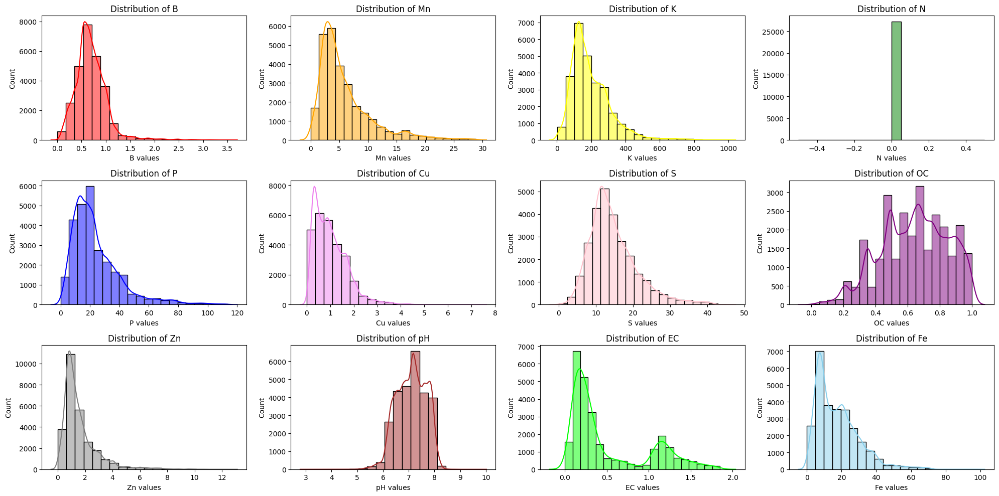

Total districts : 13
UTTARAKHAND_2024.csv:: No. of samples reduced from 50316 to 27202
Before z-score
B min and max values :  Min = -2.0, Max = 1276.0
Mn min and max values :  Min = 0.01, Max = 11957.0
K min and max values :  Min = 0.268, Max = 37017.0
N min and max values :  Min = 0.186, Max = 16077.88
P min and max values :  Min = 0.0, Max = 20591.0
Cu min and max values :  Min = -2.0, Max = 184.0
S min and max values :  Min = 0.0, Max = 9364.0
OC min and max values :  Min = -3.0, Max = 375.0
Zn min and max values :  Min = -2.0, Max = 1013.0
pH min and max values :  Min = -827.76, Max = 865.0
EC min and max values :  Min = -1.0, Max = 1021.0
Fe min and max values :  Min = 0.0, Max = 6342.0


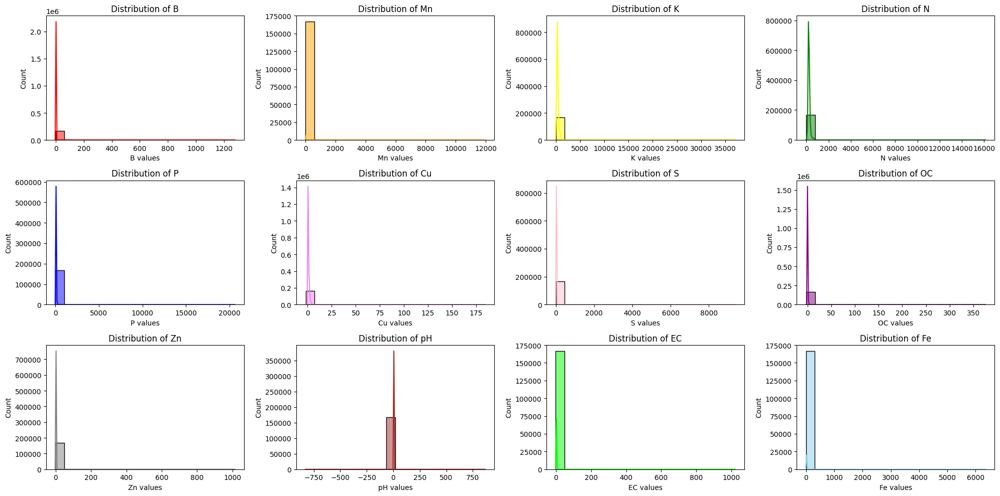

/tmp/ipykernel_19888/1435975282.py:30: FutureWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  df = df.groupby("district", group_keys=False).apply(apply_z_filter)


After z-score
B min and max values :  Min = 0.0, Max = 7.82
Mn min and max values :  Min = 0.01, Max = 27.69
K min and max values :  Min = 0.344, Max = 1733.77
N min and max values :  Min = 0.186, Max = 732.0
P min and max values :  Min = 0.39, Max = 323.97
Cu min and max values :  Min = 0.0, Max = 6.06
S min and max values :  Min = 0.0, Max = 116.32
OC min and max values :  Min = 0.0, Max = 1.0
Zn min and max values :  Min = 0.0, Max = 5.1
pH min and max values :  Min = 1.53, Max = 9.97
EC min and max values :  Min = 0.0, Max = 3.32
Fe min and max values :  Min = 0.0, Max = 27.6


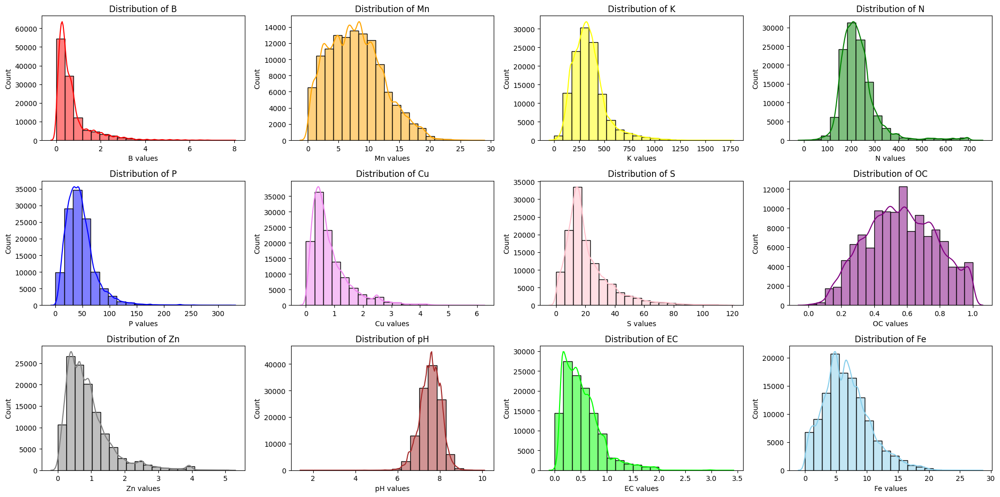

Total districts : 32
GUJARAT_2024.csv:: No. of samples reduced from 166745 to 120591
Before z-score
B min and max values :  Min = 0.0, Max = 1.3
Mn min and max values :  Min = 0.0, Max = 5.6
K min and max values :  Min = 19.0, Max = 121.0
N min and max values :  Min = 26.0, Max = 125.0
P min and max values :  Min = 6.0, Max = 51.0
Cu min and max values :  Min = 0.0, Max = 1.2
S min and max values :  Min = 0.0, Max = 50.0
OC min and max values :  Min = 0.0, Max = 0.6
Zn min and max values :  Min = 0.0, Max = 0.8
pH min and max values :  Min = 6.4, Max = 8.3
EC min and max values :  Min = 0.01, Max = 6.7
Fe min and max values :  Min = 0.0, Max = 6.5


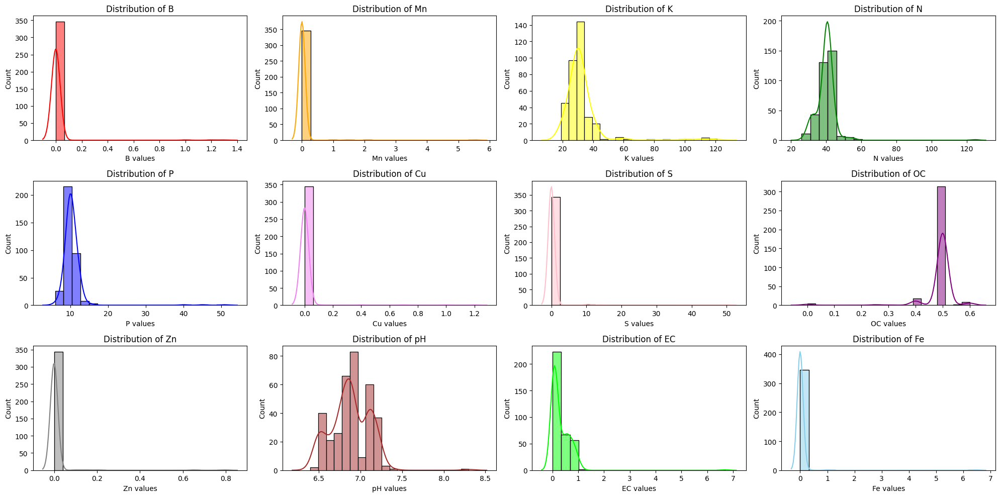

/tmp/ipykernel_19888/1435975282.py:30: FutureWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  df = df.groupby("district", group_keys=False).apply(apply_z_filter)


After z-score
B min and max values :  Min = 0.0, Max = 1.0
Mn min and max values :  Min = 0.0, Max = 5.6
K min and max values :  Min = 20.0, Max = 112.0
N min and max values :  Min = 33.0, Max = 125.0
P min and max values :  Min = 10.0, Max = 45.0
Cu min and max values :  Min = 0.0, Max = 0.7
S min and max values :  Min = 0.0, Max = 50.0
OC min and max values :  Min = 0.0, Max = 0.6
Zn min and max values :  Min = 0.0, Max = 0.8
pH min and max values :  Min = 6.4, Max = 8.3
EC min and max values :  Min = 0.01, Max = 0.5
Fe min and max values :  Min = 0.0, Max = 6.5


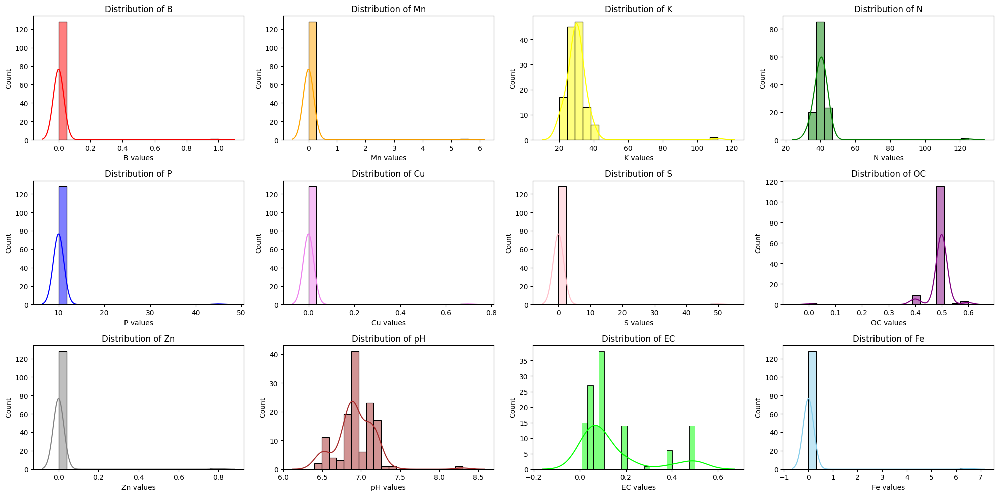

Total districts : 2
TELANGANA_2024.csv:: No. of samples reduced from 349 to 129
Before z-score
B min and max values :  Min = 0.0, Max = 38.0
Mn min and max values :  Min = 0.0, Max = 11562.0
K min and max values :  Min = 0.0, Max = 2601.0
N min and max values :  Min = 0.0, Max = 5777.0
P min and max values :  Min = 0.0, Max = 2118.1
Cu min and max values :  Min = -2.0, Max = 8204.0
S min and max values :  Min = 0.0, Max = 1912.5
OC min and max values :  Min = 0.0, Max = 577.0
Zn min and max values :  Min = -1.0, Max = 3238.0
pH min and max values :  Min = 0.0, Max = 401.0
EC min and max values :  Min = 0.0, Max = 914.0
Fe min and max values :  Min = 0.0, Max = 89992.0


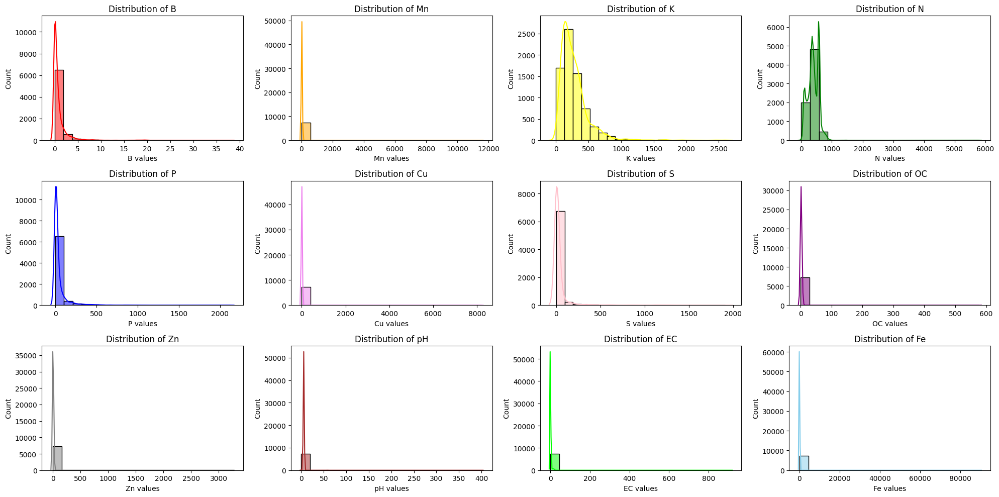

/tmp/ipykernel_19888/1435975282.py:30: FutureWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  df = df.groupby("district", group_keys=False).apply(apply_z_filter)


After z-score
B min and max values :  Min = 0.0, Max = 3.624
Mn min and max values :  Min = 0.0, Max = 62.86
K min and max values :  Min = 1.79, Max = 682.0
N min and max values :  Min = 95.0, Max = 375.0
P min and max values :  Min = 0.0, Max = 128.1
Cu min and max values :  Min = 0.0, Max = 6.818
S min and max values :  Min = 0.0, Max = 60.0
OC min and max values :  Min = 0.007, Max = 1.0
Zn min and max values :  Min = 0.0, Max = 4.564
pH min and max values :  Min = 3.23, Max = 7.8
EC min and max values :  Min = 0.007, Max = 0.614
Fe min and max values :  Min = 0.0, Max = 68.18


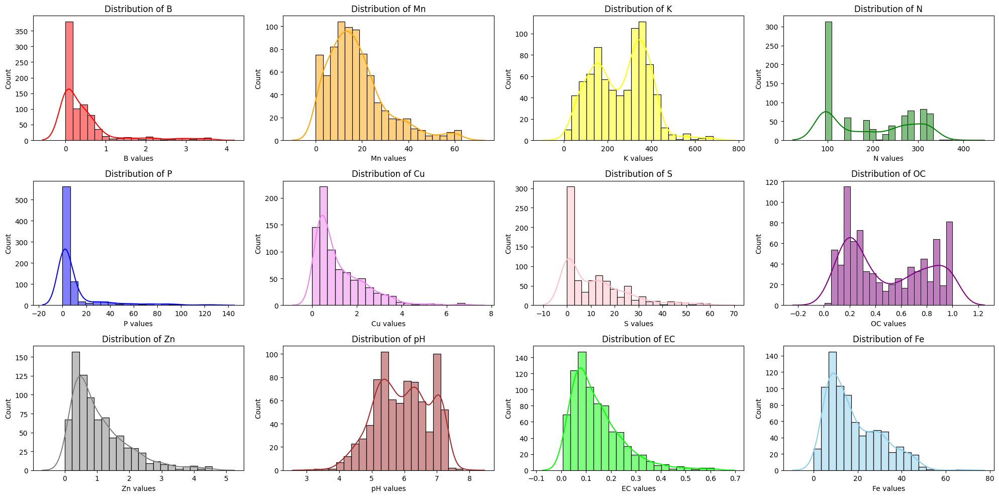

Total districts : 2
GOA_2024.csv:: No. of samples reduced from 7307 to 810
Before z-score
B min and max values :  Min = -4.0, Max = 376.0
Mn min and max values :  Min = 0.0, Max = 8098.0
K min and max values :  Min = -1461.0, Max = 28012.0
N min and max values :  Min = -14.0, Max = 21824.0
P min and max values :  Min = 0.0, Max = 3242.75
Cu min and max values :  Min = -14.0, Max = 984.0
S min and max values :  Min = -2.0, Max = 4605.0
OC min and max values :  Min = -2.0, Max = 1908.0
Zn min and max values :  Min = -3.0, Max = 63034.0
pH min and max values :  Min = -47.8, Max = 8394.0
EC min and max values :  Min = -1.0, Max = 4006.0
Fe min and max values :  Min = -3.42, Max = 93810.0


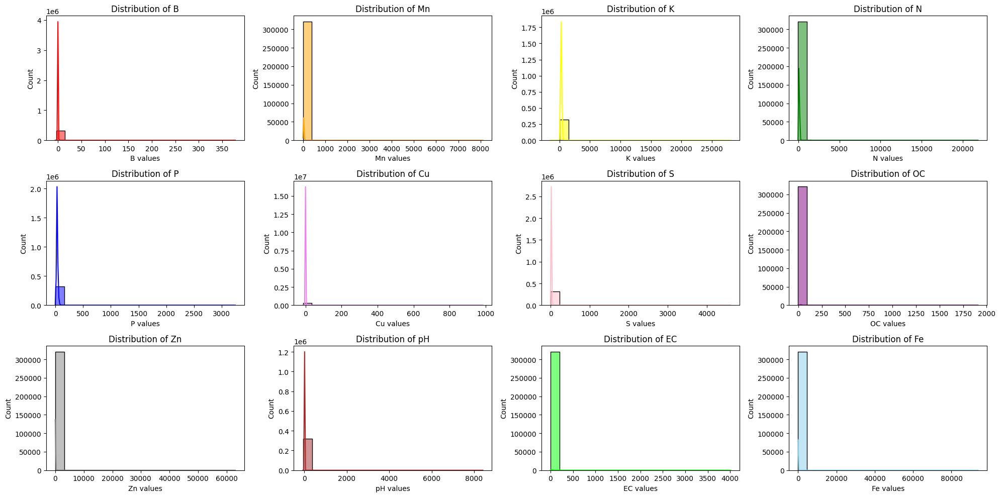

/tmp/ipykernel_19888/1435975282.py:30: FutureWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  df = df.groupby("district", group_keys=False).apply(apply_z_filter)


After z-score
B min and max values :  Min = 0.0, Max = 0.0
Mn min and max values :  Min = 0.0, Max = 46.52
K min and max values :  Min = 0.0, Max = 699.0
N min and max values :  Min = 0.0, Max = 319.2
P min and max values :  Min = 0.0, Max = 114.0
Cu min and max values :  Min = 0.0, Max = 5.66
S min and max values :  Min = 0.0, Max = 71.04
OC min and max values :  Min = 0.0, Max = 1.0
Zn min and max values :  Min = 0.0, Max = 3.046
pH min and max values :  Min = 1.1, Max = 11.02
EC min and max values :  Min = 0.0, Max = 2.5
Fe min and max values :  Min = 0.0, Max = 30.61


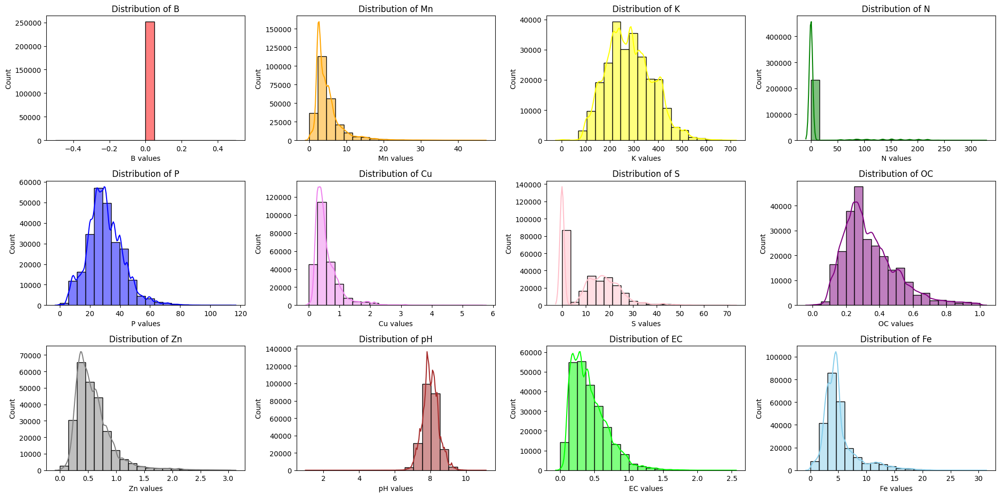

Total districts : 50
RAJASTHAN_2024.csv:: No. of samples reduced from 320872 to 251597
Before z-score
B min and max values :  Min = 0.0, Max = 19621.0
Mn min and max values :  Min = 0.0, Max = 18534.0
K min and max values :  Min = 0.0, Max = 26015.7
N min and max values :  Min = 0.0, Max = 28103.0
P min and max values :  Min = 0.0, Max = 29348.0
Cu min and max values :  Min = 0.0, Max = 9631.0
S min and max values :  Min = 0.0, Max = 24042.0
OC min and max values :  Min = -0.63, Max = 1376.0
Zn min and max values :  Min = 0.0, Max = 14026.0
pH min and max values :  Min = -34.8, Max = 5028.0
EC min and max values :  Min = 0.0, Max = 526.0
Fe min and max values :  Min = 0.0, Max = 486.0


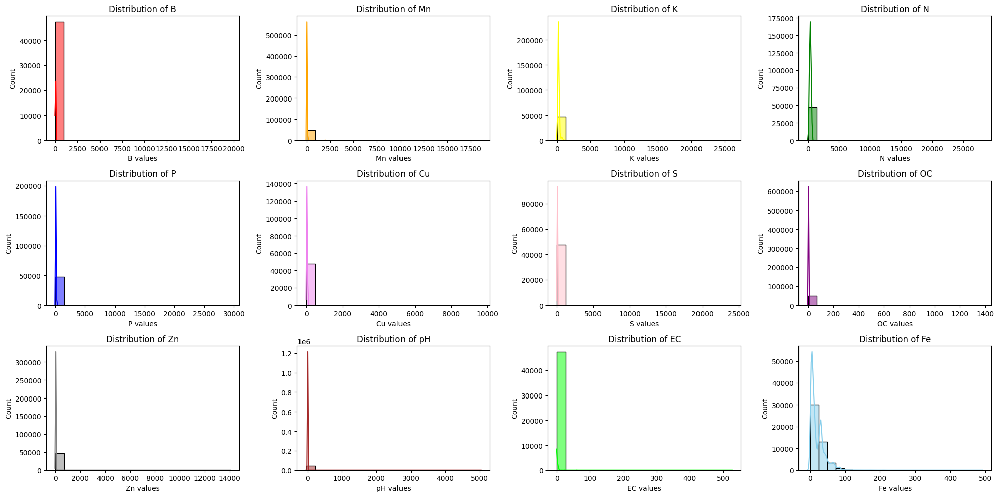

/tmp/ipykernel_19888/1435975282.py:30: FutureWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  df = df.groupby("district", group_keys=False).apply(apply_z_filter)


After z-score
B min and max values :  Min = 0.0, Max = 98.66
Mn min and max values :  Min = 0.0, Max = 160.48
K min and max values :  Min = 1.2, Max = 596.9611166500499
N min and max values :  Min = 0.2105, Max = 990.0
P min and max values :  Min = 0.24, Max = 144.27
Cu min and max values :  Min = 0.0, Max = 129.3
S min and max values :  Min = 0.01, Max = 124.0
OC min and max values :  Min = 0.0, Max = 1.0
Zn min and max values :  Min = 0.0, Max = 39.16
pH min and max values :  Min = 1.5, Max = 8.4
EC min and max values :  Min = 0.0, Max = 1.554
Fe min and max values :  Min = 0.0, Max = 135.6


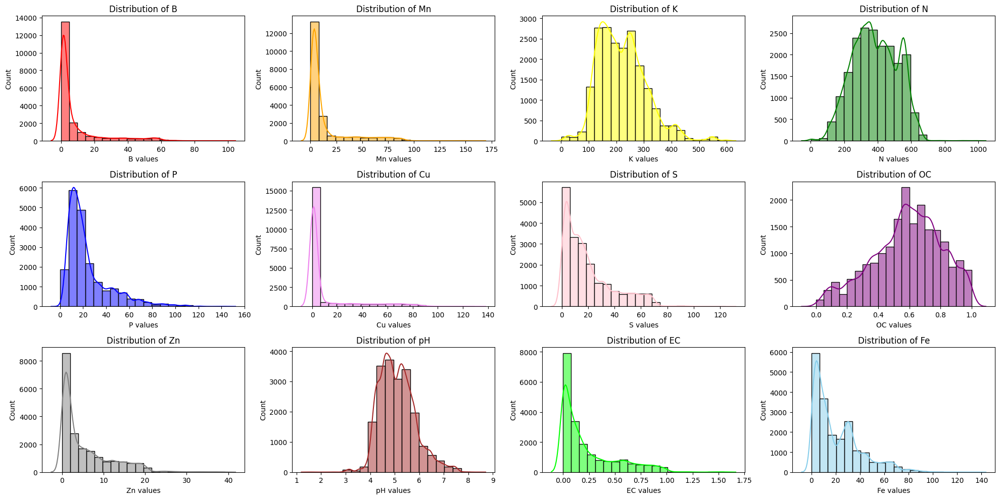

Total districts : 16
NAGALAND_2024.csv:: No. of samples reduced from 47477 to 19781
Before z-score
B min and max values :  Min = -3.0, Max = 86.0
Mn min and max values :  Min = -3.0, Max = 31679.0
K min and max values :  Min = -3.0, Max = 9139296.0
N min and max values :  Min = -5.0, Max = 221760.0
P min and max values :  Min = -42.2912, Max = 185472.0
Cu min and max values :  Min = -40.0, Max = 20283.0
S min and max values :  Min = -3.0, Max = 61747.0
OC min and max values :  Min = -2.0, Max = 960.0
Zn min and max values :  Min = -3.0, Max = 10456.0
pH min and max values :  Min = -17.63, Max = 820.0
EC min and max values :  Min = -2.82, Max = 20047.0
Fe min and max values :  Min = -2.0, Max = 4745.0


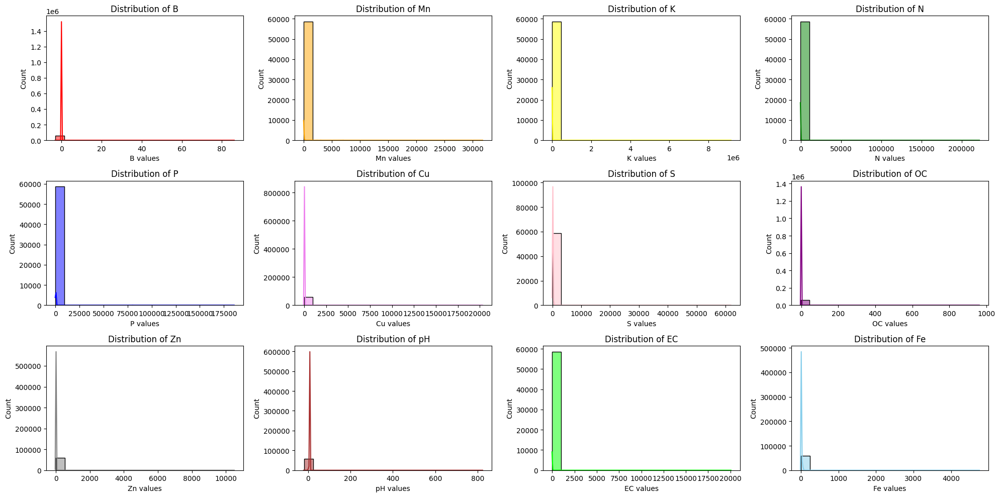

/home/aakash01/Documents/shc/venv/lib/python3.10/site-packages/numpy/_core/fromnumeric.py:3860: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/aakash01/Documents/shc/venv/lib/python3.10/site-packages/numpy/_core/_methods.py:145: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/tmp/ipykernel_19888/1435975282.py:30: FutureWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  df = df.groupby("district", group_keys=False).apply(apply_z_filter)


After z-score
B min and max values :  Min = 0.0, Max = 0.0
Mn min and max values :  Min = 0.0, Max = 36.75
K min and max values :  Min = 0.0, Max = 1589.9054080000003
N min and max values :  Min = 0.0, Max = 2.16
P min and max values :  Min = 0.0, Max = 150.02740480000003
Cu min and max values :  Min = 0.0, Max = 8.0
S min and max values :  Min = 0.0, Max = 211.9
OC min and max values :  Min = 0.0, Max = 1.0
Zn min and max values :  Min = 0.0, Max = 5.927
pH min and max values :  Min = 1.782, Max = 9.9
EC min and max values :  Min = 0.0, Max = 1.46
Fe min and max values :  Min = 0.0, Max = 36.93


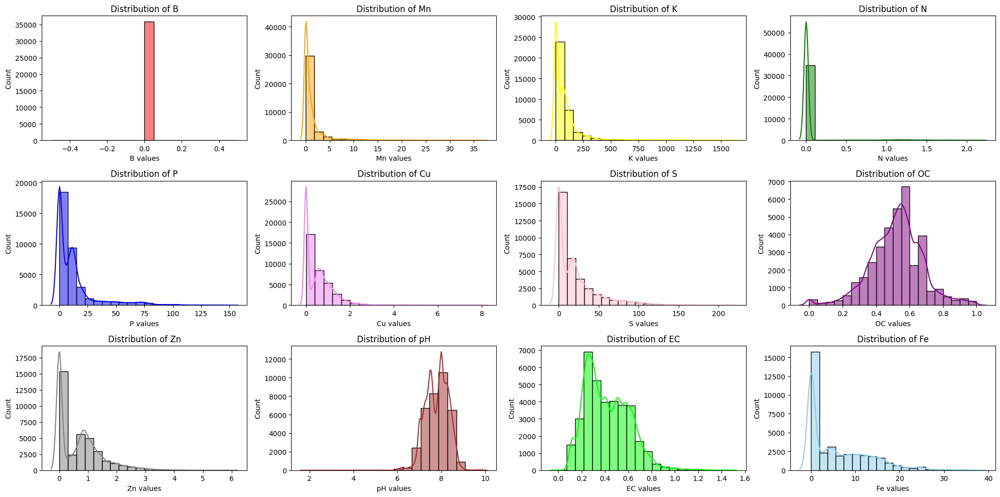

Total districts : 15
PUNJAB_2024.csv:: No. of samples reduced from 58594 to 35890
MANIPUR_2024.csv does not contain any records
Before z-score
B min and max values :  Min = -4.66, Max = 1063.0
Mn min and max values :  Min = -2.1, Max = 18096.0
K min and max values :  Min = 0.0, Max = 748748748.0
N min and max values :  Min = 0.0, Max = 548402.0
P min and max values :  Min = -179.93, Max = 5888888.0
Cu min and max values :  Min = -3.0, Max = 9647487754.0
S min and max values :  Min = -18.15, Max = 65060.0
OC min and max values :  Min = -10.41, Max = 1348.0
Zn min and max values :  Min = -2.0, Max = 99323253520.321
pH min and max values :  Min = -27.45, Max = 9339620310.0
EC min and max values :  Min = -10.62, Max = 1017.0
Fe min and max values :  Min = -115.43, Max = 67345.0


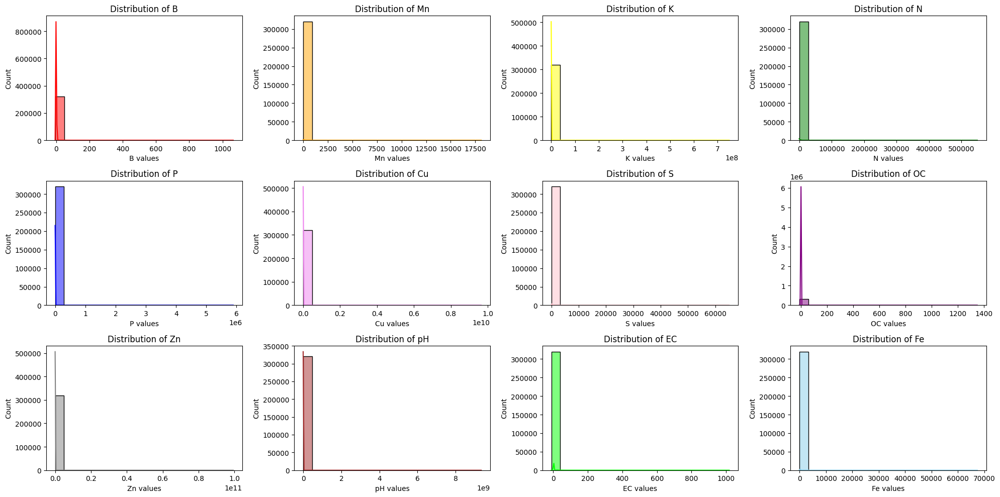

/tmp/ipykernel_19888/1435975282.py:30: FutureWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  df = df.groupby("district", group_keys=False).apply(apply_z_filter)


After z-score
B min and max values :  Min = 0.0, Max = 3.36
Mn min and max values :  Min = 0.0, Max = 43.44
K min and max values :  Min = 0.0, Max = 825.0
N min and max values :  Min = 0.0, Max = 972.0
P min and max values :  Min = 0.0, Max = 248.91
Cu min and max values :  Min = 0.0, Max = 8.48
S min and max values :  Min = 0.0, Max = 106.0
OC min and max values :  Min = 0.0, Max = 1.0
Zn min and max values :  Min = 0.0, Max = 4.12
pH min and max values :  Min = 1.12, Max = 9.97
EC min and max values :  Min = 0.0, Max = 2.04
Fe min and max values :  Min = 0.0, Max = 128.44


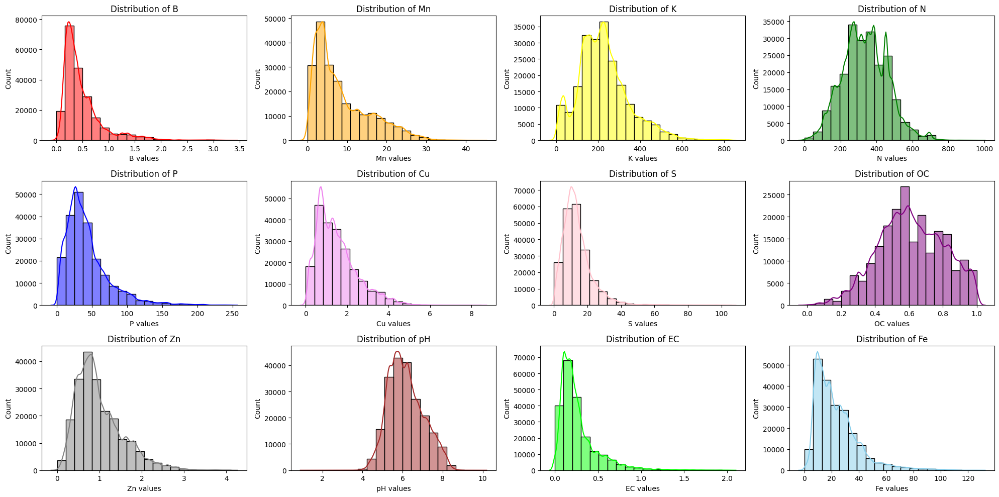

Total districts : 22
WEST BENGAL_2024.csv:: No. of samples reduced from 319864 to 213163
Before z-score
B min and max values :  Min = -20.95, Max = 198.0
Mn min and max values :  Min = 0.0, Max = 547.0
K min and max values :  Min = 0.0, Max = 37904.0
N min and max values :  Min = 0.0, Max = 701.3
P min and max values :  Min = -0.1, Max = 311.9
Cu min and max values :  Min = -2.0, Max = 239.0
S min and max values :  Min = -1.0, Max = 891.0
OC min and max values :  Min = 0.0, Max = 10.29
Zn min and max values :  Min = -3.0, Max = 217.0
pH min and max values :  Min = 0.0, Max = 401.0
EC min and max values :  Min = 0.0, Max = 616.0
Fe min and max values :  Min = -0.01, Max = 410217.0


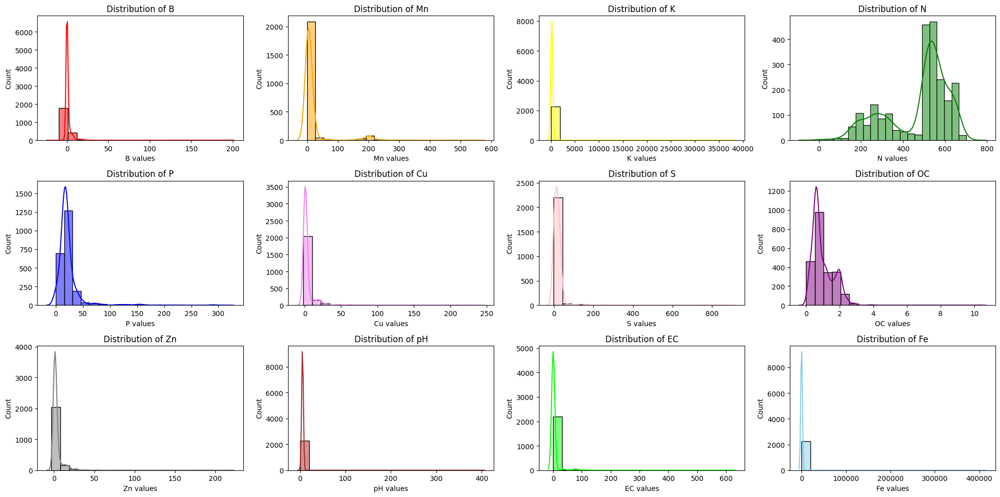

/home/aakash01/Documents/shc/venv/lib/python3.10/site-packages/numpy/_core/fromnumeric.py:3860: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/aakash01/Documents/shc/venv/lib/python3.10/site-packages/numpy/_core/_methods.py:145: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/tmp/ipykernel_19888/1435975282.py:30: FutureWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  df = df.groupby("district", group_keys=False).apply(apply_z_filter)


After z-score
B min and max values :  Min = 0.0, Max = 21.173
Mn min and max values :  Min = 0.01, Max = 246.5
K min and max values :  Min = 0.0, Max = 612.1
N min and max values :  Min = 98.0, Max = 620.0
P min and max values :  Min = 0.0, Max = 56.0
Cu min and max values :  Min = 0.0, Max = 32.0
S min and max values :  Min = 0.0, Max = 45.0
OC min and max values :  Min = 0.0, Max = 1.0
Zn min and max values :  Min = 0.0, Max = 21.03
pH min and max values :  Min = 3.03, Max = 7.1
EC min and max values :  Min = 0.012, Max = 118.2
Fe min and max values :  Min = 0.0, Max = 139.84


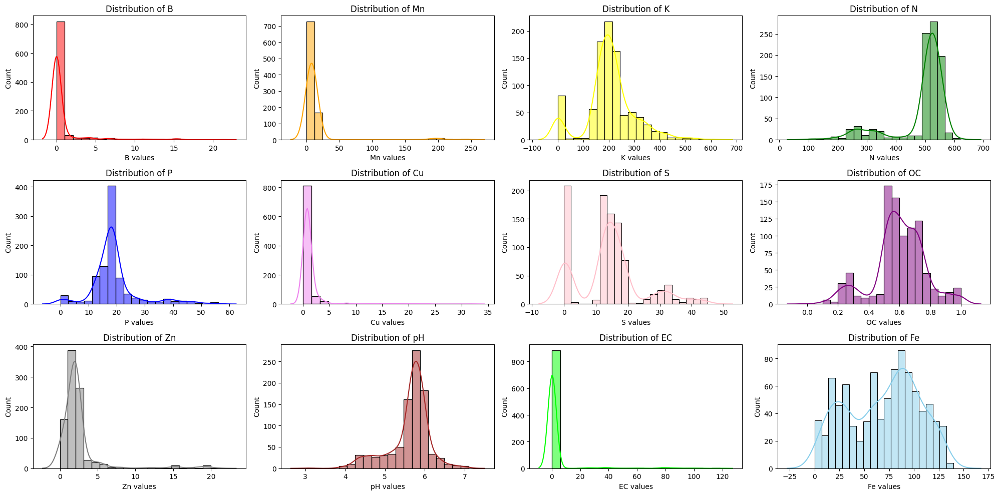

Total districts : 22
ARUNACHAL PRADESH_2024.csv:: No. of samples reduced from 2275 to 916
Before z-score
B min and max values :  Min = -1.22, Max = 174.67
Mn min and max values :  Min = 0.0, Max = 735.0
K min and max values :  Min = 0.0, Max = 21421.0
N min and max values :  Min = 0.0, Max = 341010.0
P min and max values :  Min = 0.0, Max = 4038.0
Cu min and max values :  Min = -4.0, Max = 85.31
S min and max values :  Min = -118.0, Max = 345.58
OC min and max values :  Min = 0.0, Max = 860.0
Zn min and max values :  Min = 0.0, Max = 574.0
pH min and max values :  Min = -24.6, Max = 552.0
EC min and max values :  Min = 0.0, Max = 82.0
Fe min and max values :  Min = -227.82, Max = 2791.0


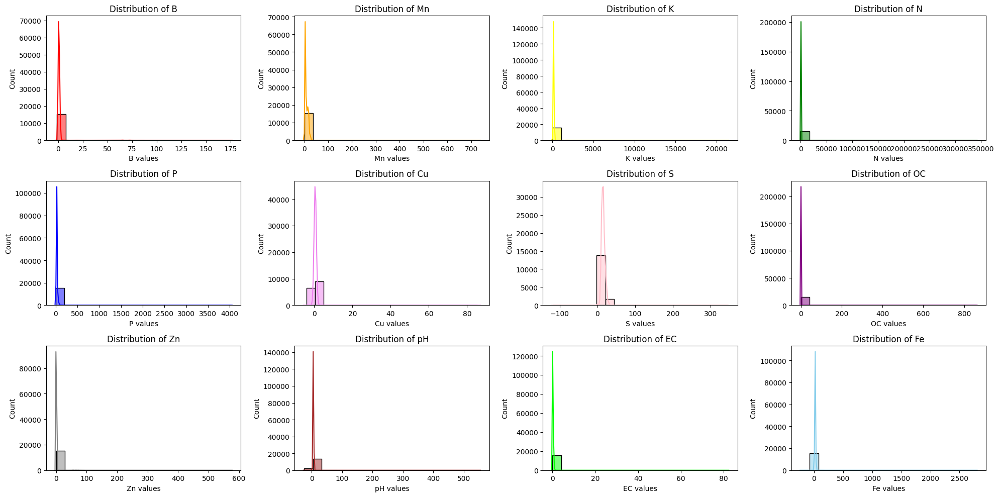

/tmp/ipykernel_19888/1435975282.py:30: FutureWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  df = df.groupby("district", group_keys=False).apply(apply_z_filter)


After z-score
B min and max values :  Min = 0.08, Max = 1.99
Mn min and max values :  Min = 0.11, Max = 31.5
K min and max values :  Min = 46.0, Max = 276.98
N min and max values :  Min = 0.11, Max = 580.0
P min and max values :  Min = 0.45, Max = 82.58
Cu min and max values :  Min = 0.0, Max = 1.33
S min and max values :  Min = 0.21, Max = 35.0
OC min and max values :  Min = 0.0, Max = 1.0
Zn min and max values :  Min = 0.0, Max = 1.23
pH min and max values :  Min = 2.24, Max = 9.3
EC min and max values :  Min = 0.0, Max = 0.72
Fe min and max values :  Min = 0.41, Max = 38.0


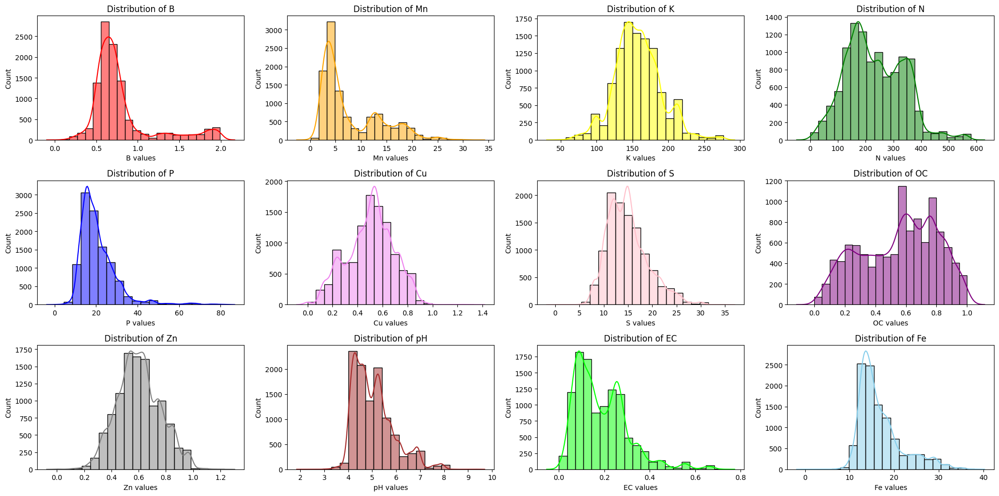

Total districts : 8
TRIPURA_2024.csv:: No. of samples reduced from 15494 to 10848
Before z-score
B min and max values :  Min = 0.0, Max = 1017.0
Mn min and max values :  Min = -7.36, Max = 80511.0
K min and max values :  Min = 0.0, Max = 305146.0
N min and max values :  Min = 0.0, Max = 154029.0
P min and max values :  Min = 0.0, Max = 41364.0
Cu min and max values :  Min = -1.0, Max = 10202.0
S min and max values :  Min = 0.0, Max = 140178.0
OC min and max values :  Min = 0.0, Max = 3617.0
Zn min and max values :  Min = 0.0, Max = 5354.0
pH min and max values :  Min = -16.72, Max = 8019.0
EC min and max values :  Min = 0.0, Max = 3648.0
Fe min and max values :  Min = 0.0, Max = 153765.0


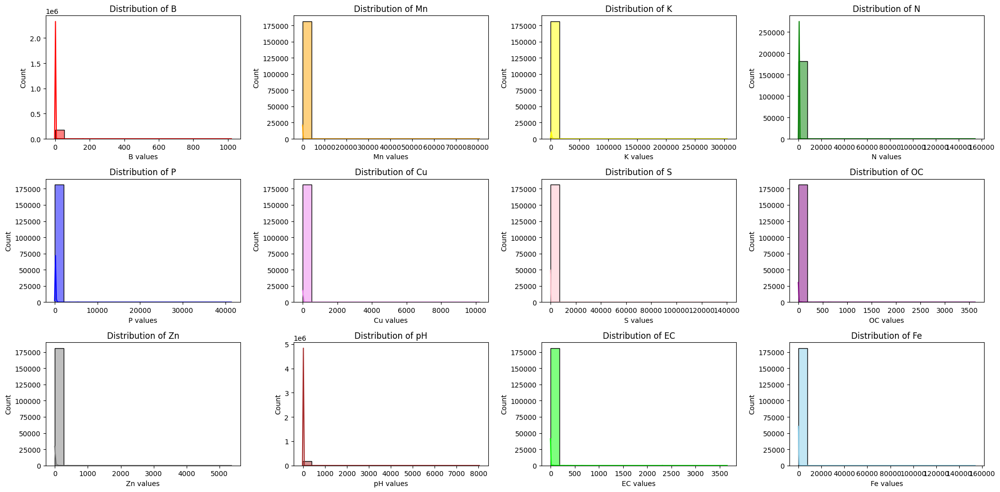

/tmp/ipykernel_19888/1435975282.py:30: FutureWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  df = df.groupby("district", group_keys=False).apply(apply_z_filter)


After z-score
B min and max values :  Min = 0.0, Max = 3.87
Mn min and max values :  Min = 0.0, Max = 80.7
K min and max values :  Min = 0.0, Max = 951.0
N min and max values :  Min = 0.148, Max = 763.0
P min and max values :  Min = 0.0, Max = 201.0
Cu min and max values :  Min = 0.0, Max = 6.34
S min and max values :  Min = 0.0, Max = 124.0
OC min and max values :  Min = 0.0, Max = 1.0
Zn min and max values :  Min = 0.0, Max = 10.5
pH min and max values :  Min = 1.0, Max = 12.65
EC min and max values :  Min = 0.0, Max = 1.45
Fe min and max values :  Min = 0.0, Max = 193.127


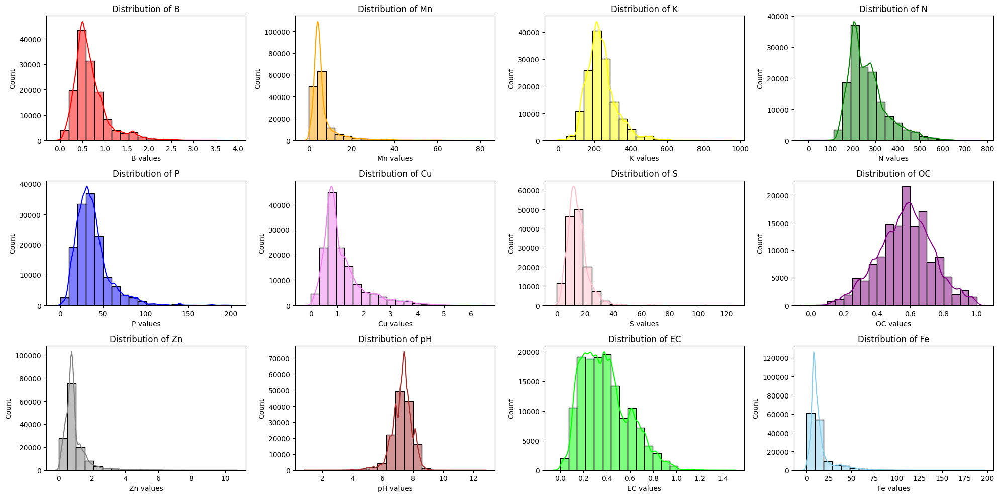

Total districts : 38
BIHAR_2024.csv:: No. of samples reduced from 181153 to 139251
Before z-score
B min and max values :  Min = 0.0, Max = 1044.0
Mn min and max values :  Min = 0.0, Max = 9016.0
K min and max values :  Min = 0.43, Max = 6000.0
N min and max values :  Min = 0.0, Max = 22515.0
P min and max values :  Min = 0.03, Max = 42190.0
Cu min and max values :  Min = 0.0, Max = 994.0
S min and max values :  Min = 0.022, Max = 383614.0
OC min and max values :  Min = 0.008, Max = 308.0
Zn min and max values :  Min = 0.0, Max = 7345.0
pH min and max values :  Min = -15.5, Max = 607.0
EC min and max values :  Min = 0.001, Max = 109.0
Fe min and max values :  Min = 0.0, Max = 138354.0


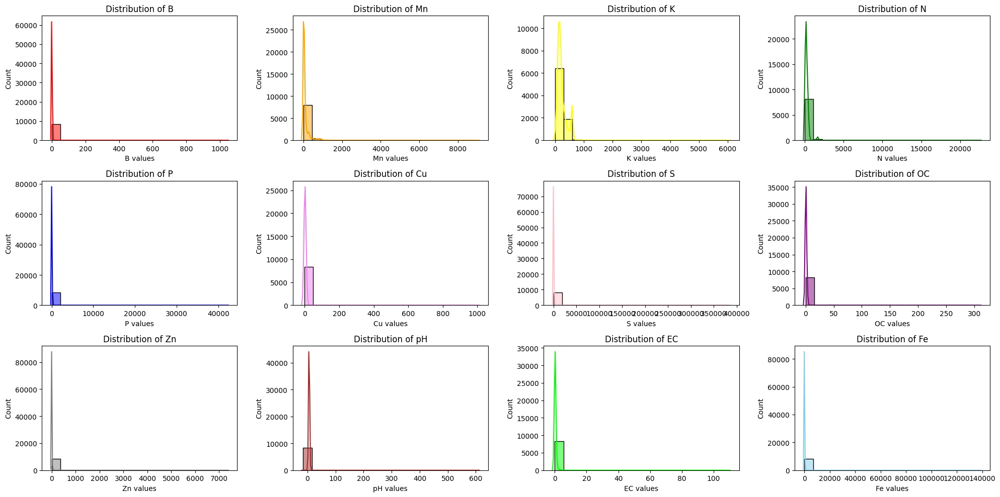

/tmp/ipykernel_19888/1435975282.py:30: FutureWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  df = df.groupby("district", group_keys=False).apply(apply_z_filter)


After z-score
B min and max values :  Min = 0.001, Max = 5.524
Mn min and max values :  Min = 0.0, Max = 220.14
K min and max values :  Min = 0.6, Max = 600.0
N min and max values :  Min = 0.0, Max = 646.99
P min and max values :  Min = 0.03, Max = 301.0
Cu min and max values :  Min = 0.0, Max = 9.983650795686728
S min and max values :  Min = 0.022, Max = 145.03
OC min and max values :  Min = 0.008, Max = 1.0
Zn min and max values :  Min = 0.0, Max = 3.0
pH min and max values :  Min = 2.45, Max = 9.953363762811332
EC min and max values :  Min = 0.007, Max = 1.5
Fe min and max values :  Min = 0.0, Max = 131.06


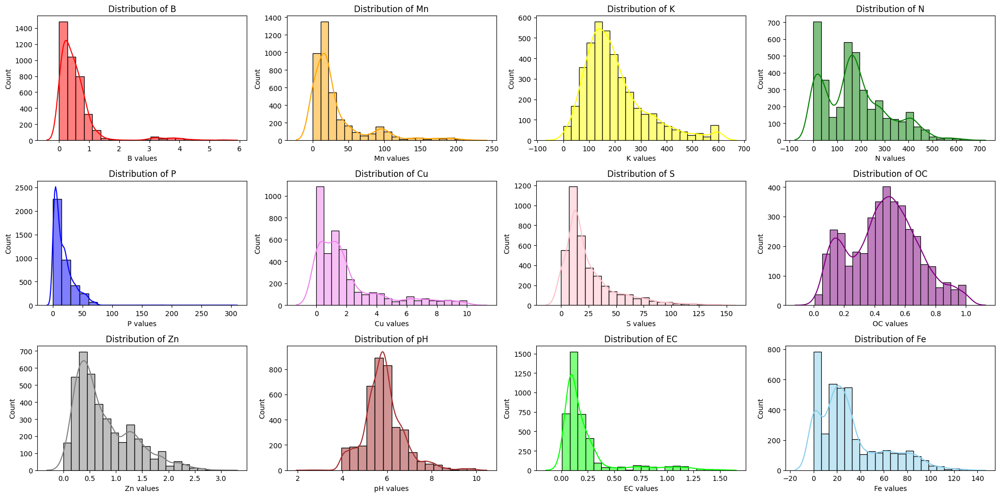

Total districts : 13
ODISHA_2024.csv:: No. of samples reduced from 8329 to 3958
Before z-score
B min and max values :  Min = 0.0, Max = 279.0
Mn min and max values :  Min = 0.0, Max = 6380.0
K min and max values :  Min = 0.13, Max = 9797.0
N min and max values :  Min = 0.0, Max = 8127.0
P min and max values :  Min = 0.0, Max = 2603.0
Cu min and max values :  Min = 0.0, Max = 1651.0
S min and max values :  Min = 0.0, Max = 6364.0
OC min and max values :  Min = -0.55, Max = 571.0
Zn min and max values :  Min = -1.44, Max = 1252.0
pH min and max values :  Min = 0.0, Max = 6345.0
EC min and max values :  Min = 0.0, Max = 494.0
Fe min and max values :  Min = 0.0, Max = 6032.0


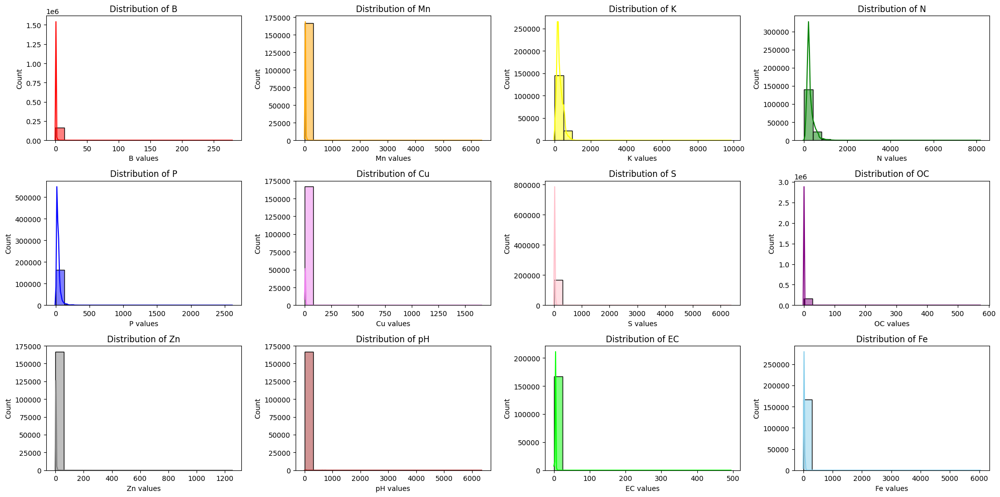

/tmp/ipykernel_19888/1435975282.py:30: FutureWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  df = df.groupby("district", group_keys=False).apply(apply_z_filter)


After z-score
B min and max values :  Min = 0.0, Max = 6.98
Mn min and max values :  Min = 0.0, Max = 69.1
K min and max values :  Min = 1.0, Max = 995.0
N min and max values :  Min = 0.0, Max = 868.0
P min and max values :  Min = 0.0, Max = 295.0
Cu min and max values :  Min = 0.0, Max = 6.85
S min and max values :  Min = 0.0, Max = 98.0
OC min and max values :  Min = 0.0, Max = 1.0
Zn min and max values :  Min = 0.0, Max = 5.66
pH min and max values :  Min = 1.0, Max = 13.7
EC min and max values :  Min = 0.01, Max = 6.48
Fe min and max values :  Min = 0.01, Max = 75.1


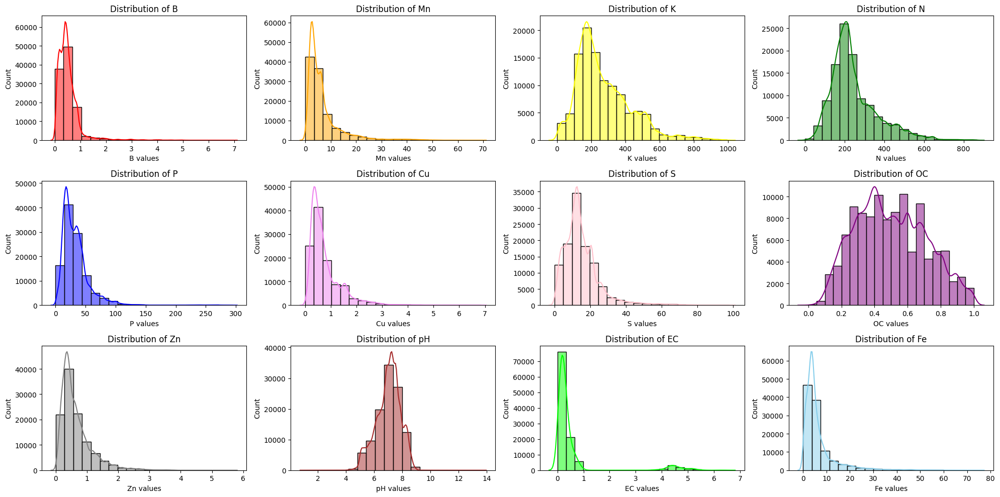

Total districts : 31
KARNATAKA_2024.csv:: No. of samples reduced from 166743 to 110796
Before z-score
B min and max values :  Min = -2.0, Max = 9999.0
Mn min and max values :  Min = -0.086, Max = 7025.0
K min and max values :  Min = 0.0, Max = 321364.0
N min and max values :  Min = 0.0, Max = 556013.0
P min and max values :  Min = -6.0, Max = 56914.0
Cu min and max values :  Min = -40.0, Max = 2045.0
S min and max values :  Min = -116.9, Max = 15555.2
OC min and max values :  Min = -1.0, Max = 1041.0
Zn min and max values :  Min = -12.1, Max = 1624.0
pH min and max values :  Min = -1701.0, Max = 8014.0
EC min and max values :  Min = -10.19, Max = 1444.0
Fe min and max values :  Min = 0.0, Max = 8088.0


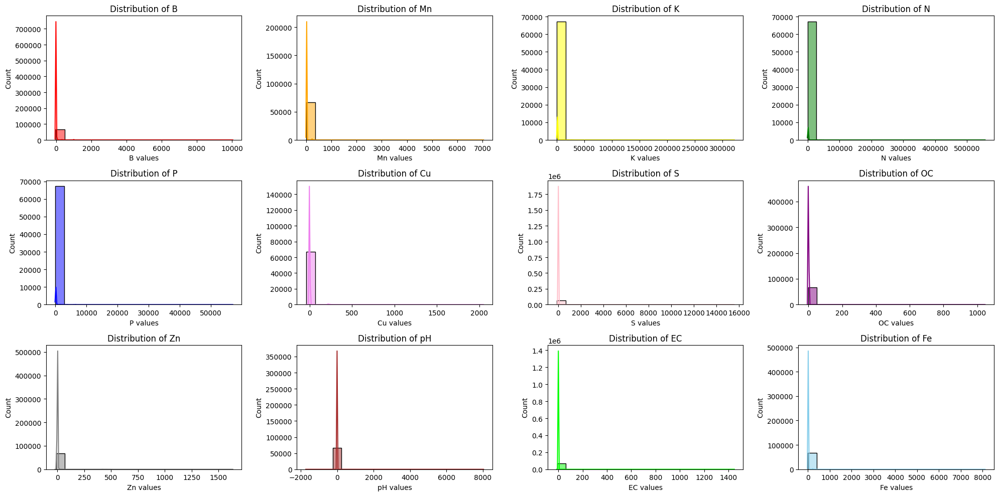

/tmp/ipykernel_19888/1435975282.py:30: FutureWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  df = df.groupby("district", group_keys=False).apply(apply_z_filter)


After z-score
B min and max values :  Min = 0.0, Max = 5.45
Mn min and max values :  Min = 0.0, Max = 29.1
K min and max values :  Min = 0.14255, Max = 715.0
N min and max values :  Min = 0.366, Max = 832.0
P min and max values :  Min = 0.0, Max = 122.15
Cu min and max values :  Min = 0.0, Max = 5.62
S min and max values :  Min = 0.0, Max = 141.63
OC min and max values :  Min = 0.0, Max = 1.0
Zn min and max values :  Min = 0.0, Max = 16.34
pH min and max values :  Min = 1.16, Max = 10.3
EC min and max values :  Min = 0.0, Max = 2.74
Fe min and max values :  Min = 0.0, Max = 40.0


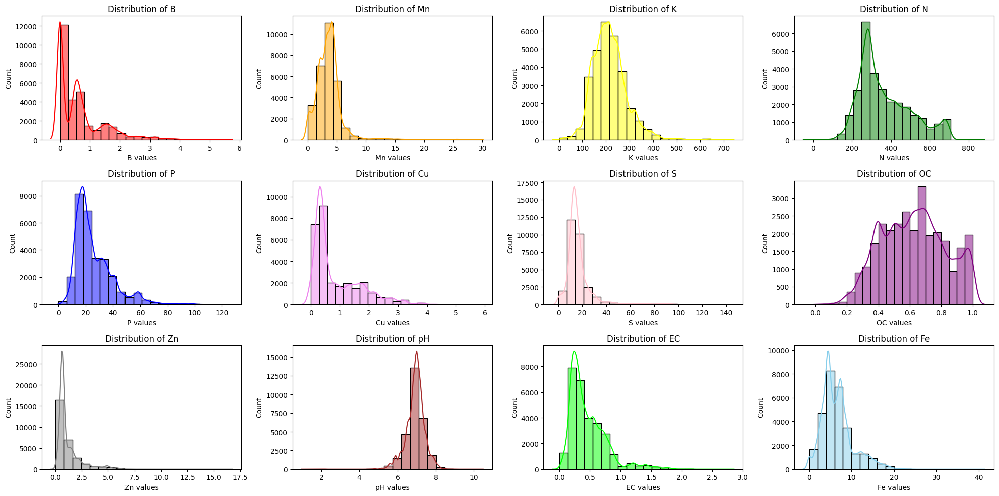

Total districts : 20
JAMMU & KASHMIR_2024.csv:: No. of samples reduced from 67181 to 29206
Before z-score
B min and max values :  Min = 0.48, Max = 23.82
Mn min and max values :  Min = 1.68, Max = 50.11
K min and max values :  Min = 22.89, Max = 745.6
N min and max values :  Min = 66.48, Max = 2263.42
P min and max values :  Min = 1.55, Max = 23.22
Cu min and max values :  Min = 0.02, Max = 5.77
S min and max values :  Min = 0.17, Max = 11.28
OC min and max values :  Min = 0.06, Max = 12.34
Zn min and max values :  Min = 0.06, Max = 4.89
pH min and max values :  Min = 4.7, Max = 7.9
EC min and max values :  Min = 0.1, Max = 2.7
Fe min and max values :  Min = 0.38, Max = 81.22


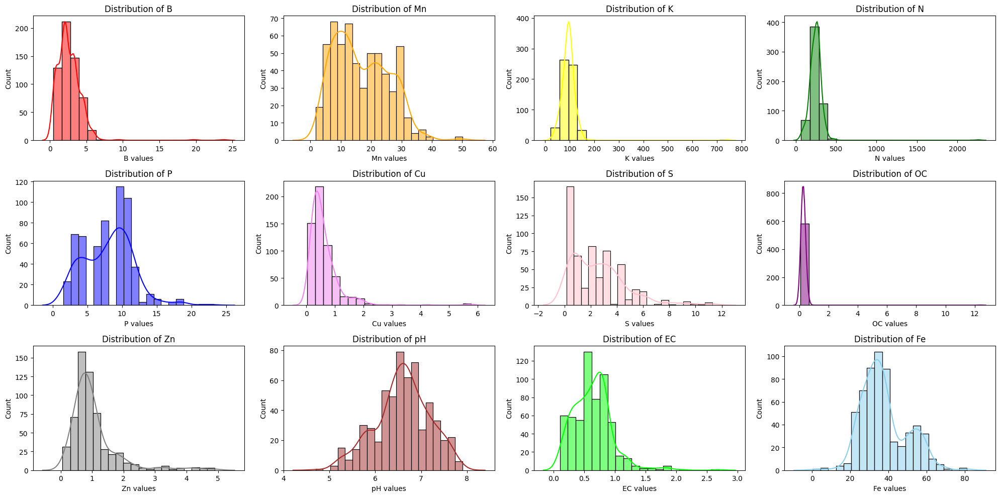

/tmp/ipykernel_19888/1435975282.py:30: FutureWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  df = df.groupby("district", group_keys=False).apply(apply_z_filter)


After z-score
B min and max values :  Min = 0.85, Max = 6.19
Mn min and max values :  Min = 1.68, Max = 39.16
K min and max values :  Min = 22.89, Max = 186.15
N min and max values :  Min = 66.48, Max = 401.41
P min and max values :  Min = 1.55, Max = 17.03
Cu min and max values :  Min = 0.02, Max = 1.58
S min and max values :  Min = 0.17, Max = 9.06
OC min and max values :  Min = 0.1, Max = 0.7
Zn min and max values :  Min = 0.06, Max = 2.51
pH min and max values :  Min = 5.12, Max = 7.9
EC min and max values :  Min = 0.1, Max = 1.8
Fe min and max values :  Min = 14.22, Max = 81.22


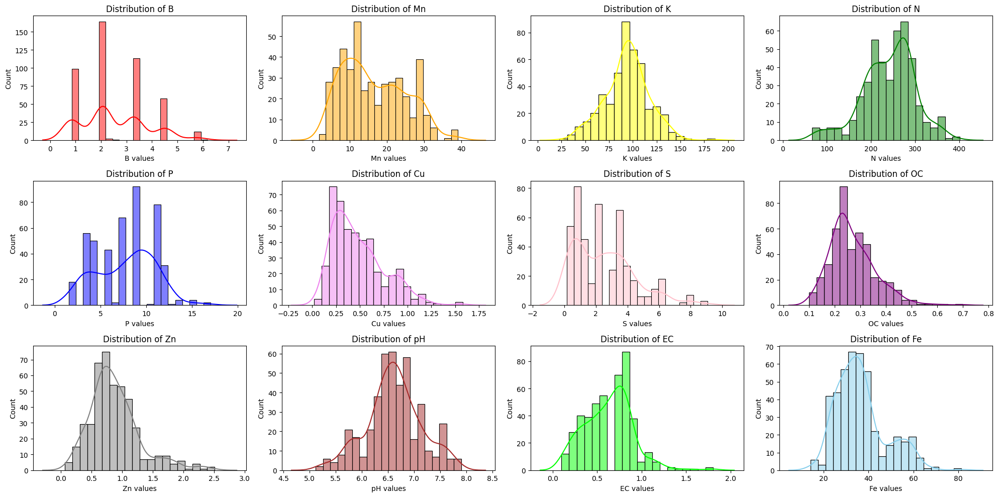

Total districts : 3
ANDAMAN & NICOBAR_2024.csv:: No. of samples reduced from 585 to 450
Before z-score
B min and max values :  Min = -8.052, Max = 4015.0
Mn min and max values :  Min = -45.2, Max = 13220.0
K min and max values :  Min = -38.4, Max = 199999999.9
N min and max values :  Min = 0.0, Max = 69308.0
P min and max values :  Min = -32.5, Max = 90010.0
Cu min and max values :  Min = -64.12, Max = 1096.0
S min and max values :  Min = -136.21, Max = 45322.0
OC min and max values :  Min = -1.422, Max = 534.4
Zn min and max values :  Min = -39.3, Max = 7654.0
pH min and max values :  Min = -26.16, Max = 7029.0
EC min and max values :  Min = -1.74935, Max = 373.0
Fe min and max values :  Min = -103.12, Max = 80124.0


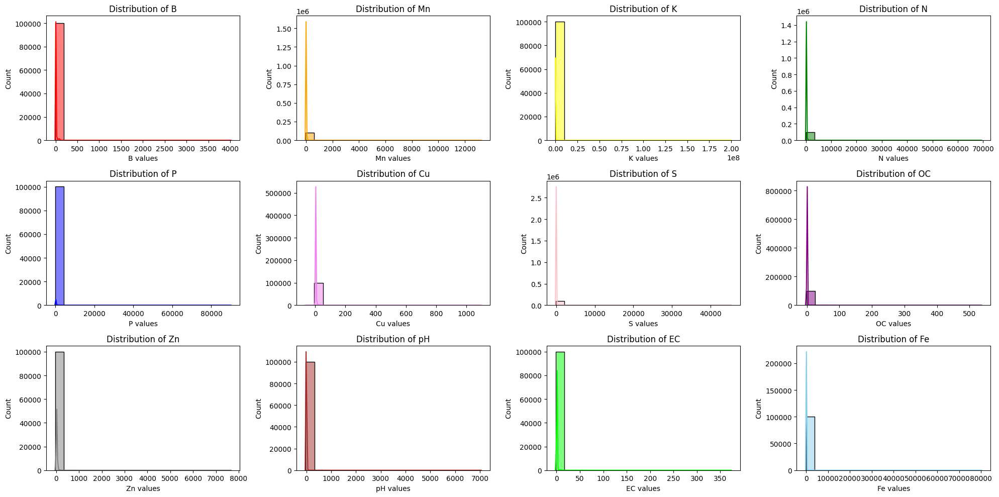

/tmp/ipykernel_19888/1435975282.py:30: FutureWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  df = df.groupby("district", group_keys=False).apply(apply_z_filter)


After z-score
B min and max values :  Min = 0.0, Max = 9.76
Mn min and max values :  Min = 0.0, Max = 145.0
K min and max values :  Min = 0.0, Max = 761.66
N min and max values :  Min = 0.0, Max = 671.0
P min and max values :  Min = 0.0, Max = 134.5
Cu min and max values :  Min = 0.0, Max = 11.6
S min and max values :  Min = 0.0, Max = 159.0
OC min and max values :  Min = 0.0, Max = 1.0
Zn min and max values :  Min = 0.0, Max = 78.2
pH min and max values :  Min = 1.0, Max = 13.74
EC min and max values :  Min = 0.0, Max = 1.26
Fe min and max values :  Min = 0.0, Max = 116.3


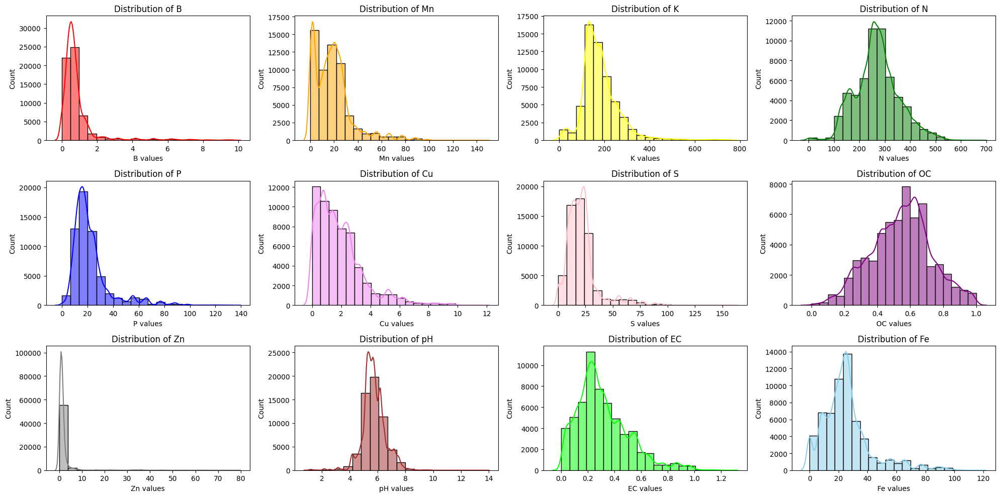

Total districts : 24
JHARKHAND_2024.csv:: No. of samples reduced from 100067 to 58978
Before z-score
B min and max values :  Min = 0.0, Max = 23.61
Mn min and max values :  Min = 0.0, Max = 3168.0
K min and max values :  Min = 0.0, Max = 444364.0
N min and max values :  Min = 0.0, Max = 125044.0
P min and max values :  Min = 0.0, Max = 169345.0
Cu min and max values :  Min = -1.0, Max = 168.0
S min and max values :  Min = -2.0, Max = 6025.0
OC min and max values :  Min = -2.0, Max = 1349.0
Zn min and max values :  Min = -2.0, Max = 577.02
pH min and max values :  Min = -15.22, Max = 540.0
EC min and max values :  Min = 0.0, Max = 73.0
Fe min and max values :  Min = 0.0, Max = 1023.0


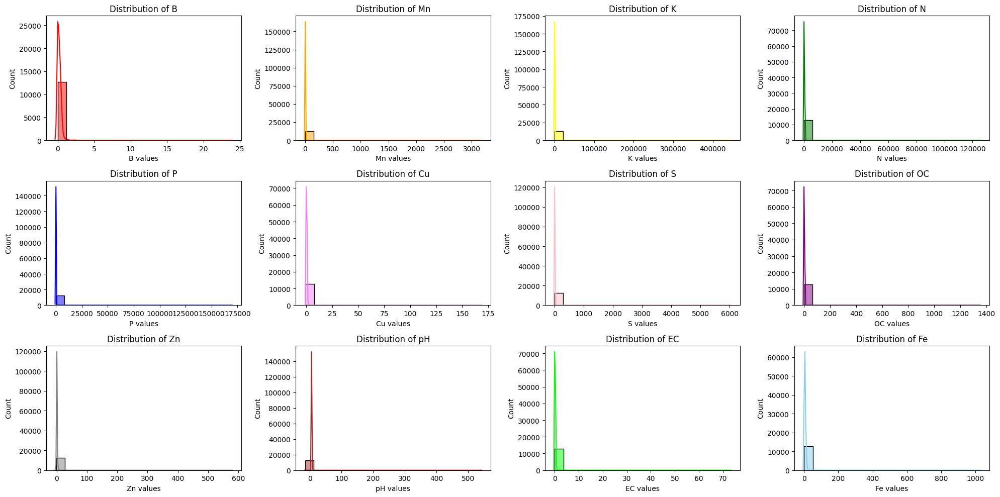

/tmp/ipykernel_19888/1435975282.py:30: FutureWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  df = df.groupby("district", group_keys=False).apply(apply_z_filter)


After z-score
B min and max values :  Min = 0.0, Max = 1.086
Mn min and max values :  Min = 0.002, Max = 13.04
K min and max values :  Min = 16.8, Max = 566.72
N min and max values :  Min = 75.24, Max = 578.0
P min and max values :  Min = 3.36, Max = 75.04
Cu min and max values :  Min = 0.002, Max = 1.47
S min and max values :  Min = 0.0, Max = 29.76
OC min and max values :  Min = 0.0, Max = 1.0
Zn min and max values :  Min = 0.0, Max = 3.188
pH min and max values :  Min = 4.0, Max = 6.4
EC min and max values :  Min = 0.01, Max = 0.61
Fe min and max values :  Min = 0.002, Max = 23.756


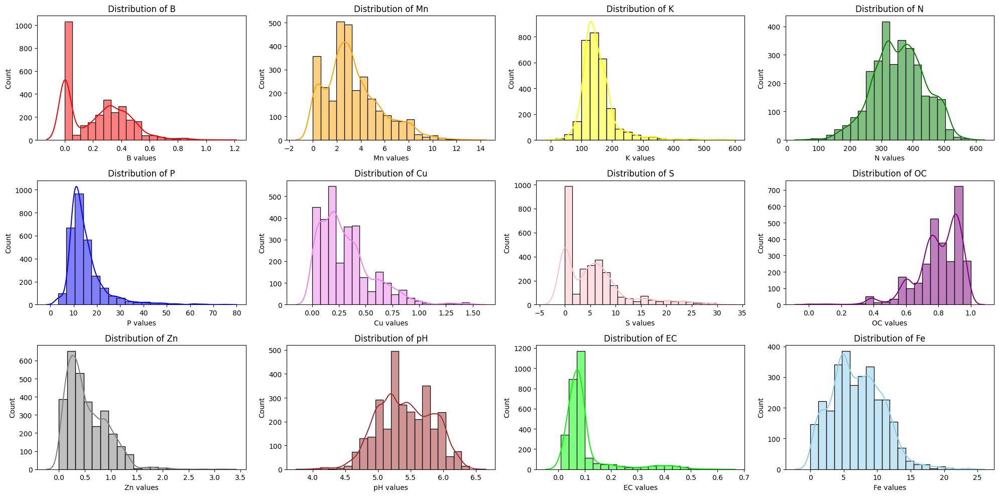

Total districts : 12
MEGHALAYA_2024.csv:: No. of samples reduced from 12723 to 2950
Before z-score
B min and max values :  Min = -7.0, Max = 235689.0
Mn min and max values :  Min = -13.68, Max = 86960.0
K min and max values :  Min = -1.0, Max = 280000000.0
N min and max values :  Min = -1268.0, Max = 83333333.25
P min and max values :  Min = -13.5, Max = 31157.0
Cu min and max values :  Min = -5.0, Max = 3e+23
S min and max values :  Min = -1246.0, Max = 120246.0
OC min and max values :  Min = -254.0, Max = 34193.0
Zn min and max values :  Min = -11.2, Max = 6e+23
pH min and max values :  Min = -37.7, Max = 79101.25
EC min and max values :  Min = -4.0, Max = 6381.0
Fe min and max values :  Min = -19.76, Max = 72244.0


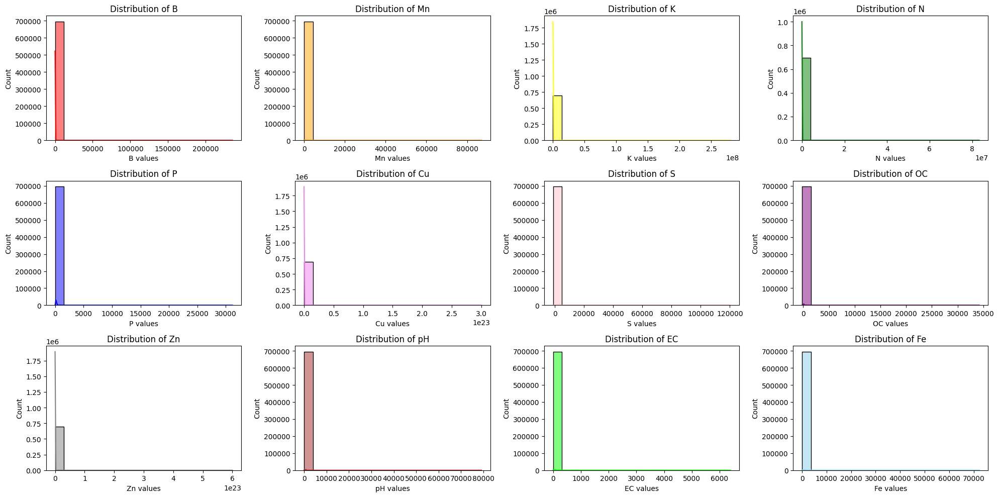

/tmp/ipykernel_19888/1435975282.py:30: FutureWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  df = df.groupby("district", group_keys=False).apply(apply_z_filter)


After z-score
B min and max values :  Min = 0.0, Max = 17.9
Mn min and max values :  Min = 0.0, Max = 35.0
K min and max values :  Min = 0.0, Max = 703.0
N min and max values :  Min = 0.0, Max = 548.0
P min and max values :  Min = 0.0, Max = 72.5
Cu min and max values :  Min = 0.0, Max = 5.35
S min and max values :  Min = 0.0, Max = 44.57
OC min and max values :  Min = 0.0, Max = 1.0
Zn min and max values :  Min = 0.0, Max = 4.21
pH min and max values :  Min = 1.0, Max = 13.8
EC min and max values :  Min = 0.0, Max = 2.4
Fe min and max values :  Min = 0.0, Max = 53.37


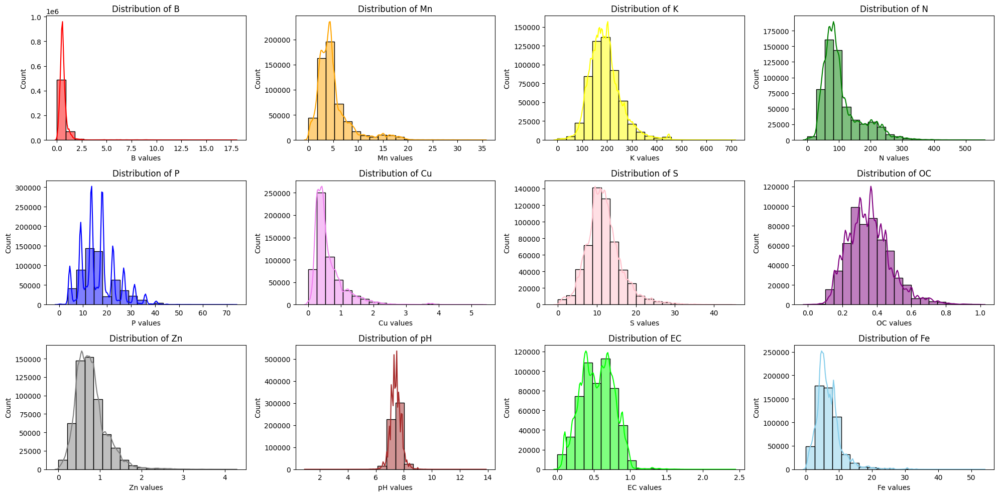

Total districts : 75
UTTAR PRADESH_2024.csv:: No. of samples reduced from 695199 to 571477
Before z-score
B min and max values :  Min = 0.0, Max = 0.0
Mn min and max values :  Min = 0.103, Max = 9572.0
K min and max values :  Min = 1.36, Max = 198100.0
N min and max values :  Min = 5.0, Max = 714.0
P min and max values :  Min = 0.29, Max = 616.6
Cu min and max values :  Min = 0.036, Max = 478.0
S min and max values :  Min = 0.0, Max = 0.0
OC min and max values :  Min = 0.0, Max = 1.3
Zn min and max values :  Min = 0.036, Max = 38.3
pH min and max values :  Min = 2.1, Max = 104.0
EC min and max values :  Min = 0.0, Max = 8.0
Fe min and max values :  Min = 0.016, Max = 89.19


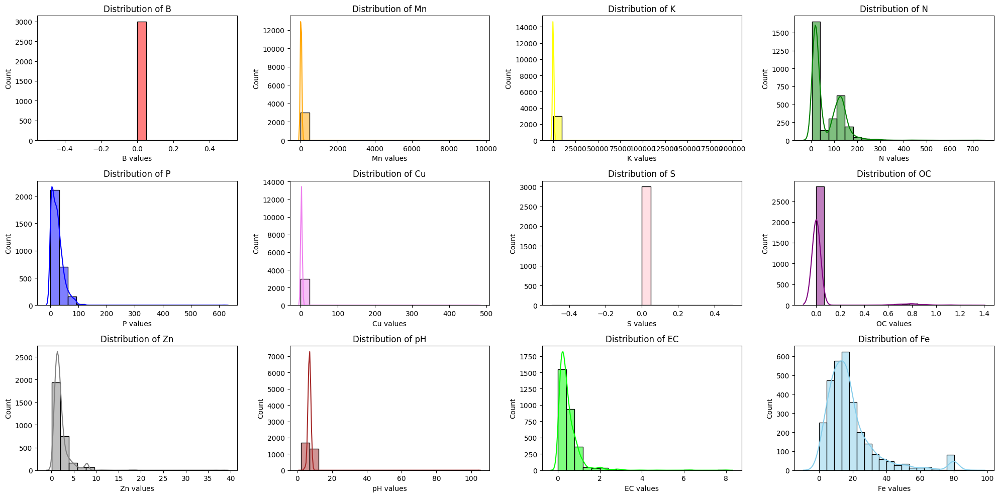

/tmp/ipykernel_19888/1435975282.py:30: FutureWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  df = df.groupby("district", group_keys=False).apply(apply_z_filter)


After z-score
B min and max values :  Min = 0.0, Max = 0.0
Mn min and max values :  Min = 0.103, Max = 38.704
K min and max values :  Min = 11.68, Max = 488.3
N min and max values :  Min = 5.0, Max = 193.6
P min and max values :  Min = 0.29, Max = 77.76
Cu min and max values :  Min = 0.036, Max = 5.92
S min and max values :  Min = 0.0, Max = 0.0
OC min and max values :  Min = 0.0, Max = 0.99
Zn min and max values :  Min = 0.036, Max = 5.0
pH min and max values :  Min = 4.0, Max = 8.95
EC min and max values :  Min = 0.0, Max = 1.51
Fe min and max values :  Min = 0.016, Max = 43.52


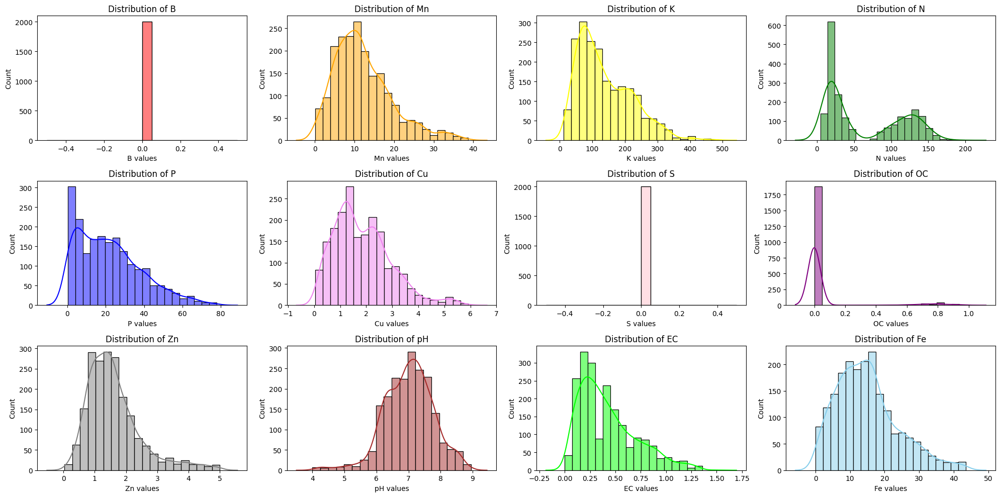

Total districts : 2
PUDUCHERRY_2024.csv:: No. of samples reduced from 2996 to 1999
Before z-score
B min and max values :  Min = 0.0, Max = 19714.0
Mn min and max values :  Min = 0.0, Max = 14289.0
K min and max values :  Min = 0.0, Max = 19505.0
N min and max values :  Min = 0.0, Max = 61284.0
P min and max values :  Min = 0.0, Max = 6606.0
Cu min and max values :  Min = -1.0, Max = 8918.0
S min and max values :  Min = -1101.21, Max = 27078.0
OC min and max values :  Min = -1.0, Max = 7908.0
Zn min and max values :  Min = -1.0, Max = 14073.0
pH min and max values :  Min = -16.0, Max = 1089.0
EC min and max values :  Min = 0.0, Max = 754.1
Fe min and max values :  Min = 0.0, Max = 70532.0


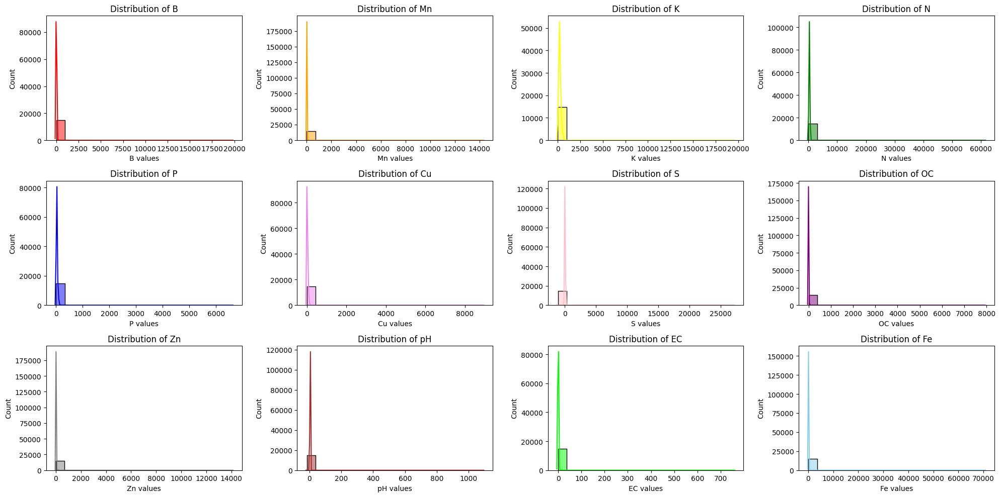

/tmp/ipykernel_19888/1435975282.py:30: FutureWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  df = df.groupby("district", group_keys=False).apply(apply_z_filter)


After z-score
B min and max values :  Min = 0.0, Max = 36.81
Mn min and max values :  Min = 0.0, Max = 36.22
K min and max values :  Min = 0.0, Max = 780.64
N min and max values :  Min = 0.3, Max = 928.0
P min and max values :  Min = 0.0, Max = 169.2
Cu min and max values :  Min = 0.0, Max = 142.19
S min and max values :  Min = 0.0, Max = 171.9
OC min and max values :  Min = 0.0, Max = 1.0
Zn min and max values :  Min = 0.0, Max = 45.9
pH min and max values :  Min = 1.01, Max = 11.08
EC min and max values :  Min = 0.0, Max = 1.06
Fe min and max values :  Min = 0.0, Max = 101.77


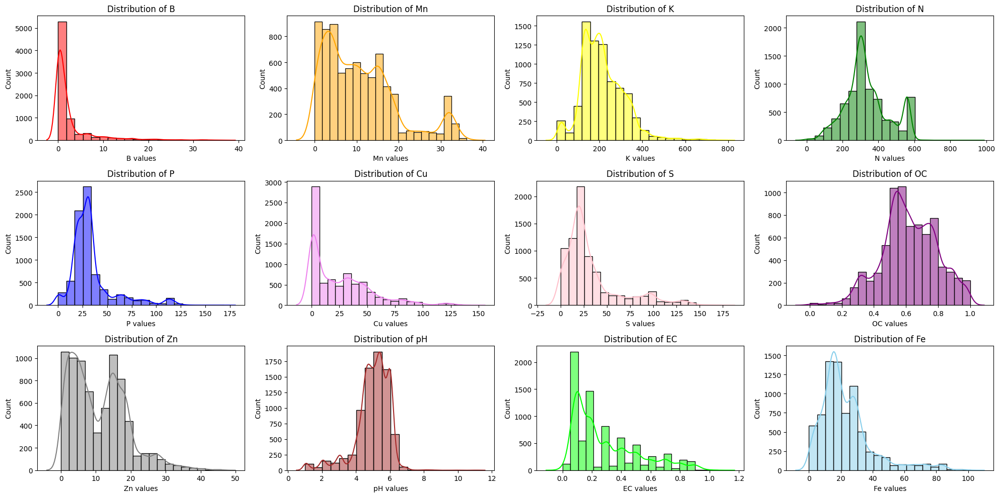

Total districts : 6
SIKKIM_2024.csv:: No. of samples reduced from 14824 to 7622
Before z-score
B min and max values :  Min = 0.0, Max = 86.36
Mn min and max values :  Min = 0.0, Max = 27.64
K min and max values :  Min = 0.0, Max = 871.27
N min and max values :  Min = -1351.0, Max = 3667.0
P min and max values :  Min = 0.0, Max = 832.0
Cu min and max values :  Min = 0.0, Max = 261.17
S min and max values :  Min = -2.0, Max = 313.6
OC min and max values :  Min = -11.05, Max = 1095.0
Zn min and max values :  Min = -2.0, Max = 272.18
pH min and max values :  Min = -35.5, Max = 536.0
EC min and max values :  Min = 0.0, Max = 644.7
Fe min and max values :  Min = -10.0, Max = 253.31


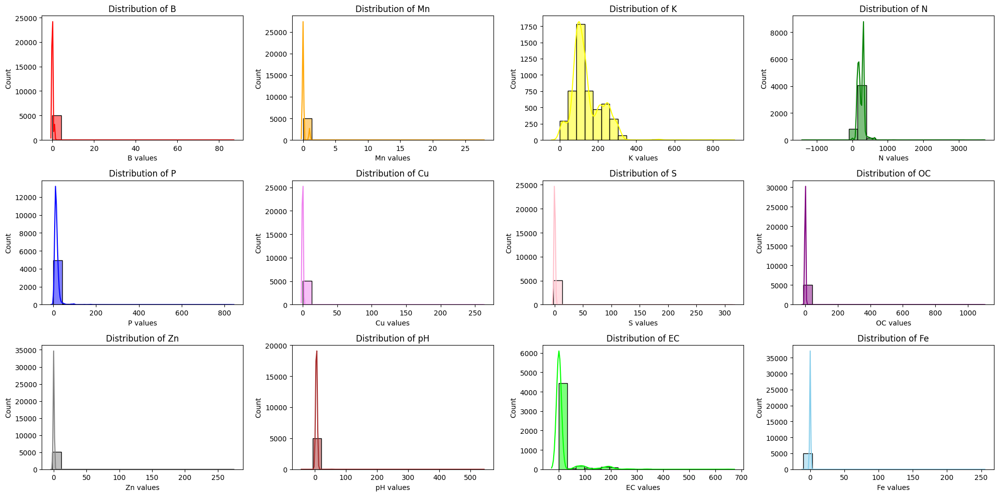

/tmp/ipykernel_19888/1435975282.py:30: FutureWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  df = df.groupby("district", group_keys=False).apply(apply_z_filter)


After z-score
B min and max values :  Min = 0.0, Max = 1.0
Mn min and max values :  Min = 0.0, Max = 1.0
K min and max values :  Min = 4.49, Max = 319.598
N min and max values :  Min = 124.5, Max = 563.0
P min and max values :  Min = 3.5, Max = 44.26
Cu min and max values :  Min = 0.0, Max = 1.0
S min and max values :  Min = 0.0, Max = 1.0
OC min and max values :  Min = 0.0, Max = 1.0
Zn min and max values :  Min = 0.0, Max = 1.0
pH min and max values :  Min = 4.16, Max = 9.6
EC min and max values :  Min = 0.0, Max = 147.5
Fe min and max values :  Min = 0.0, Max = 1.0


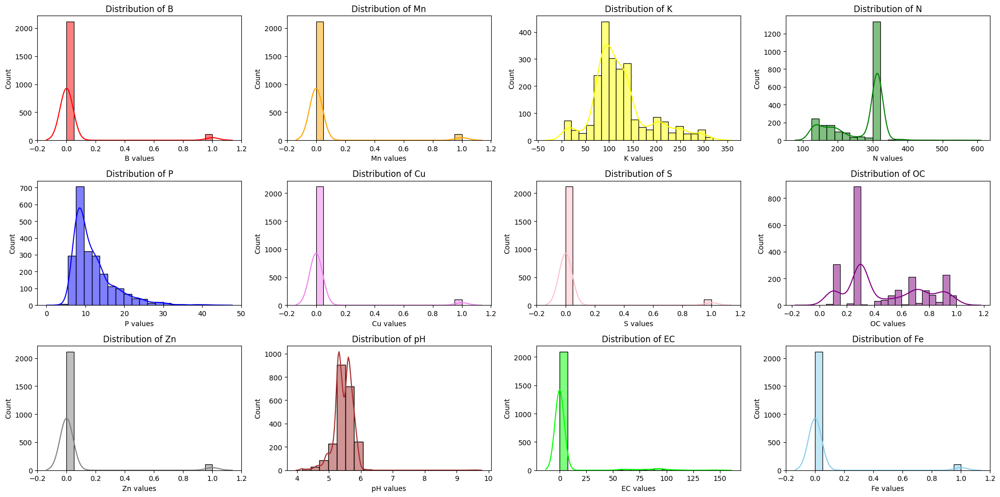

Total districts : 11
MIZORAM_2024.csv:: No. of samples reduced from 5031 to 2220
Before z-score
B min and max values :  Min = 0.0, Max = 3.0
Mn min and max values :  Min = 0.0, Max = 13.6
K min and max values :  Min = 0.0, Max = 110.4
N min and max values :  Min = 412.0, Max = 560.0
P min and max values :  Min = 0.0, Max = 0.0
Cu min and max values :  Min = 0.0, Max = 0.0
S min and max values :  Min = 0.0, Max = 102.5
OC min and max values :  Min = 0.6186, Max = 0.938
Zn min and max values :  Min = 0.0, Max = 0.0
pH min and max values :  Min = 7.61, Max = 7.62
EC min and max values :  Min = 0.19, Max = 0.4
Fe min and max values :  Min = 0.0, Max = 1.5


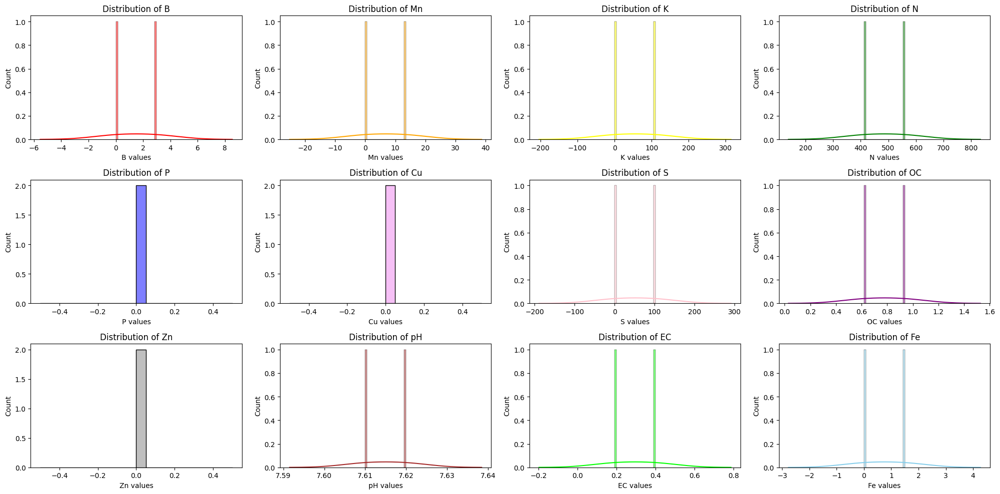

/tmp/ipykernel_19888/1435975282.py:30: FutureWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  df = df.groupby("district", group_keys=False).apply(apply_z_filter)


After z-score
B min and max values :  Min = 0.0, Max = 3.0
Mn min and max values :  Min = 0.0, Max = 13.6
K min and max values :  Min = 0.0, Max = 110.4
N min and max values :  Min = 412.0, Max = 560.0
P min and max values :  Min = 0.0, Max = 0.0
Cu min and max values :  Min = 0.0, Max = 0.0
S min and max values :  Min = 0.0, Max = 102.5
OC min and max values :  Min = 0.6186, Max = 0.938
Zn min and max values :  Min = 0.0, Max = 0.0
pH min and max values :  Min = 7.61, Max = 7.62
EC min and max values :  Min = 0.19, Max = 0.4
Fe min and max values :  Min = 0.0, Max = 1.5


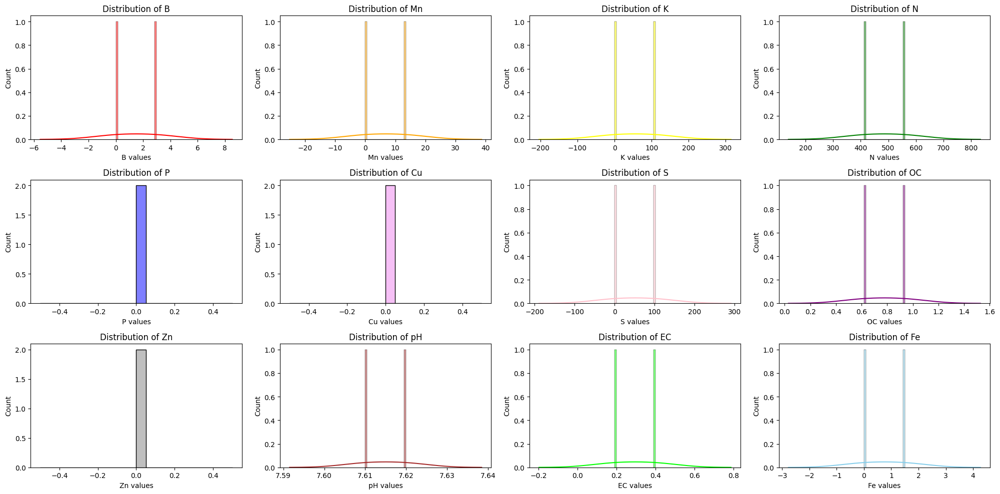

Total districts : 1
LADAKH_2024.csv:: No. of samples reduced from 2 to 2
Before z-score
B min and max values :  Min = 0.004, Max = 9.66
Mn min and max values :  Min = 0.0, Max = 163.0
K min and max values :  Min = 0.0, Max = 1435.8399999999997
N min and max values :  Min = 0.35, Max = 51090.0
P min and max values :  Min = 0.053, Max = 568.9
Cu min and max values :  Min = 0.0, Max = 136.0
S min and max values :  Min = 0.0, Max = 282.23999999999995
OC min and max values :  Min = 0.0, Max = 565.8655
Zn min and max values :  Min = 0.0, Max = 47.304
pH min and max values :  Min = 0.0, Max = 495.0
EC min and max values :  Min = 0.0, Max = 310.0
Fe min and max values :  Min = 1.046, Max = 223.96


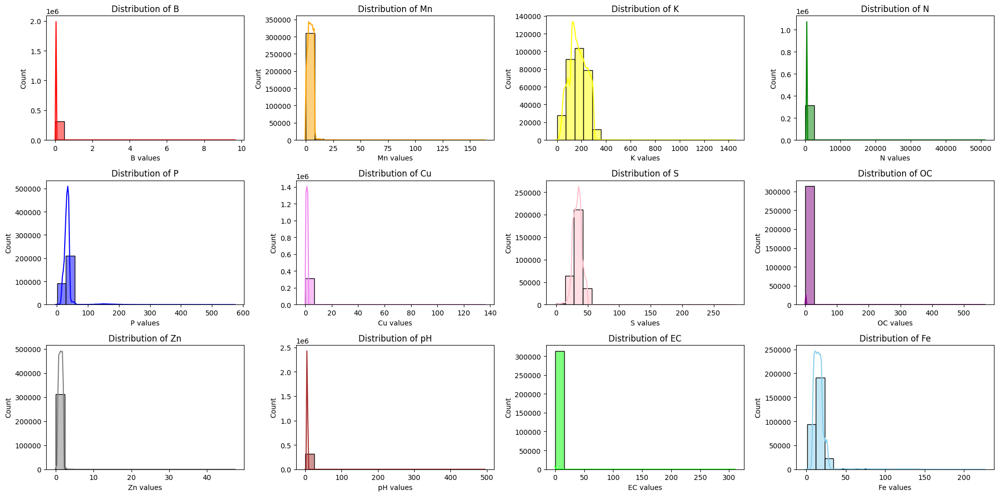

/tmp/ipykernel_19888/1435975282.py:30: FutureWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  df = df.groupby("district", group_keys=False).apply(apply_z_filter)


After z-score
B min and max values :  Min = 0.01, Max = 0.06
Mn min and max values :  Min = 0.0, Max = 12.969
K min and max values :  Min = 0.0, Max = 448.0
N min and max values :  Min = 200.0, Max = 640.0
P min and max values :  Min = 3.9936, Max = 63.744
Cu min and max values :  Min = 0.001, Max = 3.5
S min and max values :  Min = 0.362, Max = 65.88
OC min and max values :  Min = 0.035, Max = 1.0
Zn min and max values :  Min = 0.0, Max = 3.166
pH min and max values :  Min = 1.9, Max = 9.9
EC min and max values :  Min = 0.0, Max = 0.98
Fe min and max values :  Min = 1.046, Max = 59.74


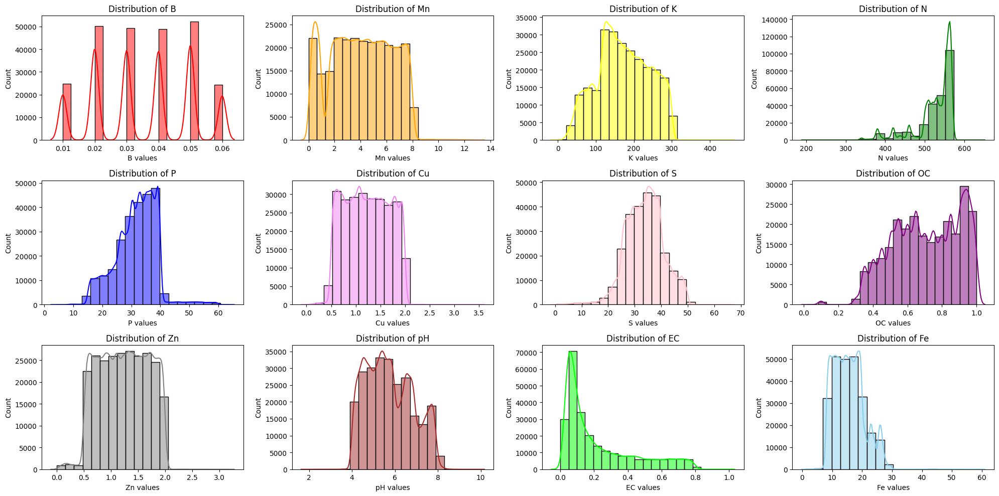

Total districts : 17
ASSAM_2024.csv:: No. of samples reduced from 313574 to 249934
Before z-score
B min and max values :  Min = -11.4, Max = 3500.0
Mn min and max values :  Min = -2.55, Max = 43331.0
K min and max values :  Min = 0.0, Max = 767578.0
N min and max values :  Min = 0.0, Max = 138140.0
P min and max values :  Min = 0.0, Max = 280125.0
Cu min and max values :  Min = -20.4, Max = 1042.0
S min and max values :  Min = -12.5, Max = 49376.0
OC min and max values :  Min = -124.0, Max = 1234.0
Zn min and max values :  Min = -10.37, Max = 1149.0
pH min and max values :  Min = -38.42, Max = 7388.0
EC min and max values :  Min = -1.985, Max = 936.0
Fe min and max values :  Min = -4.7, Max = 60348.0


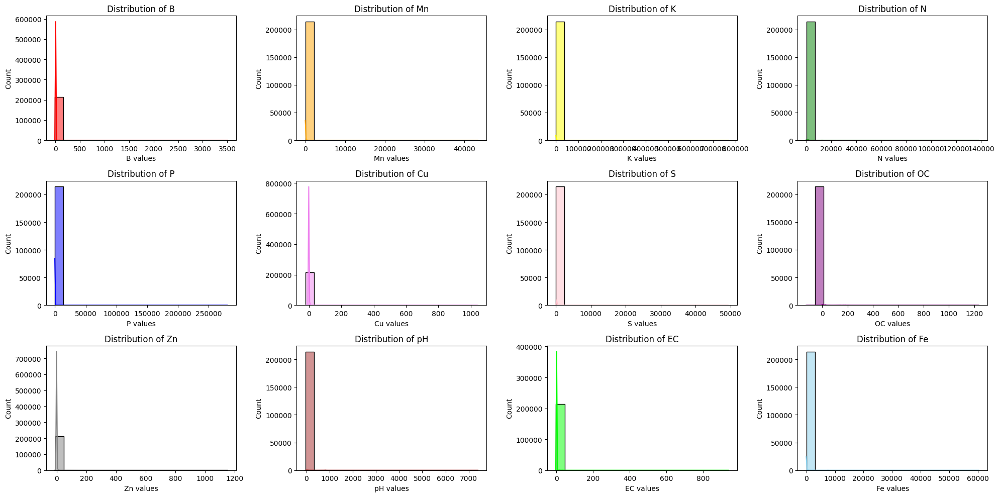

/tmp/ipykernel_19888/1435975282.py:30: FutureWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  df = df.groupby("district", group_keys=False).apply(apply_z_filter)


After z-score
B min and max values :  Min = 0.0, Max = 12.8
Mn min and max values :  Min = 0.0, Max = 21.02
K min and max values :  Min = 0.0, Max = 1489.0
N min and max values :  Min = 0.113, Max = 422.0
P min and max values :  Min = 0.0, Max = 462.0
Cu min and max values :  Min = 0.0, Max = 4.94
S min and max values :  Min = 0.0, Max = 146.0
OC min and max values :  Min = 0.0, Max = 1.0
Zn min and max values :  Min = 0.0, Max = 3.008
pH min and max values :  Min = 1.0, Max = 11.3
EC min and max values :  Min = 0.0, Max = 1.27
Fe min and max values :  Min = 0.0, Max = 50.95


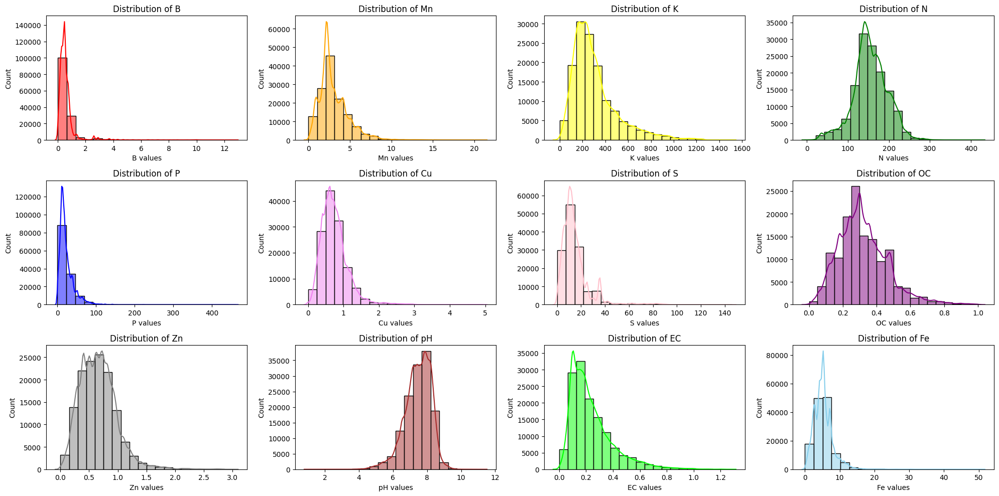

Total districts : 37
TAMIL NADU_2024.csv:: No. of samples reduced from 214021 to 136425
2024 completed
Total records before 4052453, Total records after 2818394
ANDAMAN & NICOBAR_2023.csv does not contain any records
Before z-score
B min and max values :  Min = -1.0, Max = 266.0
Mn min and max values :  Min = -0.84, Max = 14042.0
K min and max values :  Min = 0.0, Max = 266732.0
N min and max values :  Min = 0.0, Max = 31402.0
P min and max values :  Min = 0.0, Max = 43086.0
Cu min and max values :  Min = -3.0, Max = 916.0
S min and max values :  Min = 0.0, Max = 12112.0
OC min and max values :  Min = 0.0, Max = 3600.0
Zn min and max values :  Min = -1.45, Max = 1654.0
pH min and max values :  Min = -17.29, Max = 8012.0
EC min and max values :  Min = 0.0, Max = 1399.0
Fe min and max values :  Min = 0.0, Max = 7085.0


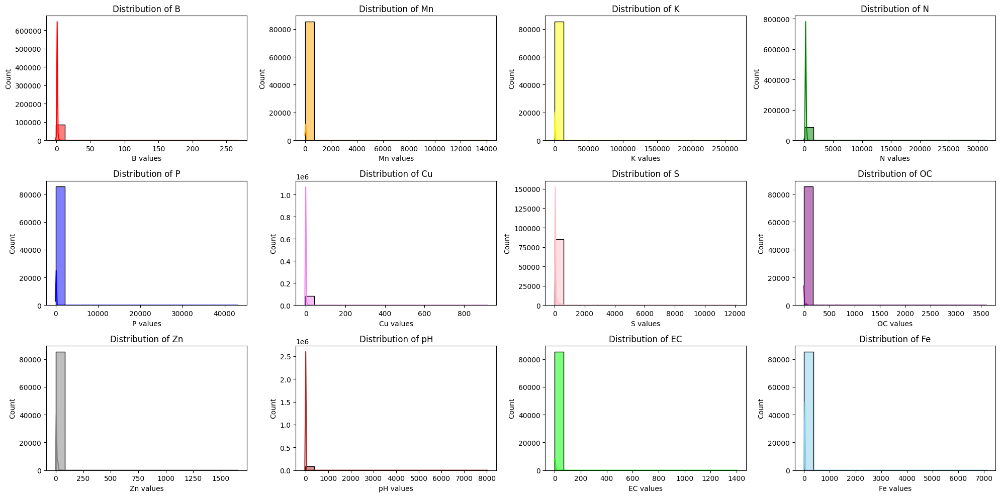

/home/aakash01/Documents/shc/venv/lib/python3.10/site-packages/numpy/_core/fromnumeric.py:3860: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/aakash01/Documents/shc/venv/lib/python3.10/site-packages/numpy/_core/_methods.py:145: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/tmp/ipykernel_19888/1435975282.py:30: FutureWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  df = df.groupby("district", group_keys=False).apply(apply_z_filter)


After z-score
B min and max values :  Min = 0.0, Max = 5.2
Mn min and max values :  Min = 0.0, Max = 61.8
K min and max values :  Min = 0.396, Max = 1017.0
N min and max values :  Min = 0.0835, Max = 555.7
P min and max values :  Min = 0.172896173626209, Max = 136.0
Cu min and max values :  Min = 0.0, Max = 8.5
S min and max values :  Min = 0.0, Max = 139.4
OC min and max values :  Min = 0.0, Max = 1.0
Zn min and max values :  Min = 0.0, Max = 3.93
pH min and max values :  Min = 1.0, Max = 9.65
EC min and max values :  Min = 0.0, Max = 2.47
Fe min and max values :  Min = 0.0, Max = 45.1


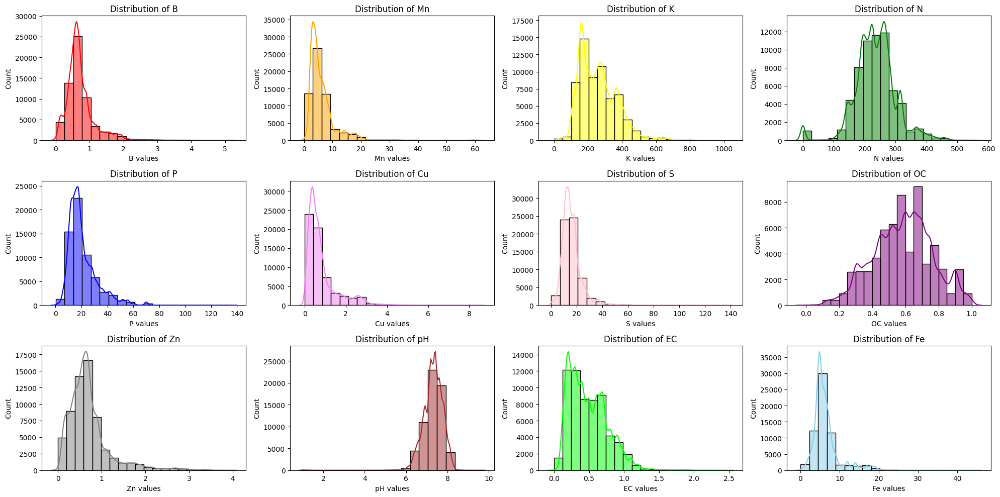

Total districts : 45
MADHYA PRADESH_2023.csv:: No. of samples reduced from 85367 to 62575
Before z-score
B min and max values :  Min = 0.0, Max = 402.0
Mn min and max values :  Min = 0.01, Max = 160.11
K min and max values :  Min = 0.43, Max = 18020.0
N min and max values :  Min = 1.03, Max = 5552.8
P min and max values :  Min = 0.62, Max = 915.0
Cu min and max values :  Min = 0.0, Max = 129.36
S min and max values :  Min = 0.003, Max = 4075.0
OC min and max values :  Min = 0.0, Max = 540.0
Zn min and max values :  Min = -1.0, Max = 122.0
pH min and max values :  Min = 0.29, Max = 3081.0
EC min and max values :  Min = 0.0, Max = 60.026
Fe min and max values :  Min = -133.8, Max = 545.3


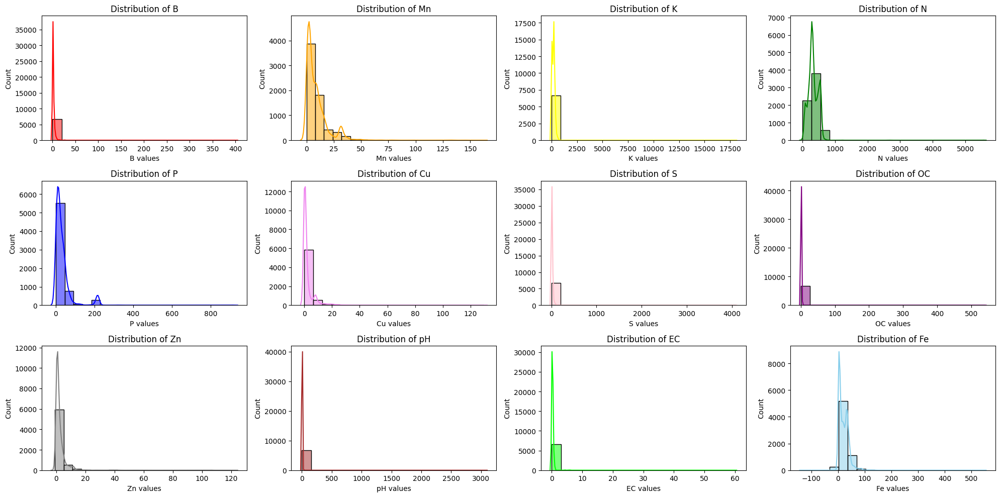

/tmp/ipykernel_19888/1435975282.py:30: FutureWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  df = df.groupby("district", group_keys=False).apply(apply_z_filter)


After z-score
B min and max values :  Min = 0.02, Max = 9.79
Mn min and max values :  Min = 0.01, Max = 26.99
K min and max values :  Min = 1.02, Max = 710.0
N min and max values :  Min = 37.62, Max = 583.1
P min and max values :  Min = 0.73, Max = 104.5
Cu min and max values :  Min = 0.014, Max = 27.87
S min and max values :  Min = 0.004, Max = 96.17
OC min and max values :  Min = 0.014, Max = 1.0
Zn min and max values :  Min = 0.008, Max = 28.1
pH min and max values :  Min = 3.23, Max = 7.5
EC min and max values :  Min = 0.00016, Max = 1.091
Fe min and max values :  Min = 0.08, Max = 54.9


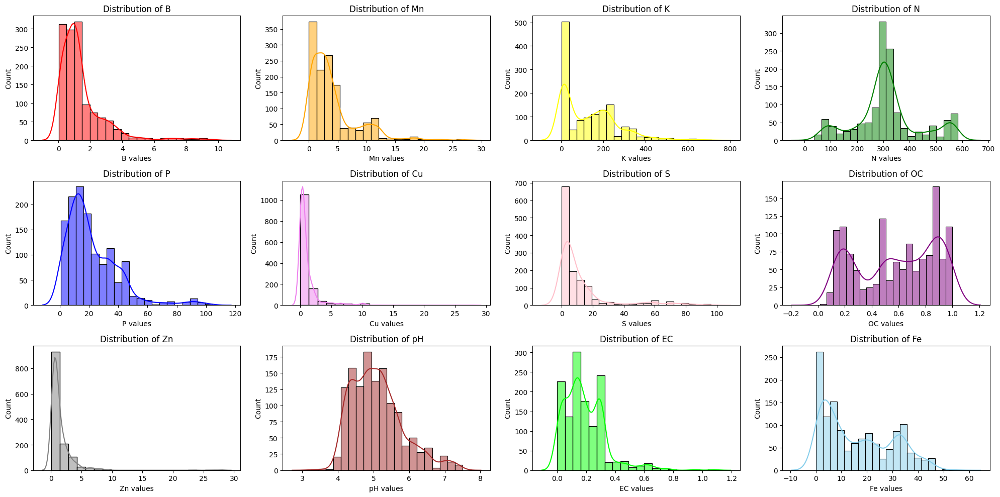

Total districts : 8
NAGALAND_2023.csv:: No. of samples reduced from 6667 to 1310
Before z-score
B min and max values :  Min = 0.0, Max = 40.2
Mn min and max values :  Min = 0.19, Max = 1340.0
K min and max values :  Min = 0.215, Max = 8236.09
N min and max values :  Min = 0.23, Max = 15052.0
P min and max values :  Min = 0.0, Max = 56448.0
Cu min and max values :  Min = -1.3, Max = 1328.0
S min and max values :  Min = 0.0, Max = 425.0
OC min and max values :  Min = 0.0, Max = 123.8
Zn min and max values :  Min = 0.01, Max = 1772.0
pH min and max values :  Min = -17.5, Max = 7373.0
EC min and max values :  Min = 0.0, Max = 38.0
Fe min and max values :  Min = 0.07, Max = 411.0


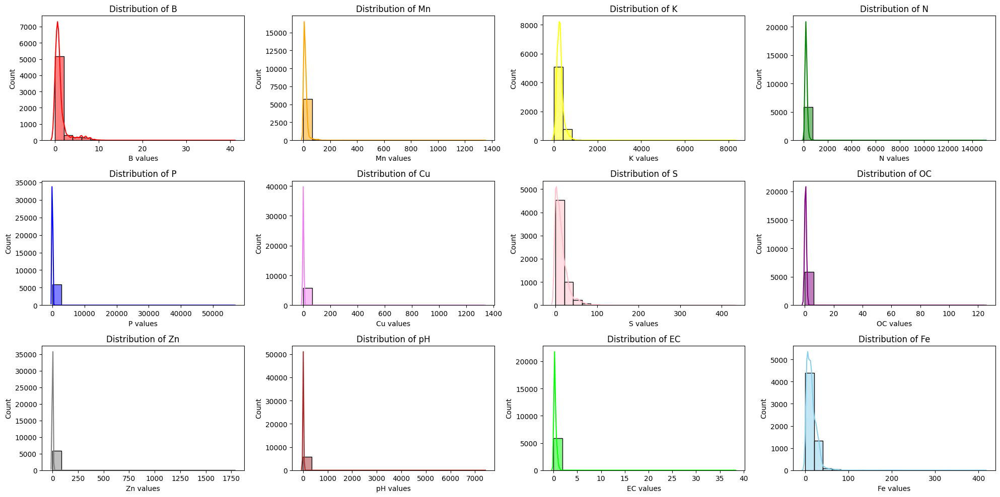

/tmp/ipykernel_19888/1435975282.py:30: FutureWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  df = df.groupby("district", group_keys=False).apply(apply_z_filter)


After z-score
B min and max values :  Min = 0.0, Max = 11.0
Mn min and max values :  Min = 0.19, Max = 112.32
K min and max values :  Min = 3.47, Max = 957.6
N min and max values :  Min = 0.78, Max = 539.0
P min and max values :  Min = 0.0, Max = 68.992
Cu min and max values :  Min = 0.0, Max = 7.612
S min and max values :  Min = 0.0, Max = 106.25
OC min and max values :  Min = 0.0, Max = 1.0
Zn min and max values :  Min = 0.019, Max = 4.002
pH min and max values :  Min = 3.77, Max = 8.49
EC min and max values :  Min = 0.03, Max = 1.497
Fe min and max values :  Min = 0.11, Max = 85.64


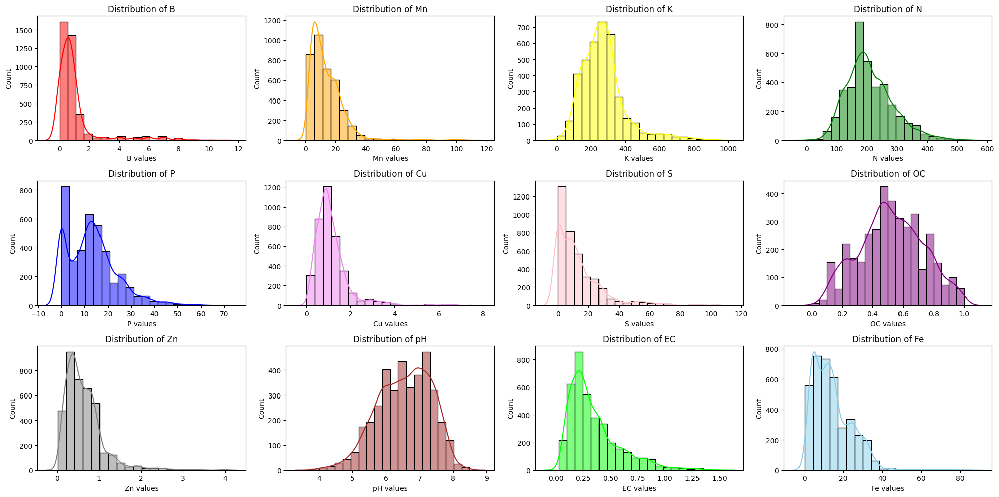

Total districts : 22
CHHATTISGARH_2023.csv:: No. of samples reduced from 5881 to 3806
Before z-score
B min and max values :  Min = 0.0, Max = 6.07
Mn min and max values :  Min = 0.16, Max = 27.87
K min and max values :  Min = 2.24, Max = 809.12
N min and max values :  Min = 0.35, Max = 802.82
P min and max values :  Min = 0.93, Max = 1232.0
Cu min and max values :  Min = -2.0, Max = 1.8
S min and max values :  Min = 0.0, Max = 38.9
OC min and max values :  Min = 0.11, Max = 4.8
Zn min and max values :  Min = 0.01, Max = 66.0
pH min and max values :  Min = 0.15, Max = 6.9
EC min and max values :  Min = 0.031, Max = 0.89
Fe min and max values :  Min = 0.04, Max = 1486.0


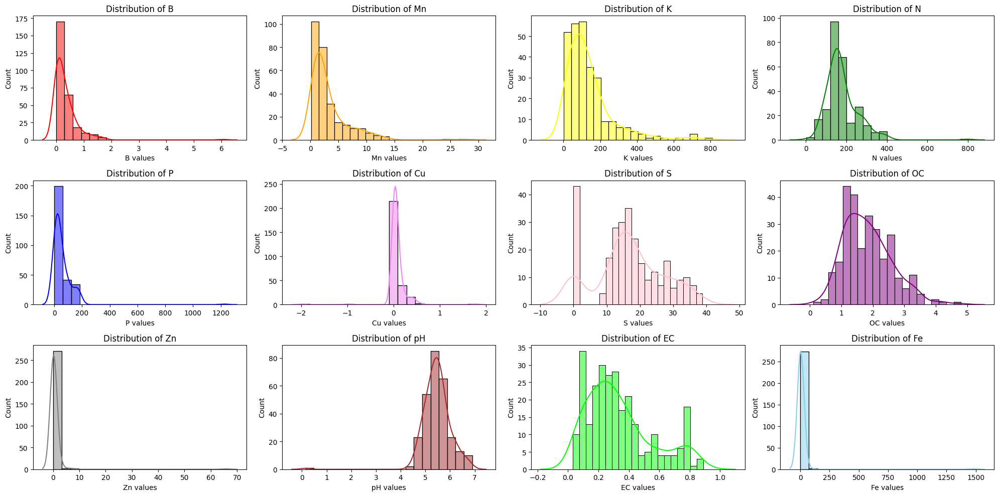

/tmp/ipykernel_19888/1435975282.py:30: FutureWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  df = df.groupby("district", group_keys=False).apply(apply_z_filter)


After z-score
B min and max values :  Min = 0.0, Max = 0.47
Mn min and max values :  Min = 0.35, Max = 11.196
K min and max values :  Min = 17.92, Max = 189.16
N min and max values :  Min = 75.2, Max = 301.05
P min and max values :  Min = 1.12, Max = 110.88
Cu min and max values :  Min = 0.004, Max = 0.458
S min and max values :  Min = 0.0, Max = 32.17
OC min and max values :  Min = 0.11, Max = 0.96
Zn min and max values :  Min = 0.032, Max = 1.2
pH min and max values :  Min = 4.9, Max = 6.17
EC min and max values :  Min = 0.09, Max = 0.4
Fe min and max values :  Min = 0.72, Max = 22.38


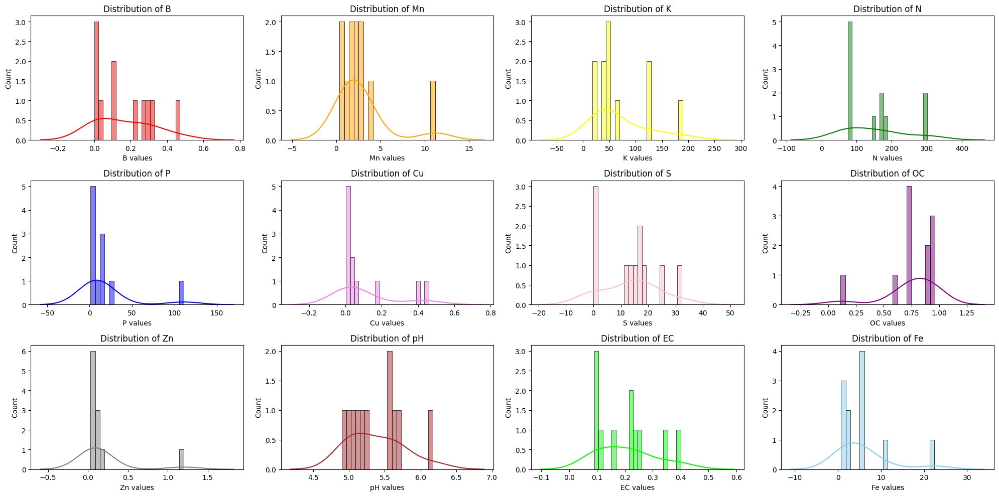

Total districts : 4
MEGHALAYA_2023.csv:: No. of samples reduced from 276 to 11
GUJARAT_2023.csv does not contain any records
PUDUCHERRY_2023.csv does not contain any records
Before z-score
B min and max values :  Min = 0.0, Max = 0.0
Mn min and max values :  Min = 0.69, Max = 2.73
K min and max values :  Min = 13.66, Max = 212.44
N min and max values :  Min = 0.0, Max = 0.0
P min and max values :  Min = 7.06, Max = 36.44
Cu min and max values :  Min = 0.7, Max = 2.15
S min and max values :  Min = 10.94, Max = 21.92
OC min and max values :  Min = 0.19, Max = 0.54
Zn min and max values :  Min = 0.88, Max = 98.0
pH min and max values :  Min = 6.9, Max = 8.7
EC min and max values :  Min = 0.17, Max = 69.0
Fe min and max values :  Min = 2.58, Max = 40.6


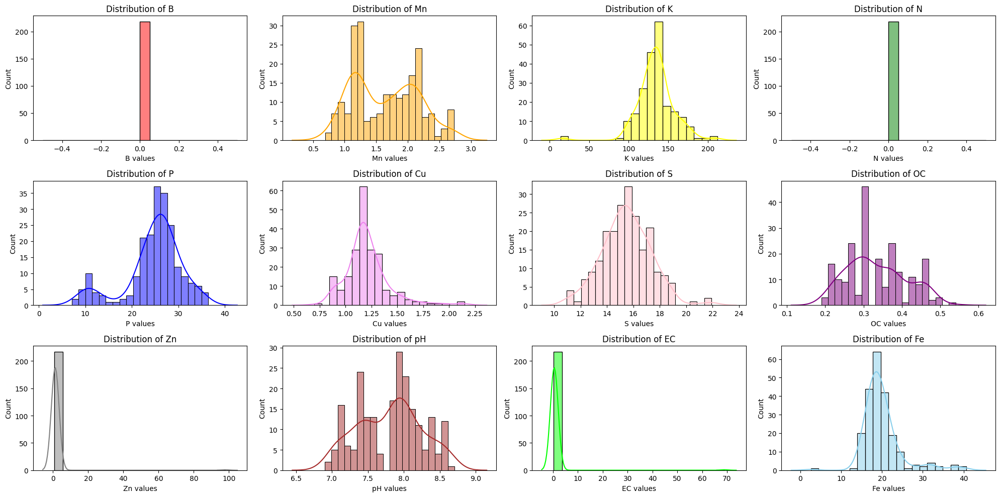

/tmp/ipykernel_19888/1435975282.py:30: FutureWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  df = df.groupby("district", group_keys=False).apply(apply_z_filter)


After z-score
B min and max values :  Min = 0.0, Max = 0.0
Mn min and max values :  Min = 0.84, Max = 2.73
K min and max values :  Min = 96.84, Max = 174.06
N min and max values :  Min = 0.0, Max = 0.0
P min and max values :  Min = 18.73, Max = 35.37
Cu min and max values :  Min = 0.86, Max = 1.53
S min and max values :  Min = 10.94, Max = 18.94
OC min and max values :  Min = 0.19, Max = 0.49
Zn min and max values :  Min = 0.89, Max = 1.6
pH min and max values :  Min = 6.9, Max = 8.7
EC min and max values :  Min = 0.2, Max = 0.75
Fe min and max values :  Min = 14.43, Max = 24.94


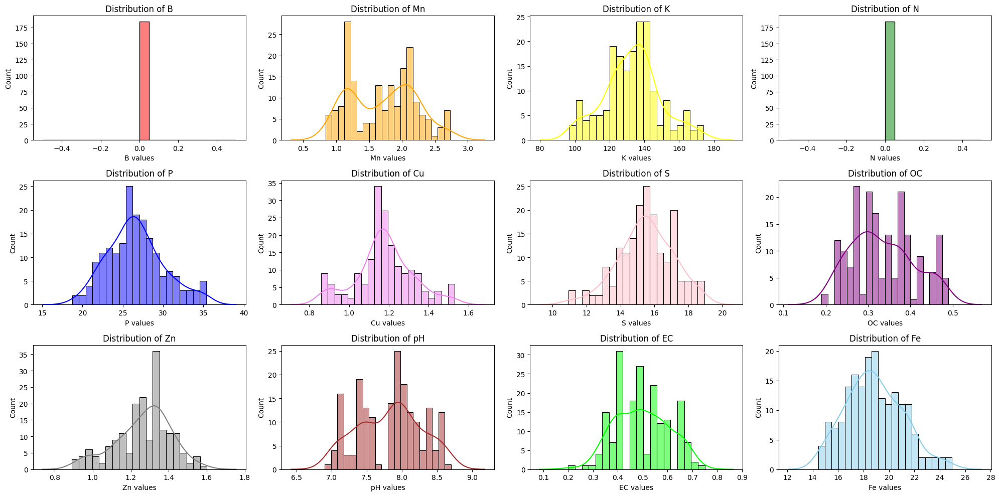

Total districts : 1
HARYANA_2023.csv:: No. of samples reduced from 218 to 184
Before z-score
B min and max values :  Min = 0.0, Max = 710.0
Mn min and max values :  Min = 0.0, Max = 4016.0
K min and max values :  Min = 0.0, Max = 8064.0
N min and max values :  Min = 0.0, Max = 2963.57
P min and max values :  Min = 0.0, Max = 23060.0
Cu min and max values :  Min = 0.0, Max = 170.1
S min and max values :  Min = 0.0, Max = 360.0
OC min and max values :  Min = 0.003, Max = 2549.0
Zn min and max values :  Min = 0.0, Max = 808.0
pH min and max values :  Min = 2.2, Max = 8.56
EC min and max values :  Min = 0.01, Max = 21.0
Fe min and max values :  Min = -0.01, Max = 221.02


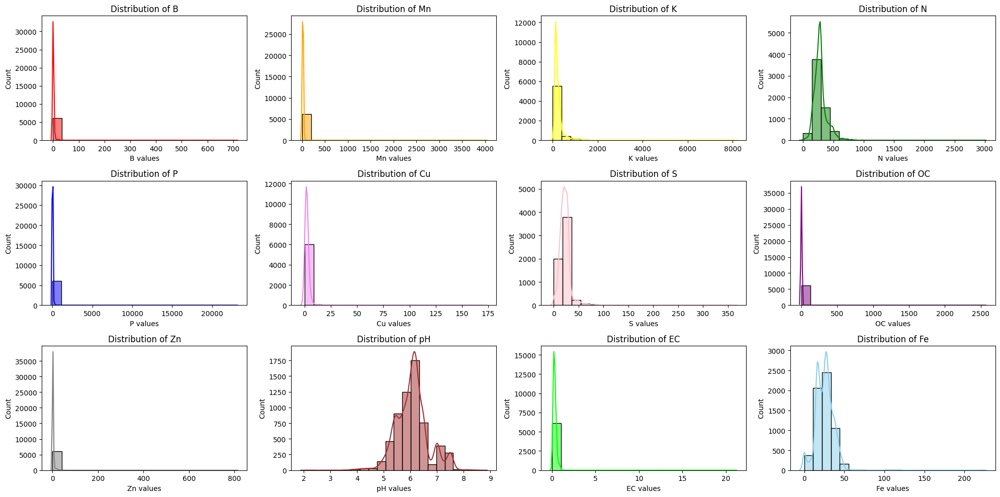

/tmp/ipykernel_19888/1435975282.py:30: FutureWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  df = df.groupby("district", group_keys=False).apply(apply_z_filter)


After z-score
B min and max values :  Min = 0.0, Max = 3.887
Mn min and max values :  Min = 0.0, Max = 70.57
K min and max values :  Min = 0.0, Max = 1176.0
N min and max values :  Min = 0.0, Max = 534.0
P min and max values :  Min = 0.0, Max = 146.8
Cu min and max values :  Min = 0.0, Max = 12.46
S min and max values :  Min = 0.0, Max = 43.32
OC min and max values :  Min = 0.003, Max = 1.0
Zn min and max values :  Min = 0.0, Max = 19.9
pH min and max values :  Min = 2.2, Max = 8.56
EC min and max values :  Min = 0.01, Max = 0.99
Fe min and max values :  Min = 0.0, Max = 52.1


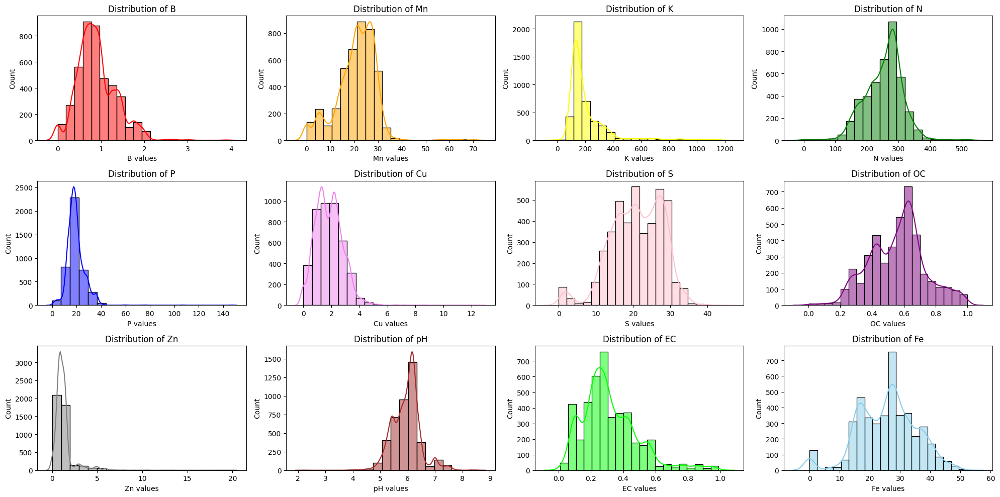

Total districts : 9
JHARKHAND_2023.csv:: No. of samples reduced from 6112 to 4298
.ipynb_checkpoints does not contain any records
Before z-score
B min and max values :  Min = 0.00463, Max = 1111.26
Mn min and max values :  Min = 0.07, Max = 16091.0
K min and max values :  Min = 0.285264, Max = 23666.45
N min and max values :  Min = -50.20108799999999, Max = 2666.0
P min and max values :  Min = 0.008, Max = 2522.0
Cu min and max values :  Min = 0.01, Max = 2020.0
S min and max values :  Min = 0.23, Max = 1000.384
OC min and max values :  Min = 0.0, Max = 893.65
Zn min and max values :  Min = 0.005, Max = 1014.0
pH min and max values :  Min = 0.37, Max = 70.56
EC min and max values :  Min = 0.0, Max = 71.0
Fe min and max values :  Min = 0.2, Max = 11068.0


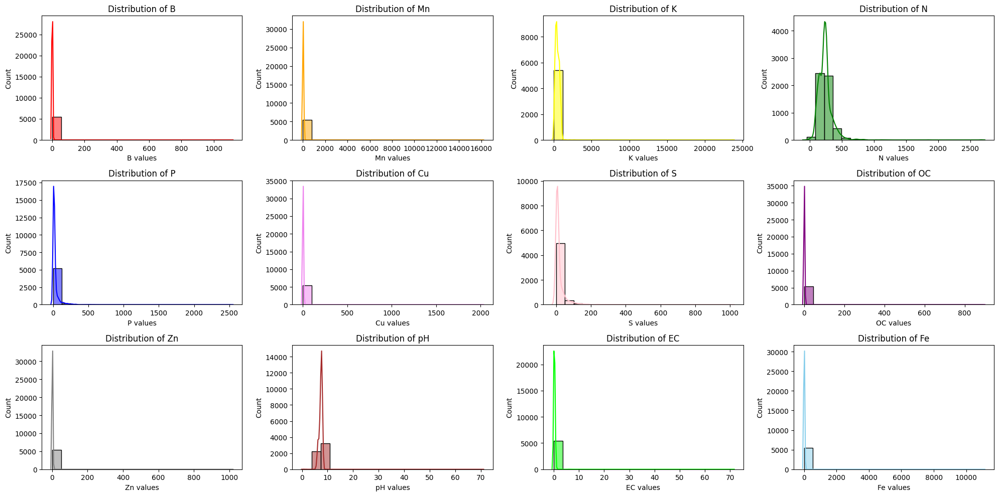

/home/aakash01/Documents/shc/venv/lib/python3.10/site-packages/numpy/_core/fromnumeric.py:3860: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/aakash01/Documents/shc/venv/lib/python3.10/site-packages/numpy/_core/_methods.py:145: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/tmp/ipykernel_19888/1435975282.py:30: FutureWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  df = df.groupby("district", group_keys=False).apply(apply_z_filter)


After z-score
B min and max values :  Min = 0.00463, Max = 10.0
Mn min and max values :  Min = 0.07, Max = 133.9
K min and max values :  Min = 0.47544, Max = 1166.26
N min and max values :  Min = 2.5, Max = 534.6415872
P min and max values :  Min = 0.008, Max = 110.648832
Cu min and max values :  Min = 0.08, Max = 9.73
S min and max values :  Min = 0.638, Max = 105.27
OC min and max values :  Min = 0.012, Max = 1.0
Zn min and max values :  Min = 0.033, Max = 55.0
pH min and max values :  Min = 1.56, Max = 8.98
EC min and max values :  Min = 0.0, Max = 0.963
Fe min and max values :  Min = 0.2, Max = 56.64


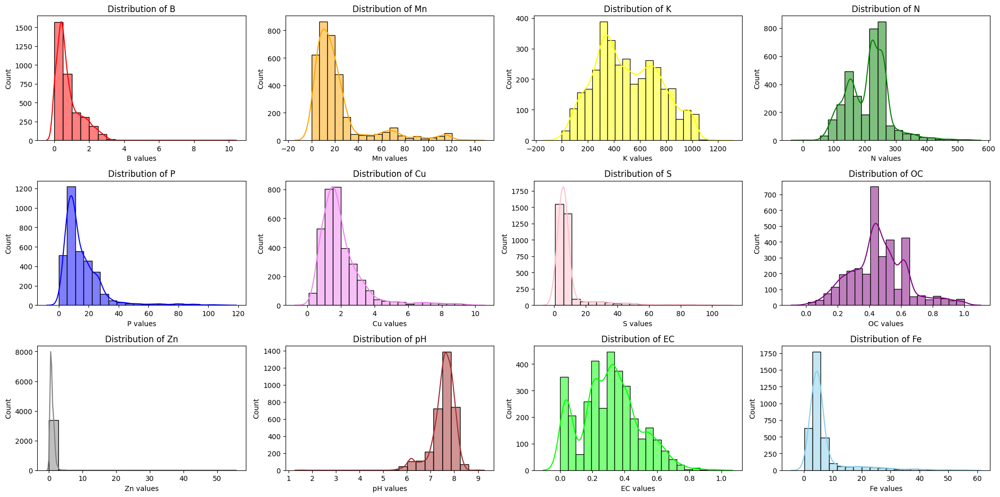

Total districts : 13
MAHARASHTRA_2023.csv:: No. of samples reduced from 5437 to 3400
Before z-score
B min and max values :  Min = 0.0, Max = 575.0
Mn min and max values :  Min = 0.03, Max = 696.0
K min and max values :  Min = 0.36, Max = 2912.0
N min and max values :  Min = 0.336, Max = 5625.0
P min and max values :  Min = 0.9, Max = 1755.0
Cu min and max values :  Min = 0.009, Max = 39.0
S min and max values :  Min = 0.0, Max = 142.37
OC min and max values :  Min = 0.04, Max = 85.5
Zn min and max values :  Min = 0.0, Max = 282.0
pH min and max values :  Min = -17.8, Max = 703.0
EC min and max values :  Min = 0.0027, Max = 803.0
Fe min and max values :  Min = 0.0, Max = 61.97


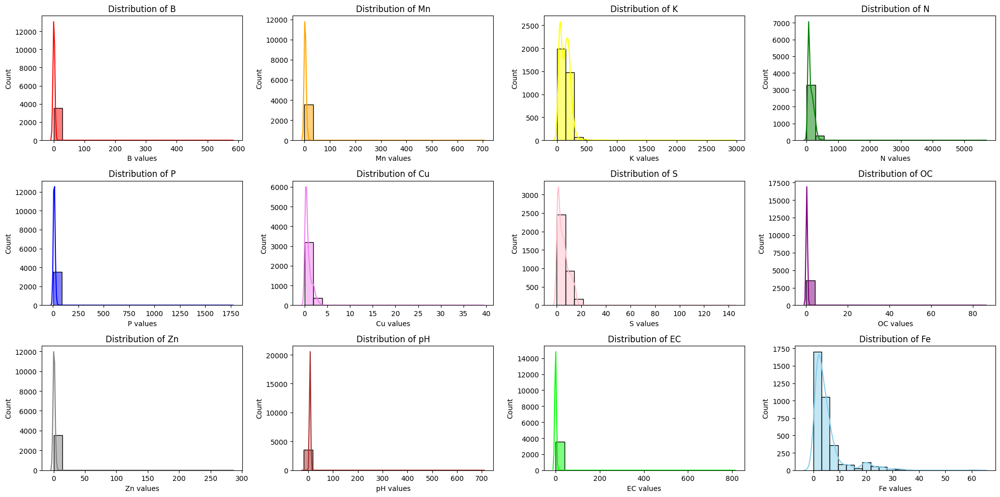

/tmp/ipykernel_19888/1435975282.py:30: FutureWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  df = df.groupby("district", group_keys=False).apply(apply_z_filter)


After z-score
B min and max values :  Min = 0.0, Max = 3.85
Mn min and max values :  Min = 0.03, Max = 13.84
K min and max values :  Min = 0.36, Max = 392.0
N min and max values :  Min = 0.84, Max = 487.0
P min and max values :  Min = 0.9, Max = 40.5
Cu min and max values :  Min = 0.009, Max = 3.25
S min and max values :  Min = 0.13, Max = 18.86
OC min and max values :  Min = 0.06, Max = 0.87
Zn min and max values :  Min = 0.0, Max = 4.29
pH min and max values :  Min = 4.0, Max = 9.5
EC min and max values :  Min = 0.0027, Max = 0.98
Fe min and max values :  Min = 0.03, Max = 34.96


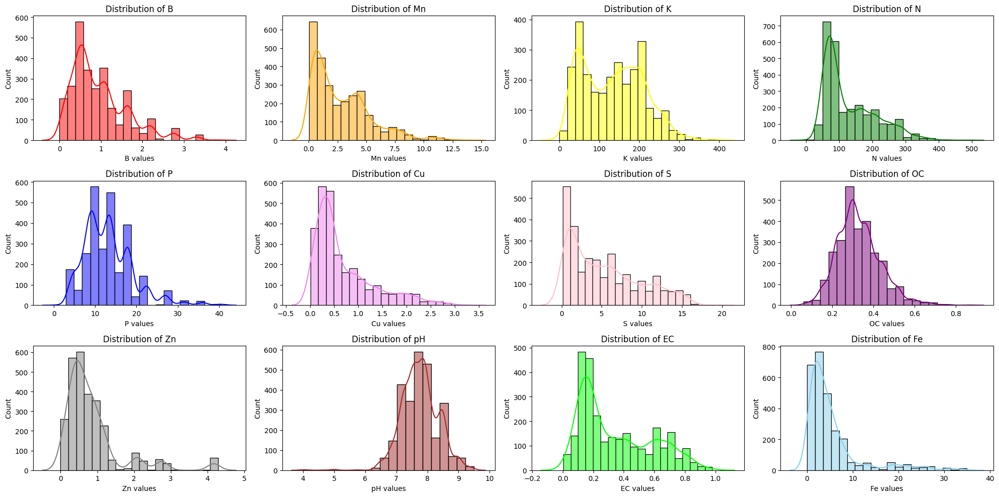

Total districts : 7
UTTAR PRADESH_2023.csv:: No. of samples reduced from 3560 to 2768
Before z-score
B min and max values :  Min = -1.0, Max = 99999.0
Mn min and max values :  Min = 0.0, Max = 5015.0
K min and max values :  Min = 0.0, Max = 299357.0
N min and max values :  Min = 0.0, Max = 639639.4
P min and max values :  Min = 0.0, Max = 44020.0
Cu min and max values :  Min = -2.0, Max = 400.0
S min and max values :  Min = 0.0, Max = 8929.0
OC min and max values :  Min = -1.0, Max = 3033.0
Zn min and max values :  Min = -1.0, Max = 564.0
pH min and max values :  Min = -17.4, Max = 9029.0
EC min and max values :  Min = -1.0, Max = 18447.0
Fe min and max values :  Min = 0.0, Max = 6169.0


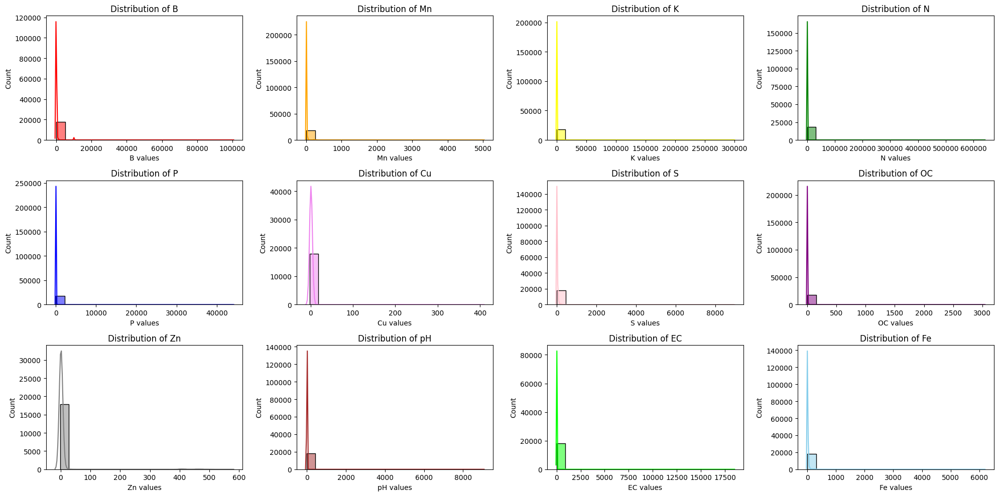

/home/aakash01/Documents/shc/venv/lib/python3.10/site-packages/numpy/_core/fromnumeric.py:3860: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/aakash01/Documents/shc/venv/lib/python3.10/site-packages/numpy/_core/_methods.py:145: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/tmp/ipykernel_19888/1435975282.py:30: FutureWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  df = df.groupby("district", group_keys=False).apply(apply_z_filter)


After z-score
B min and max values :  Min = 0.0, Max = 5.36
Mn min and max values :  Min = 0.0, Max = 22.9
K min and max values :  Min = 3.29, Max = 630.7
N min and max values :  Min = 0.1232, Max = 736.7
P min and max values :  Min = 0.75, Max = 174.7
Cu min and max values :  Min = 0.0, Max = 4.33
S min and max values :  Min = 0.0, Max = 168.74
OC min and max values :  Min = 0.0, Max = 1.0
Zn min and max values :  Min = 0.0, Max = 6.31
pH min and max values :  Min = 1.02, Max = 8.8
EC min and max values :  Min = 0.01, Max = 2.4
Fe min and max values :  Min = 0.04, Max = 40.35


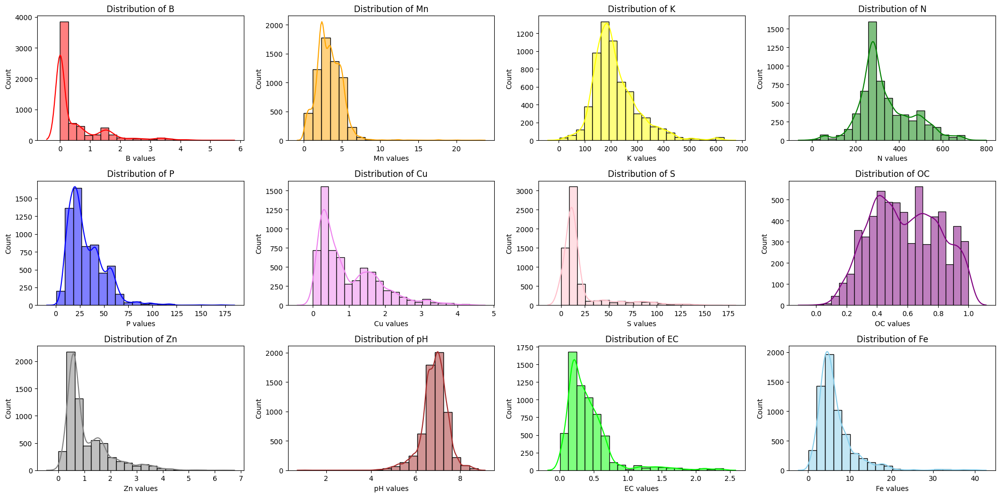

Total districts : 17
JAMMU & KASHMIR_2023.csv:: No. of samples reduced from 18071 to 6245
Before z-score
B min and max values :  Min = 0.11, Max = 66.48
Mn min and max values :  Min = 0.17, Max = 36.6
K min and max values :  Min = 0.56, Max = 428.0
N min and max values :  Min = 0.29, Max = 560.0
P min and max values :  Min = 0.39, Max = 290.0
Cu min and max values :  Min = 0.0, Max = 39.16
S min and max values :  Min = 0.09, Max = 1402.0
OC min and max values :  Min = 0.03, Max = 290.0
Zn min and max values :  Min = 0.0, Max = 189.01
pH min and max values :  Min = 3.14, Max = 7.9
EC min and max values :  Min = 0.01, Max = 20.09
Fe min and max values :  Min = 0.22, Max = 45.0


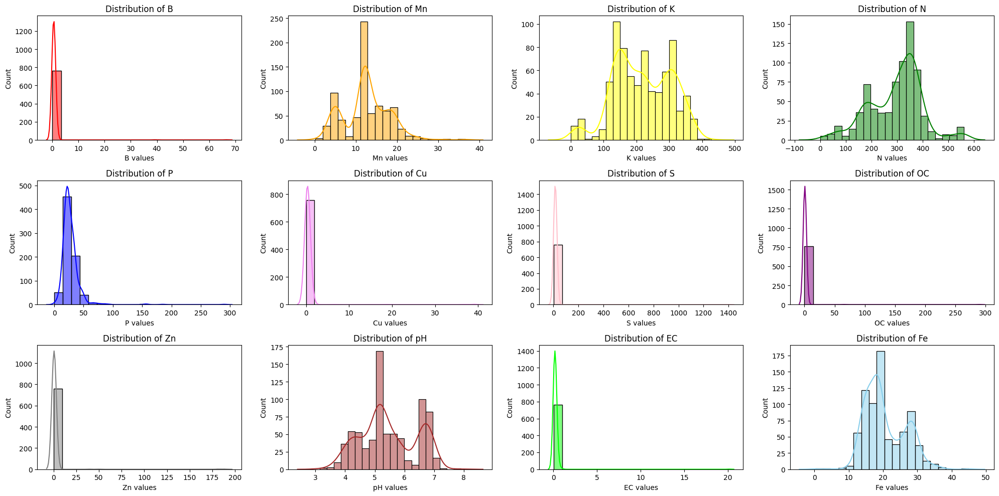

/tmp/ipykernel_19888/1435975282.py:30: FutureWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  df = df.groupby("district", group_keys=False).apply(apply_z_filter)


After z-score
B min and max values :  Min = 0.25, Max = 1.86
Mn min and max values :  Min = 2.61, Max = 27.0
K min and max values :  Min = 0.56, Max = 386.0
N min and max values :  Min = 17.0, Max = 560.0
P min and max values :  Min = 4.9, Max = 76.02
Cu min and max values :  Min = 0.1, Max = 0.93
S min and max values :  Min = 0.61, Max = 23.08
OC min and max values :  Min = 0.03, Max = 0.99
Zn min and max values :  Min = 0.03, Max = 0.99
pH min and max values :  Min = 3.59, Max = 7.35
EC min and max values :  Min = 0.01, Max = 0.52
Fe min and max values :  Min = 9.16, Max = 35.6


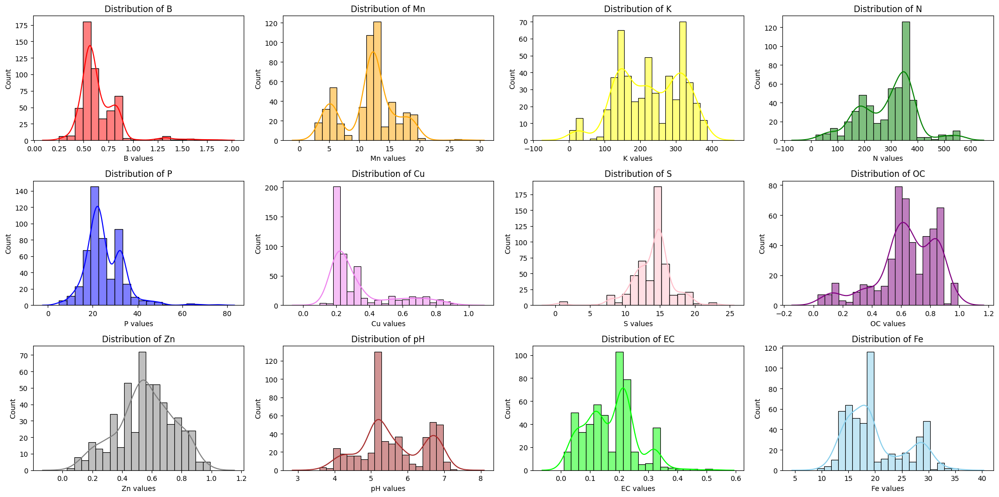

Total districts : 5
TRIPURA_2023.csv:: No. of samples reduced from 764 to 515
Before z-score
B min and max values :  Min = -2.0, Max = 6666660.8
Mn min and max values :  Min = -2.46, Max = 10568.0
K min and max values :  Min = 0.0, Max = 1145775.0
N min and max values :  Min = -1210.0, Max = 130126.0
P min and max values :  Min = 0.0, Max = 21386.0
Cu min and max values :  Min = -3.0, Max = 2418.0
S min and max values :  Min = -15.21, Max = 24468.0
OC min and max values :  Min = -10.15, Max = 1470.29
Zn min and max values :  Min = -1.311, Max = 9524.0
pH min and max values :  Min = -36.69, Max = 8382.0
EC min and max values :  Min = -10.31, Max = 941.0
Fe min and max values :  Min = -19.67, Max = 40661.0


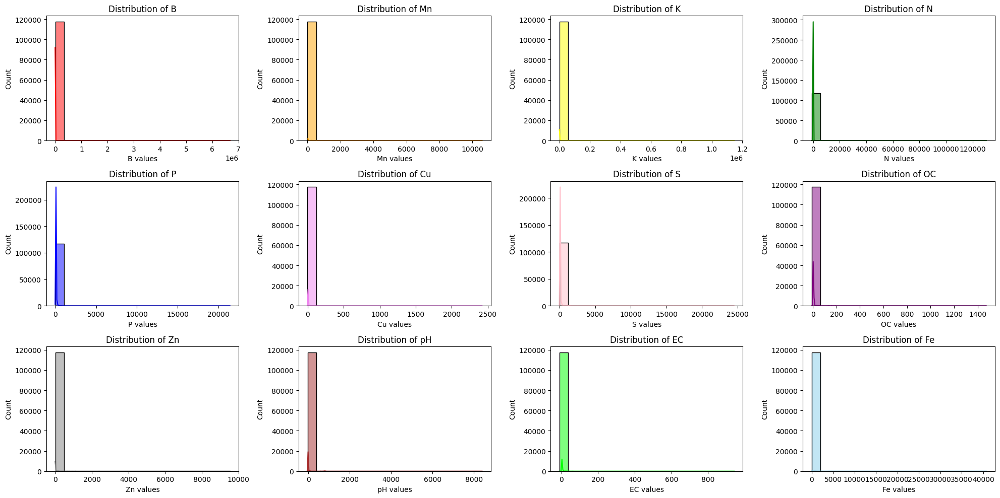

/tmp/ipykernel_19888/1435975282.py:30: FutureWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  df = df.groupby("district", group_keys=False).apply(apply_z_filter)


After z-score
B min and max values :  Min = 0.0, Max = 10.0
Mn min and max values :  Min = 0.01, Max = 26.1
K min and max values :  Min = 0.0, Max = 1252.0
N min and max values :  Min = 0.133, Max = 452.0
P min and max values :  Min = 0.0, Max = 171.0
Cu min and max values :  Min = 0.0, Max = 6.19
S min and max values :  Min = 0.0, Max = 397.0
OC min and max values :  Min = 0.0, Max = 1.0
Zn min and max values :  Min = 0.0, Max = 4.16
pH min and max values :  Min = 1.59, Max = 10.0
EC min and max values :  Min = 0.0, Max = 1.46
Fe min and max values :  Min = 0.0, Max = 26.02


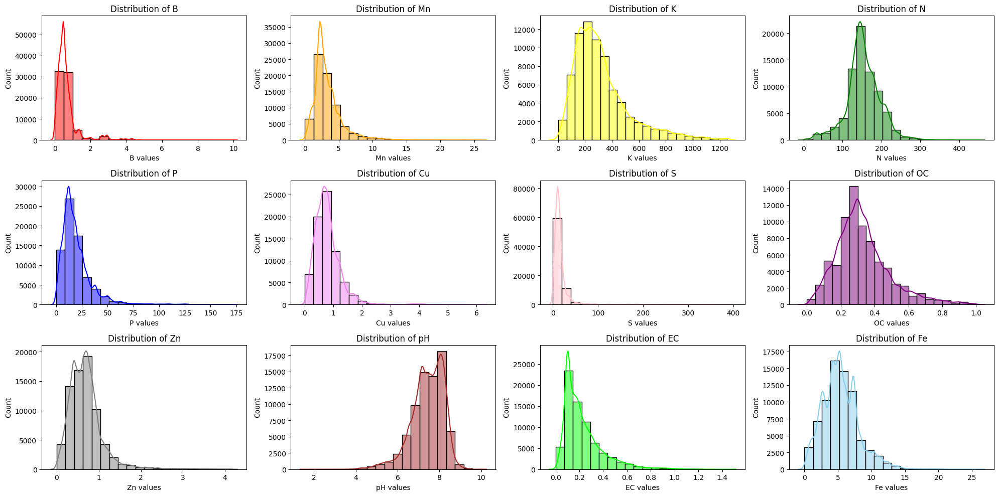

Total districts : 37
TAMIL NADU_2023.csv:: No. of samples reduced from 117509 to 74019
Before z-score
B min and max values :  Min = 0.03, Max = 0.03
Mn min and max values :  Min = 3.8, Max = 3.8
K min and max values :  Min = 9.8, Max = 9.8
N min and max values :  Min = 553.0, Max = 553.0
P min and max values :  Min = 0.206, Max = 0.206
Cu min and max values :  Min = 0.38, Max = 0.38
S min and max values :  Min = 1.086, Max = 1.086
OC min and max values :  Min = 0.79, Max = 0.79
Zn min and max values :  Min = 0.66, Max = 0.66
pH min and max values :  Min = 6.02, Max = 6.02
EC min and max values :  Min = 0.032, Max = 0.032
Fe min and max values :  Min = 3.5, Max = 3.5


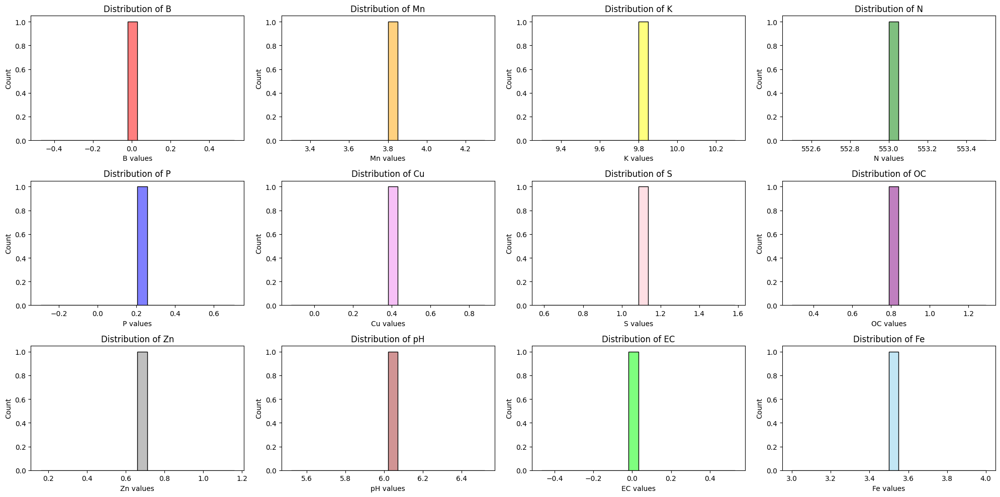

/tmp/ipykernel_19888/1435975282.py:30: FutureWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  df = df.groupby("district", group_keys=False).apply(apply_z_filter)


After z-score
B min and max values :  Min = 0.03, Max = 0.03
Mn min and max values :  Min = 3.8, Max = 3.8
K min and max values :  Min = 9.8, Max = 9.8
N min and max values :  Min = 553.0, Max = 553.0
P min and max values :  Min = 0.206, Max = 0.206
Cu min and max values :  Min = 0.38, Max = 0.38
S min and max values :  Min = 1.086, Max = 1.086
OC min and max values :  Min = 0.79, Max = 0.79
Zn min and max values :  Min = 0.66, Max = 0.66
pH min and max values :  Min = 6.02, Max = 6.02
EC min and max values :  Min = 0.032, Max = 0.032
Fe min and max values :  Min = 3.5, Max = 3.5


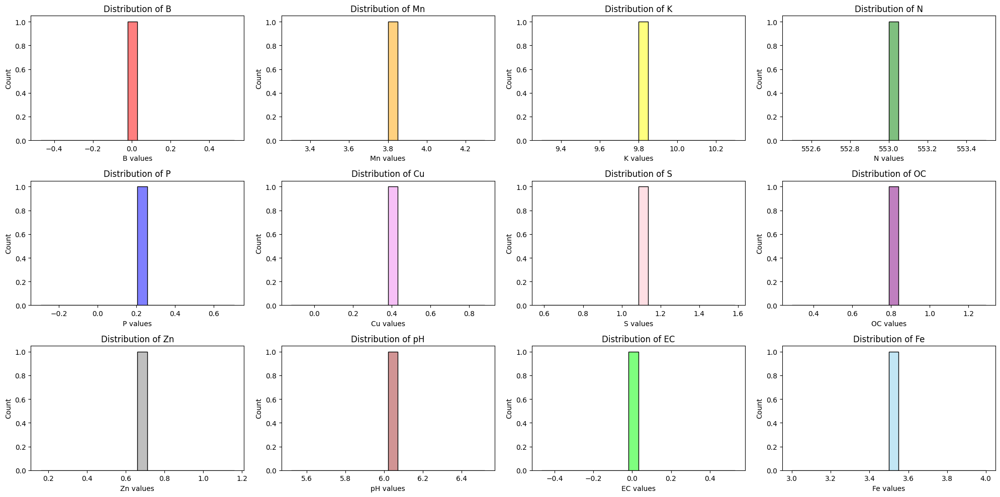

Total districts : 1
ARUNACHAL PRADESH_2023.csv:: No. of samples reduced from 1 to 1
ASSAM_2023.csv does not contain any records
Before z-score
B min and max values :  Min = 0.0, Max = 1.0
Mn min and max values :  Min = 0.0, Max = 24.12
K min and max values :  Min = 0.0, Max = 385.0
N min and max values :  Min = 0.0, Max = 778.0
P min and max values :  Min = 0.0, Max = 247.17
Cu min and max values :  Min = -2.0, Max = 8.18
S min and max values :  Min = 0.0, Max = 36.0
OC min and max values :  Min = 0.0, Max = 2.42
Zn min and max values :  Min = -2.0, Max = 3.08
pH min and max values :  Min = 4.58, Max = 7.34
EC min and max values :  Min = 0.0, Max = 0.87
Fe min and max values :  Min = -2.0, Max = 34.82


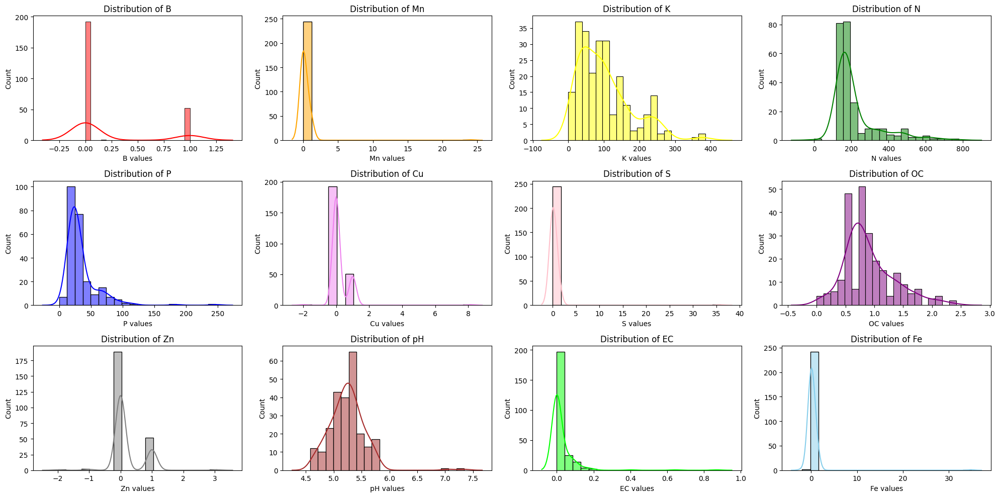

/tmp/ipykernel_19888/1435975282.py:30: FutureWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  df = df.groupby("district", group_keys=False).apply(apply_z_filter)


After z-score
B min and max values :  Min = 0.0, Max = 1.0
Mn min and max values :  Min = 0.0, Max = 24.12
K min and max values :  Min = 0.0, Max = 385.0
N min and max values :  Min = 0.0, Max = 614.0
P min and max values :  Min = 0.0, Max = 110.0
Cu min and max values :  Min = 0.0, Max = 8.18
S min and max values :  Min = 0.0, Max = 36.0
OC min and max values :  Min = 0.0, Max = 0.98
Zn min and max values :  Min = 0.0, Max = 3.08
pH min and max values :  Min = 4.58, Max = 7.34
EC min and max values :  Min = 0.0, Max = 0.643
Fe min and max values :  Min = 0.0, Max = 34.82


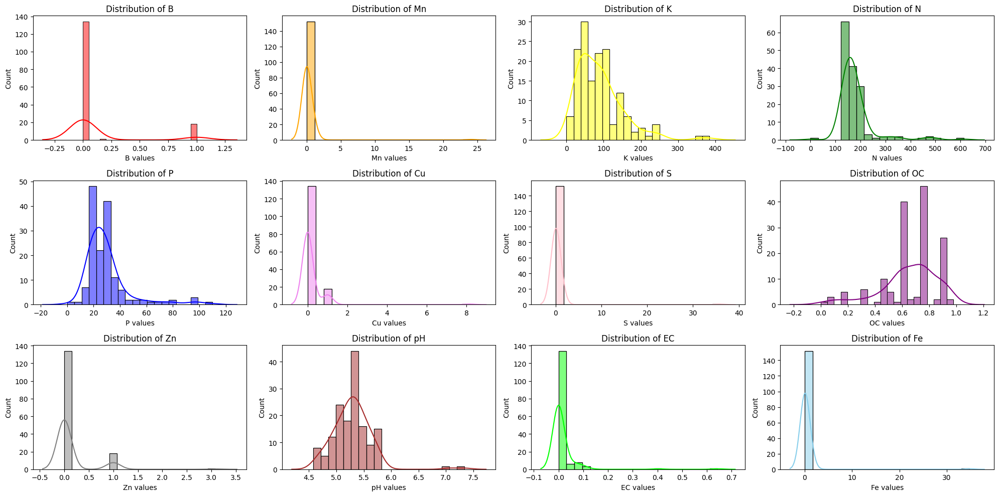

Total districts : 3
MIZORAM_2023.csv:: No. of samples reduced from 245 to 153
Before z-score
B min and max values :  Min = 0.0, Max = 47.34
Mn min and max values :  Min = 0.0, Max = 1591.04
K min and max values :  Min = 1.0, Max = 1003.0
N min and max values :  Min = 0.0, Max = 24012.000000000004
P min and max values :  Min = 0.37, Max = 321.14
Cu min and max values :  Min = 0.0, Max = 164.0
S min and max values :  Min = 0.0, Max = 442.71
OC min and max values :  Min = 0.0, Max = 36.0
Zn min and max values :  Min = 0.0, Max = 57.34
pH min and max values :  Min = 0.69, Max = 609.0
EC min and max values :  Min = 0.001, Max = 6.13
Fe min and max values :  Min = 0.0, Max = 544.0


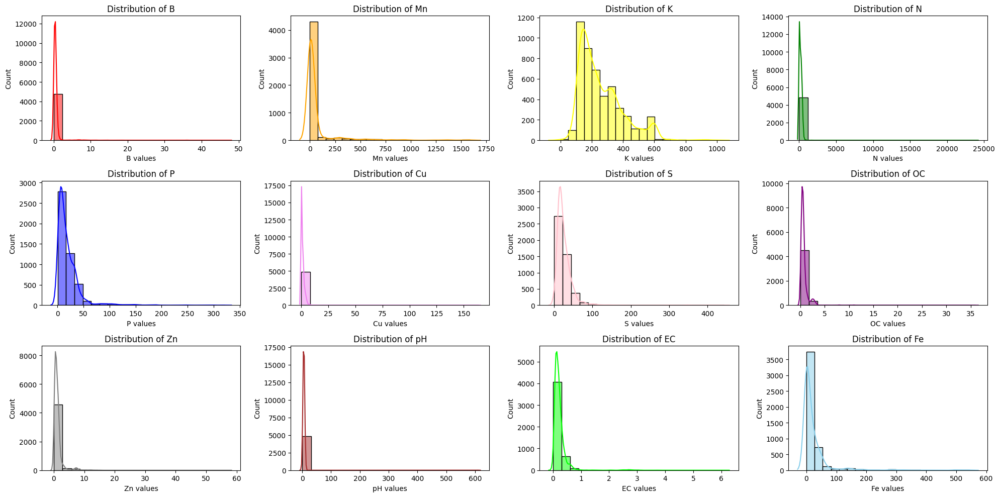

/tmp/ipykernel_19888/1435975282.py:30: FutureWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  df = df.groupby("district", group_keys=False).apply(apply_z_filter)


After z-score
B min and max values :  Min = 0.0, Max = 8.0
Mn min and max values :  Min = 0.0, Max = 324.32
K min and max values :  Min = 1.0, Max = 625.0
N min and max values :  Min = 0.0, Max = 653.66
P min and max values :  Min = 1.0, Max = 75.0
Cu min and max values :  Min = 0.0, Max = 9.33
S min and max values :  Min = 0.0, Max = 80.62
OC min and max values :  Min = 0.01, Max = 1.0
Zn min and max values :  Min = 0.0, Max = 3.302
pH min and max values :  Min = 1.0, Max = 7.95
EC min and max values :  Min = 0.01, Max = 1.0
Fe min and max values :  Min = 0.0, Max = 95.25


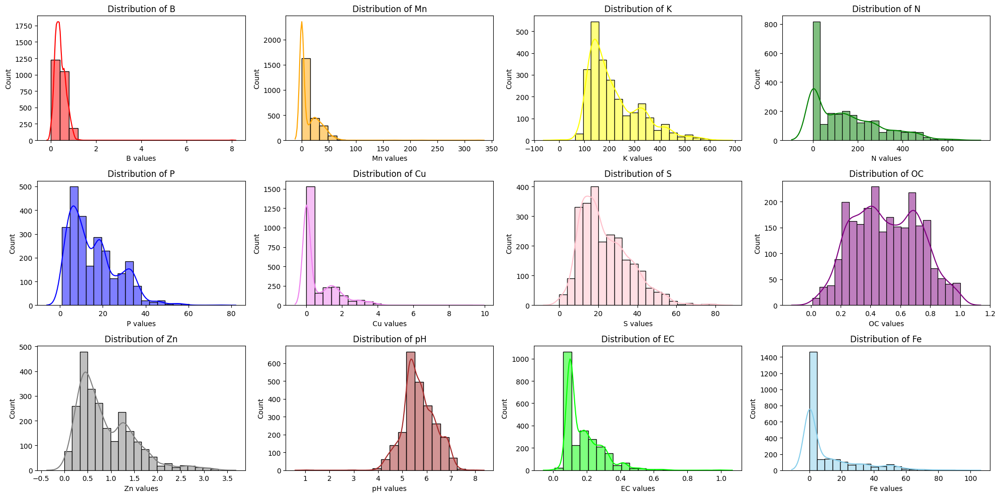

Total districts : 18
ODISHA_2023.csv:: No. of samples reduced from 4844 to 2468
Before z-score
B min and max values :  Min = 0.0, Max = 2097.0
Mn min and max values :  Min = 0.0, Max = 80968.0
K min and max values :  Min = 0.0, Max = 11423.0
N min and max values :  Min = -1314.0, Max = 222222239.4
P min and max values :  Min = -95.5, Max = 8976.0
Cu min and max values :  Min = -2.0, Max = 10450.0
S min and max values :  Min = -12.0, Max = 129639.0
OC min and max values :  Min = -1.0, Max = 1065.0
Zn min and max values :  Min = -213.99, Max = 1496.0
pH min and max values :  Min = -28.2, Max = 8024.0
EC min and max values :  Min = 0.0, Max = 72.0
Fe min and max values :  Min = 0.0, Max = 91814.0


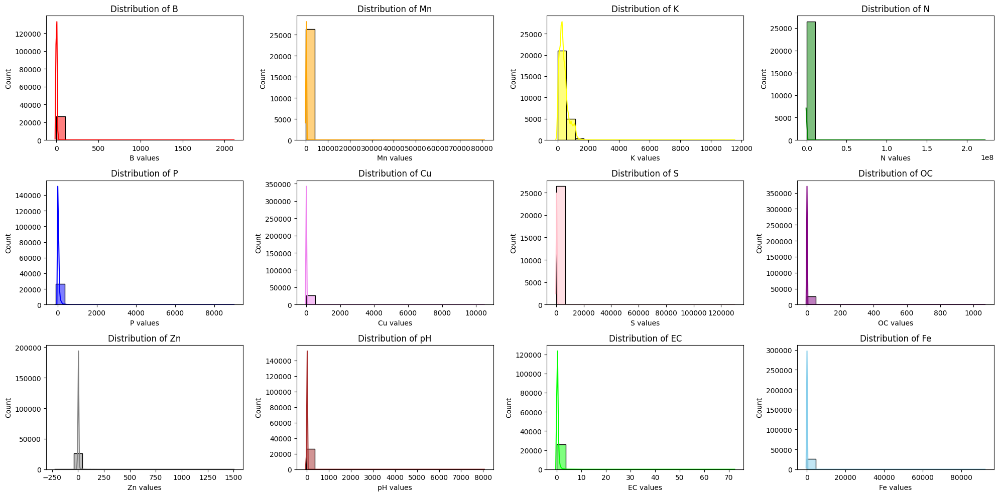

/tmp/ipykernel_19888/1435975282.py:30: FutureWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  df = df.groupby("district", group_keys=False).apply(apply_z_filter)


After z-score
B min and max values :  Min = 0.0, Max = 18.09
Mn min and max values :  Min = 0.0, Max = 109.8
K min and max values :  Min = 0.0, Max = 1990.0
N min and max values :  Min = 0.0, Max = 1141.5
P min and max values :  Min = 0.0, Max = 444.0
Cu min and max values :  Min = 0.0, Max = 21.9
S min and max values :  Min = 0.0, Max = 726.0
OC min and max values :  Min = 0.0, Max = 1.0
Zn min and max values :  Min = 0.0, Max = 8.42
pH min and max values :  Min = 2.18, Max = 9.67
EC min and max values :  Min = 0.0, Max = 2.3
Fe min and max values :  Min = 0.0, Max = 181.4


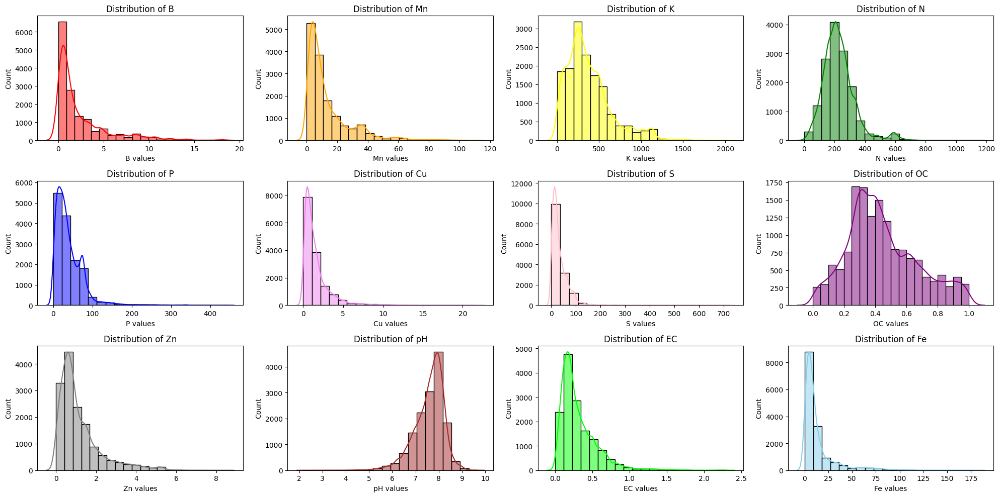

Total districts : 26
ANDHRA PRADESH_2023.csv:: No. of samples reduced from 26429 to 14784
Before z-score
B min and max values :  Min = 0.0, Max = 10.6
Mn min and max values :  Min = 0.0, Max = 65.2
K min and max values :  Min = 0.65, Max = 6641.0
N min and max values :  Min = 0.0, Max = 3131.6
P min and max values :  Min = 0.0, Max = 1053.0
Cu min and max values :  Min = 0.0, Max = 57.14
S min and max values :  Min = 0.0, Max = 179.6
OC min and max values :  Min = 0.06, Max = 4641.5
Zn min and max values :  Min = 0.0, Max = 55.78
pH min and max values :  Min = 0.06, Max = 7031.0
EC min and max values :  Min = -1.0, Max = 1.8
Fe min and max values :  Min = 0.0, Max = 516.2


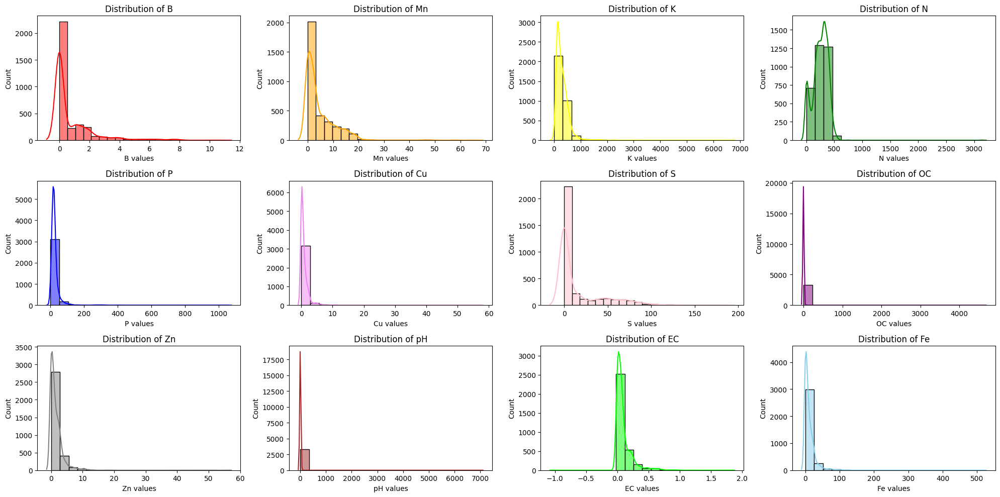

/home/aakash01/Documents/shc/venv/lib/python3.10/site-packages/numpy/_core/fromnumeric.py:3860: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/aakash01/Documents/shc/venv/lib/python3.10/site-packages/numpy/_core/_methods.py:145: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/tmp/ipykernel_19888/1435975282.py:30: FutureWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  df = df.groupby("district", group_keys=False).apply(apply_z_filter)


After z-score
B min and max values :  Min = 0.0, Max = 5.0
Mn min and max values :  Min = 0.0, Max = 21.6
K min and max values :  Min = 8.96, Max = 873.6
N min and max values :  Min = 0.0, Max = 564.5
P min and max values :  Min = 0.672, Max = 113.68
Cu min and max values :  Min = 0.0, Max = 4.69
S min and max values :  Min = 0.0, Max = 124.4
OC min and max values :  Min = 0.06, Max = 1.0
Zn min and max values :  Min = 0.0, Max = 5.292
pH min and max values :  Min = 5.1, Max = 8.1
EC min and max values :  Min = 0.0, Max = 0.48
Fe min and max values :  Min = 0.0, Max = 81.44


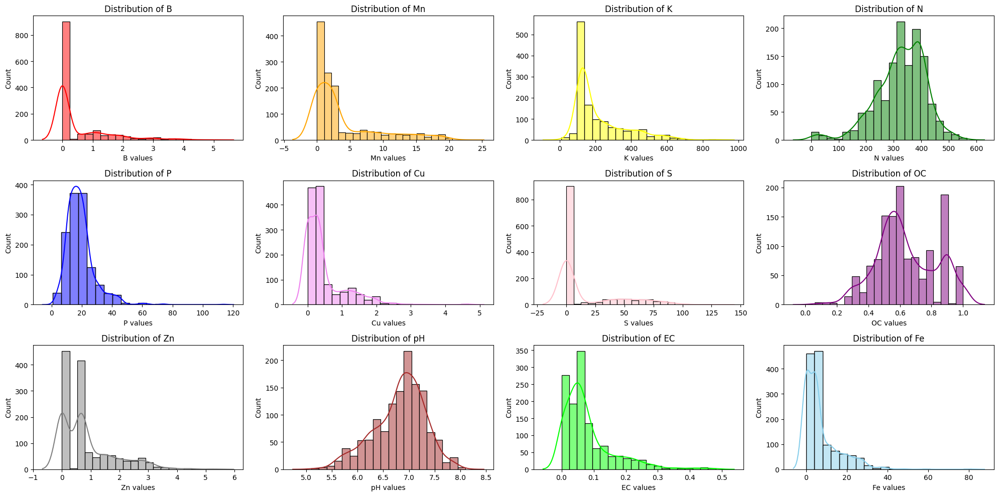

Total districts : 8
HIMACHAL PRADESH_2023.csv:: No. of samples reduced from 3333 to 1298
Before z-score
B min and max values :  Min = 0.0, Max = 0.0
Mn min and max values :  Min = 0.0, Max = 18.39
K min and max values :  Min = 0.0, Max = 302.72
N min and max values :  Min = 0.0, Max = 383.0
P min and max values :  Min = 0.0, Max = 50.0
Cu min and max values :  Min = 0.0, Max = 11.32
S min and max values :  Min = 0.0, Max = 157.4
OC min and max values :  Min = 0.31, Max = 0.855
Zn min and max values :  Min = 0.0, Max = 5.74
pH min and max values :  Min = 7.5, Max = 8.9
EC min and max values :  Min = 0.105, Max = 4.3
Fe min and max values :  Min = 0.0, Max = 232.1


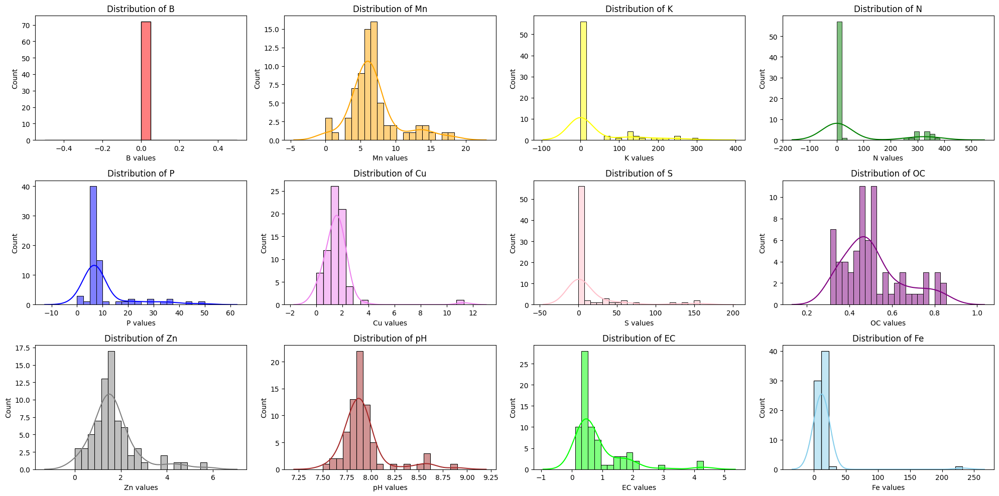

/tmp/ipykernel_19888/1435975282.py:30: FutureWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  df = df.groupby("district", group_keys=False).apply(apply_z_filter)


After z-score
B min and max values :  Min = 0.0, Max = 0.0
Mn min and max values :  Min = 0.0, Max = 18.39
K min and max values :  Min = 0.0, Max = 302.72
N min and max values :  Min = 0.0, Max = 383.0
P min and max values :  Min = 0.0, Max = 50.0
Cu min and max values :  Min = 0.0, Max = 3.55
S min and max values :  Min = 0.0, Max = 157.4
OC min and max values :  Min = 0.31, Max = 0.855
Zn min and max values :  Min = 0.0, Max = 5.74
pH min and max values :  Min = 7.5, Max = 8.9
EC min and max values :  Min = 0.105, Max = 2.15
Fe min and max values :  Min = 0.0, Max = 24.56


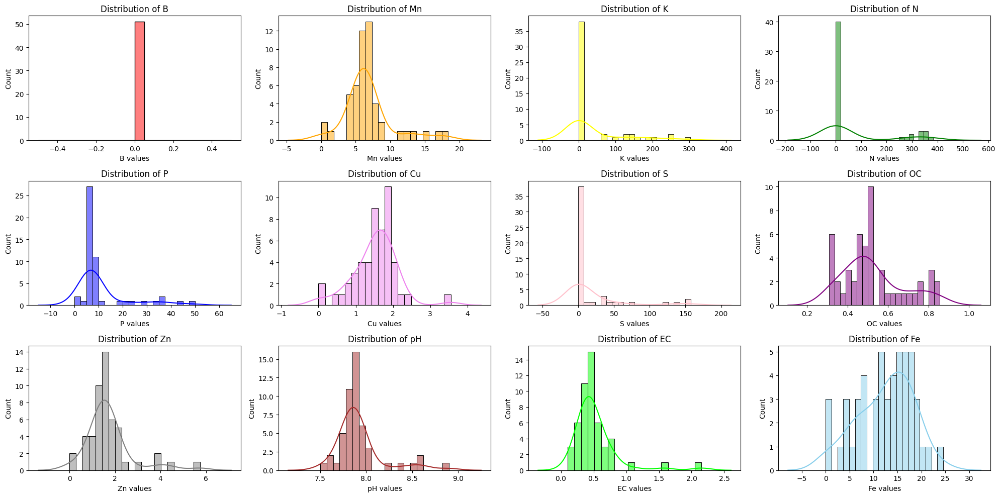

Total districts : 4
PUNJAB_2023.csv:: No. of samples reduced from 72 to 51
Before z-score
B min and max values :  Min = 0.0, Max = 29309.0
Mn min and max values :  Min = 0.0, Max = 30145.0
K min and max values :  Min = 0.0, Max = 184028.0
N min and max values :  Min = 0.0, Max = 305053.0
P min and max values :  Min = 0.0, Max = 130041.0
Cu min and max values :  Min = 0.0, Max = 60818.0
S min and max values :  Min = 0.0, Max = 110403.0
OC min and max values :  Min = 0.0, Max = 7852.0
Zn min and max values :  Min = 0.0, Max = 50306.0
pH min and max values :  Min = 0.0, Max = 2.2402012231124887e+20
EC min and max values :  Min = 0.0, Max = 2307.0
Fe min and max values :  Min = 0.0, Max = 80142.0


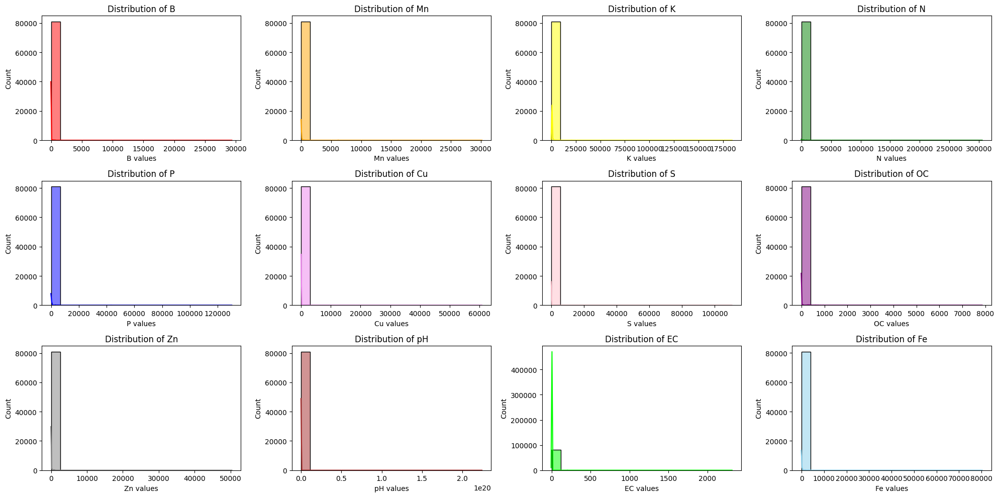

/tmp/ipykernel_19888/1435975282.py:30: FutureWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  df = df.groupby("district", group_keys=False).apply(apply_z_filter)


After z-score
B min and max values :  Min = 0.0, Max = 4.298
Mn min and max values :  Min = 0.0, Max = 99.1
K min and max values :  Min = 0.0, Max = 864.49
N min and max values :  Min = 0.0, Max = 644.0
P min and max values :  Min = 0.0, Max = 218.08
Cu min and max values :  Min = 0.0, Max = 24.24
S min and max values :  Min = 0.0, Max = 137.0
OC min and max values :  Min = 0.0, Max = 1.0
Zn min and max values :  Min = 0.0, Max = 20.8
pH min and max values :  Min = 2.14, Max = 9.98
EC min and max values :  Min = 0.0, Max = 1.326
Fe min and max values :  Min = 0.0, Max = 188.82


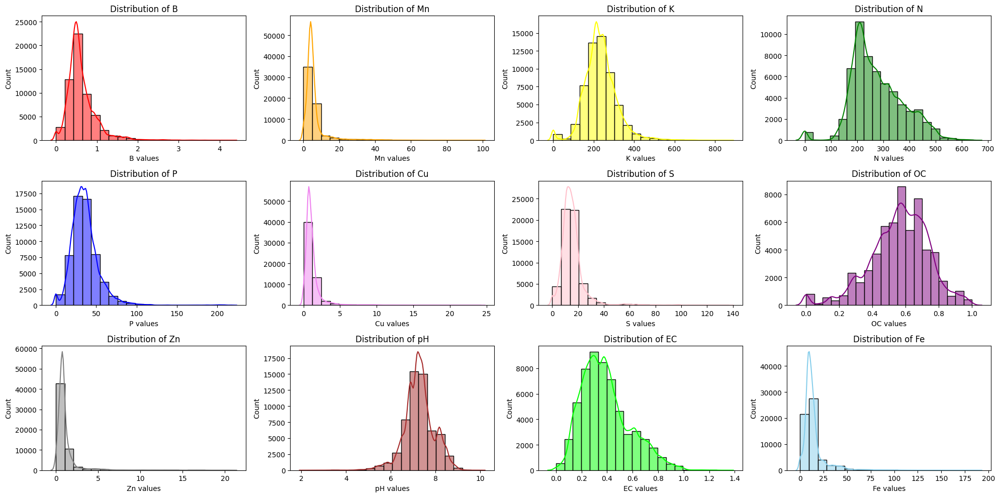

Total districts : 38
BIHAR_2023.csv:: No. of samples reduced from 80943 to 57792
Before z-score
B min and max values :  Min = -4.0, Max = 364.0
Mn min and max values :  Min = 0.0, Max = 73734.0
K min and max values :  Min = 1.326, Max = 41362.27
N min and max values :  Min = -1.0, Max = 10.0
P min and max values :  Min = 0.0, Max = 5625.0
Cu min and max values :  Min = 0.0, Max = 1984.0
S min and max values :  Min = 0.0, Max = 1341.0
OC min and max values :  Min = 0.0, Max = 165.0
Zn min and max values :  Min = 0.0, Max = 65.296
pH min and max values :  Min = 1.13, Max = 82.0
EC min and max values :  Min = 0.0, Max = 28.0
Fe min and max values :  Min = 0.174, Max = 4240.0


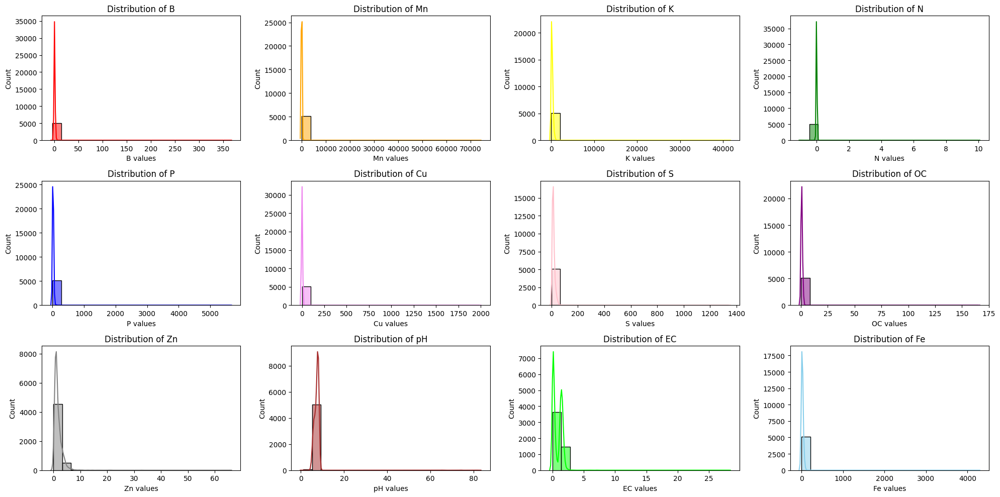

/tmp/ipykernel_19888/1435975282.py:30: FutureWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  df = df.groupby("district", group_keys=False).apply(apply_z_filter)


After z-score
B min and max values :  Min = 0.01, Max = 3.26
Mn min and max values :  Min = 0.0, Max = 33.4
K min and max values :  Min = 1.326, Max = 953.12
N min and max values :  Min = 0.0, Max = 0.0
P min and max values :  Min = 0.45, Max = 145.98
Cu min and max values :  Min = 0.002, Max = 3.678
S min and max values :  Min = 0.35, Max = 40.58
OC min and max values :  Min = 0.03, Max = 1.0
Zn min and max values :  Min = 0.0, Max = 7.36
pH min and max values :  Min = 5.0, Max = 8.63
EC min and max values :  Min = 0.0, Max = 2.24
Fe min and max values :  Min = 0.174, Max = 76.12


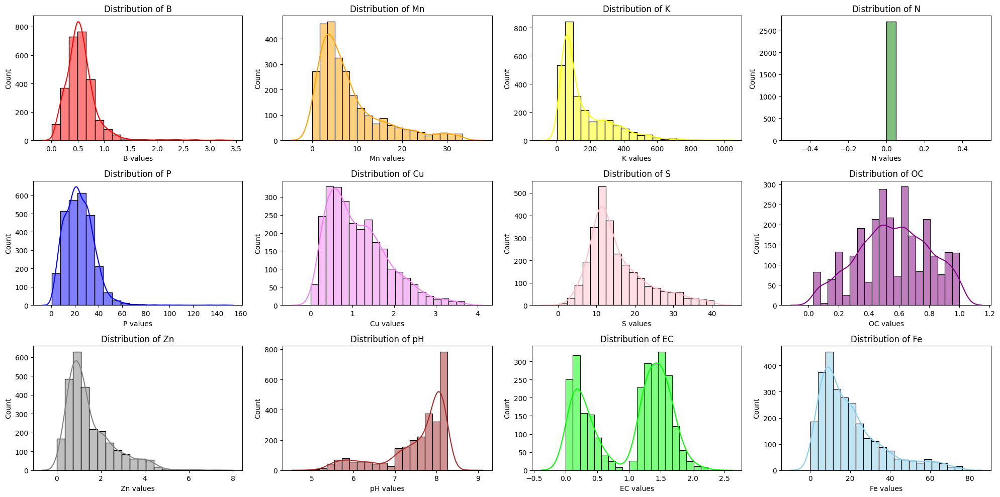

Total districts : 7
UTTARAKHAND_2023.csv:: No. of samples reduced from 5100 to 2699
GOA_2023.csv does not contain any records
LADAKH_2023.csv does not contain any records
Before z-score
B min and max values :  Min = 0.0, Max = 96.0
Mn min and max values :  Min = 0.0, Max = 1949.0
K min and max values :  Min = 2.0, Max = 8572.0
N min and max values :  Min = 7.0, Max = 4643.0
P min and max values :  Min = 1.0, Max = 2822.0
Cu min and max values :  Min = 0.0, Max = 474.0
S min and max values :  Min = 0.12, Max = 4975.0
OC min and max values :  Min = 0.0, Max = 923.0
Zn min and max values :  Min = 0.01, Max = 532.0
pH min and max values :  Min = 0.1, Max = 833.0
EC min and max values :  Min = 0.0, Max = 65.1
Fe min and max values :  Min = 0.0, Max = 3006.0


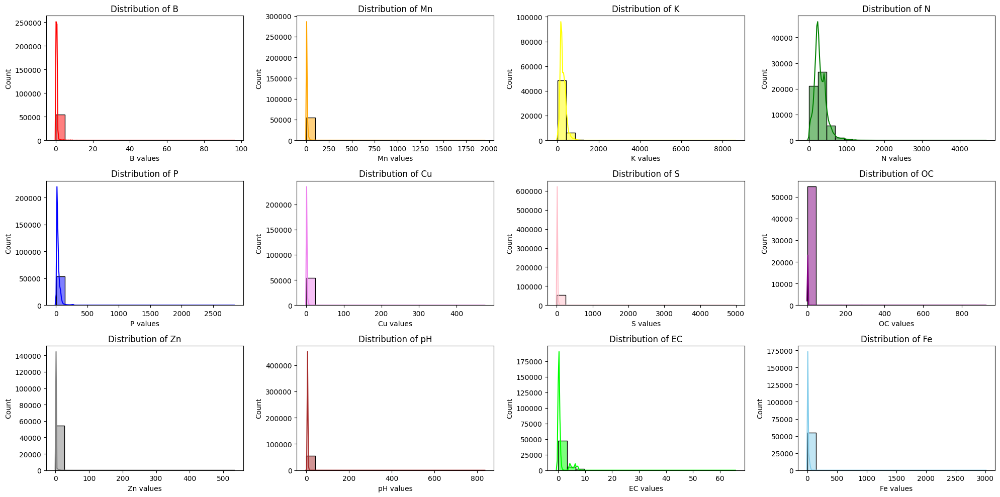

/tmp/ipykernel_19888/1435975282.py:30: FutureWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  df = df.groupby("district", group_keys=False).apply(apply_z_filter)


After z-score
B min and max values :  Min = 0.0, Max = 6.96
Mn min and max values :  Min = 0.0, Max = 51.9
K min and max values :  Min = 2.0, Max = 891.0
N min and max values :  Min = 7.0, Max = 940.0
P min and max values :  Min = 1.0, Max = 290.0
Cu min and max values :  Min = 0.0, Max = 4.86
S min and max values :  Min = 0.12, Max = 98.0
OC min and max values :  Min = 0.04, Max = 1.0
Zn min and max values :  Min = 0.01, Max = 2.54
pH min and max values :  Min = 1.01, Max = 13.4
EC min and max values :  Min = 0.01, Max = 10.0
Fe min and max values :  Min = 0.0, Max = 56.3


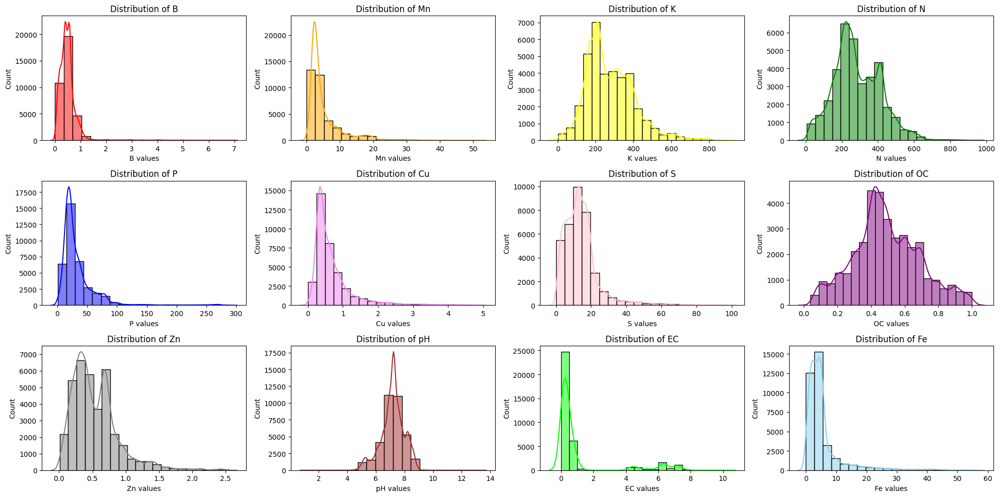

Total districts : 31
KARNATAKA_2023.csv:: No. of samples reduced from 54684 to 36265
Before z-score
B min and max values :  Min = 0.001, Max = 34.774
Mn min and max values :  Min = 0.01, Max = 36.03
K min and max values :  Min = 10.5, Max = 1070.9
N min and max values :  Min = 2.7, Max = 569.0
P min and max values :  Min = 0.0, Max = 414.9
Cu min and max values :  Min = 0.0, Max = 48.75
S min and max values :  Min = 0.0, Max = 273.55
OC min and max values :  Min = 0.0484, Max = 489.1
Zn min and max values :  Min = 0.0, Max = 43.9
pH min and max values :  Min = 0.001, Max = 8.78
EC min and max values :  Min = 0.009, Max = 6.167
Fe min and max values :  Min = 0.0, Max = 118.31


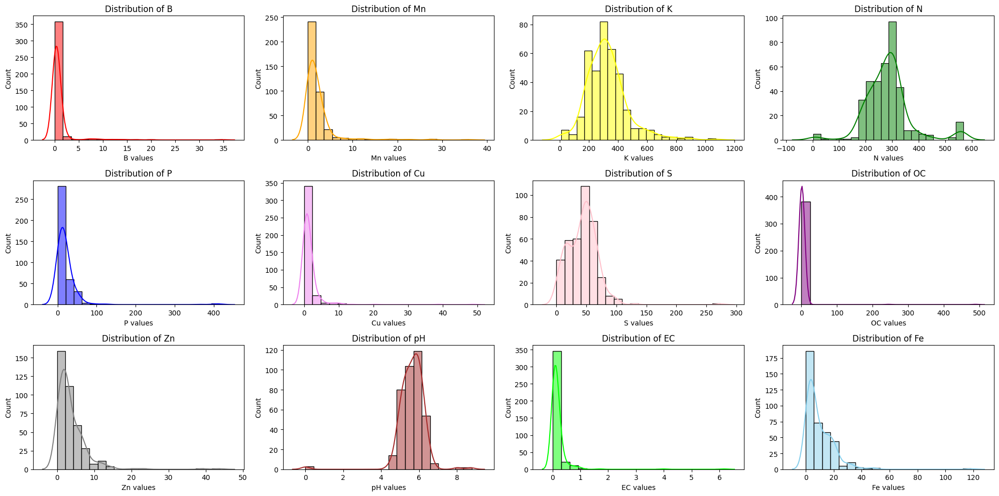

/tmp/ipykernel_19888/1435975282.py:30: FutureWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  df = df.groupby("district", group_keys=False).apply(apply_z_filter)


After z-score
B min and max values :  Min = 0.02, Max = 12.1
Mn min and max values :  Min = 0.01, Max = 23.24
K min and max values :  Min = 10.5, Max = 748.38
N min and max values :  Min = 150.5, Max = 560.0
P min and max values :  Min = 0.0, Max = 125.3
Cu min and max values :  Min = 0.0, Max = 10.19
S min and max values :  Min = 0.0, Max = 94.42
OC min and max values :  Min = 0.3, Max = 1.0
Zn min and max values :  Min = 0.0, Max = 12.8
pH min and max values :  Min = 4.5, Max = 6.6
EC min and max values :  Min = 0.009, Max = 0.7
Fe min and max values :  Min = 0.02, Max = 30.76


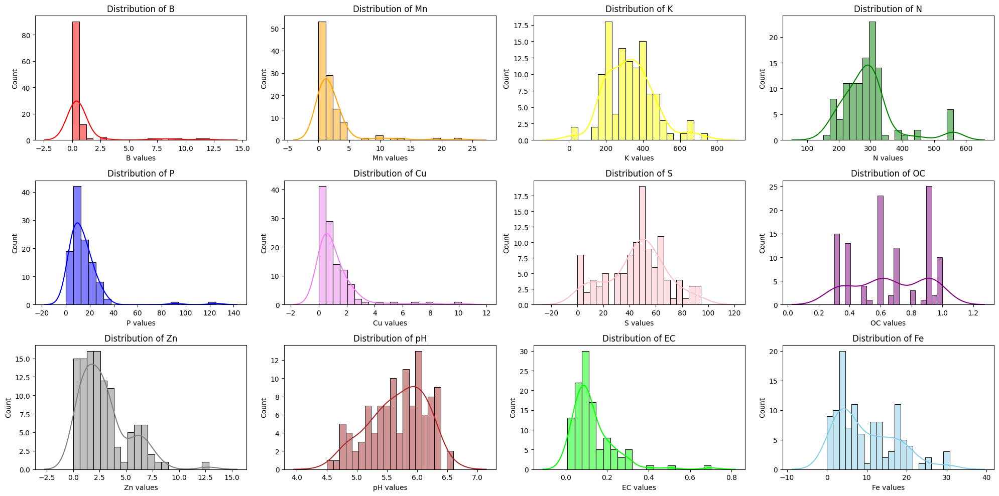

Total districts : 3
SIKKIM_2023.csv:: No. of samples reduced from 384 to 111
MANIPUR_2023.csv does not contain any records
KERALA_2023.csv does not contain any records
DADRA & NAGAR HAVELI AND DAMAN & DIU_2023.csv does not contain any records
TELANGANA_2023.csv does not contain any records
Before z-score
B min and max values :  Min = 0.0, Max = 280.0
Mn min and max values :  Min = 0.004, Max = 27.04
K min and max values :  Min = 14.0, Max = 591.0
N min and max values :  Min = 0.0, Max = 340.0
P min and max values :  Min = 8.0, Max = 292.0
Cu min and max values :  Min = 0.016, Max = 58.0
S min and max values :  Min = 0.0, Max = 43.0
OC min and max values :  Min = 0.036, Max = 1.32
Zn min and max values :  Min = 0.016, Max = 638.0
pH min and max values :  Min = 0.583, Max = 9.5
EC min and max values :  Min = 0.013, Max = 36.0
Fe min and max values :  Min = 0.004, Max = 2948.0


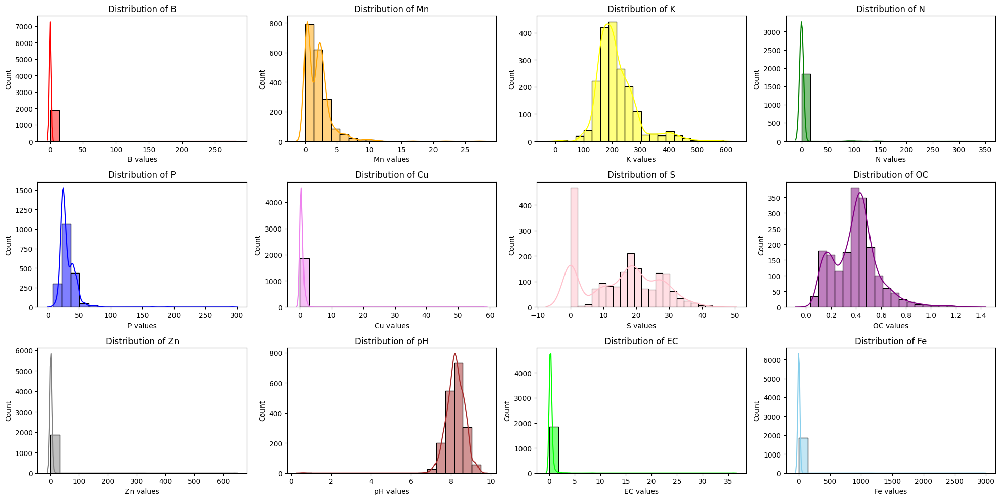

/tmp/ipykernel_19888/1435975282.py:30: FutureWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  df = df.groupby("district", group_keys=False).apply(apply_z_filter)


After z-score
B min and max values :  Min = 0.0, Max = 0.0
Mn min and max values :  Min = 0.01, Max = 7.8
K min and max values :  Min = 90.0, Max = 591.0
N min and max values :  Min = 0.0, Max = 0.0
P min and max values :  Min = 8.0, Max = 84.0
Cu min and max values :  Min = 0.016, Max = 2.61
S min and max values :  Min = 0.0, Max = 40.0
OC min and max values :  Min = 0.036, Max = 1.0
Zn min and max values :  Min = 0.016, Max = 4.088
pH min and max values :  Min = 7.02, Max = 9.4
EC min and max values :  Min = 0.013, Max = 3.8
Fe min and max values :  Min = 0.014, Max = 10.28


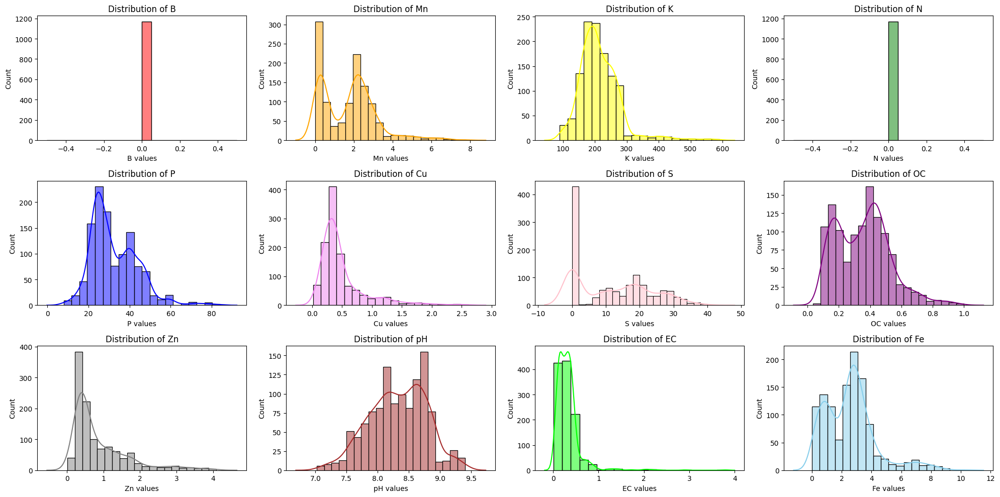

Total districts : 10
RAJASTHAN_2023.csv:: No. of samples reduced from 1869 to 1168
Before z-score
B min and max values :  Min = 0.0, Max = 16.5
Mn min and max values :  Min = 0.0, Max = 4070.0
K min and max values :  Min = 0.0, Max = 35081.0
N min and max values :  Min = 0.0, Max = 819.0
P min and max values :  Min = 0.0, Max = 403.0
Cu min and max values :  Min = -1.0, Max = 11.26
S min and max values :  Min = 0.0, Max = 1376.0
OC min and max values :  Min = 0.0, Max = 63.0
Zn min and max values :  Min = -1.0, Max = 264.0
pH min and max values :  Min = -15.64, Max = 8.94
EC min and max values :  Min = 0.0, Max = 51.0
Fe min and max values :  Min = 0.0, Max = 1371.0


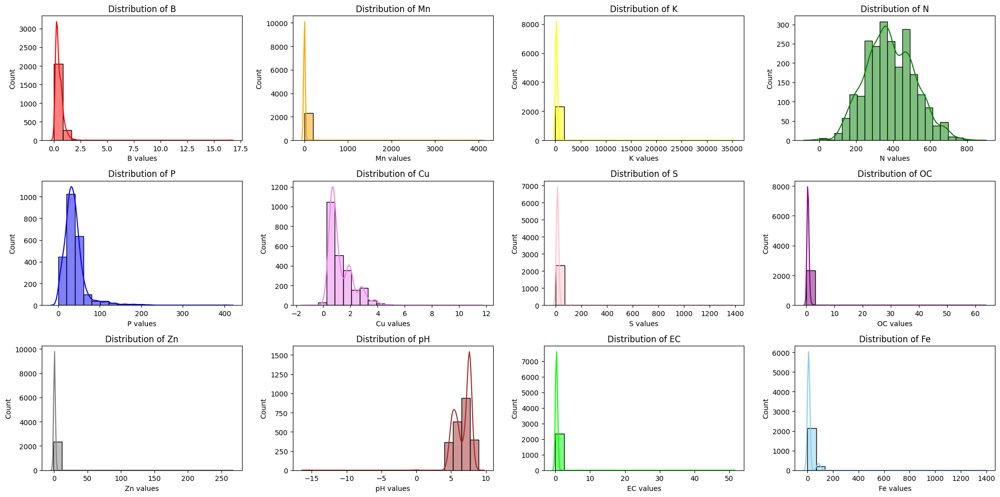

/tmp/ipykernel_19888/1435975282.py:30: FutureWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  df = df.groupby("district", group_keys=False).apply(apply_z_filter)


After z-score
B min and max values :  Min = 0.0, Max = 1.95
Mn min and max values :  Min = 0.48, Max = 11.67
K min and max values :  Min = 28.7, Max = 676.4
N min and max values :  Min = 0.57, Max = 766.0
P min and max values :  Min = 1.42, Max = 122.0
Cu min and max values :  Min = 0.0, Max = 4.82
S min and max values :  Min = 0.97, Max = 29.42
OC min and max values :  Min = 0.12, Max = 1.0
Zn min and max values :  Min = 0.1, Max = 2.96
pH min and max values :  Min = 4.05, Max = 8.94
EC min and max values :  Min = 0.02, Max = 0.99
Fe min and max values :  Min = 1.2, Max = 123.7


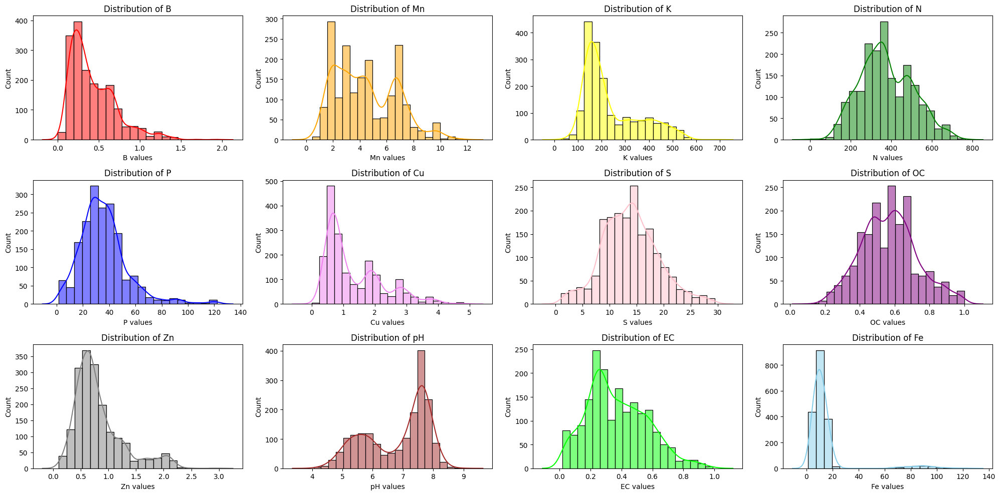

Total districts : 8
WEST BENGAL_2023.csv:: No. of samples reduced from 2335 to 1840
2023 completed
Total records before 430101, Total records after 277761


In [20]:
from tqdm.auto import tqdm

DATA_DIR = "./shc_data"
YEARS_DIR = "YEAR_WISE_DATA"
OUTPUT_DIR = "NORMALISED_DATA"

years = os.listdir(os.path.join(DATA_DIR, YEARS_DIR))

for year in years:
    YEAR_DIR = os.path.join(DATA_DIR, YEARS_DIR, year)
    state_files = os.listdir(YEAR_DIR)
    SAVE_DIR = os.path.join(DATA_DIR, OUTPUT_DIR, year)
    os.makedirs(SAVE_DIR, exist_ok=True)

    num_records_old = 0
    num_records_new = 0

    for file in state_files:
        file_path = os.path.join(YEAR_DIR, file)
        try:
            df = pd.read_csv(file_path)
        except:
            print(f"{file} does not contain any records")
            continue

        print("Before z-score")
        plot_props(df)
        
        original_size = len(df)
        df = df.groupby("district", group_keys=False).apply(apply_z_filter)

        print("After z-score")
        plot_props(df)
        
        new_size = len(df)
        unique_districts = df["district"].unique()
        print(f"Total districts : {len(unique_districts)}")
        print(f"{file}:: No. of samples reduced from {original_size} to {new_size}")
        num_records_old += original_size
        num_records_new += new_size
        df.to_csv(os.path.join(SAVE_DIR, file), index=False)
    
    print(f"{year} completed")
    print(f"Total records before {num_records_old}, Total records after {num_records_new}")